# <font color="#30143">Parcial Práctico Asignatura Series de Tiempo</font>
<br><br>

# <font color="#30143">Ejercicio 1: Análisis Exploratorio de Datos</font>
<br><br>

---

## <font color="#30143">Introducción</font>

En este informe, trabajaremos con el conjunto de datos *[Bitcoin data](https://raw.githubusercontent.com/lihkir/Data/refs/heads/main/Bitcoin%20Historical%20Data.csv)*, que consta de 4,999 registros. Este conjunto de datos abarca el período del 18 de julio de 2010 al 24 de marzo de 2024, lo que representa un total de 13 años de información histórica sobre Bitcoin.

### <font color="#30143">Importar Librerías</font>

In [127]:
# Load libraries
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go 

# Load sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox
from statsmodels.stats.stattools import jarque_bera

from statsmodels.tsa.stattools import acf
from statsmodels.tsa.stattools import pacf

from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

from sklearn.metrics import r2_score

import statsmodels.api as sm
from sklearn.metrics import mean_absolute_error
import itertools
from statsmodels.tools.sm_exceptions import ConvergenceWarning
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.holtwinters import SimpleExpSmoothing
from statsmodels.tsa.seasonal import seasonal_decompose
import statsmodels.tsa.api as smt
import matplotlib.gridspec as gridspec


from statsmodels.tsa.arima.model import ARIMA
import warnings
import pickle
import os 

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
import scipy.stats as stats
from statsmodels.tsa.stattools import acf

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import statsmodels.api as sm
from statsmodels.graphics.gofplots import qqplot

#from arch import arch_model


import warnings
warnings.filterwarnings("ignore")

### <font color="#30143"> Cargar el dataset</font>

A continuación usamos la función `read_cvs()` de la libreria `pandas`para cargar los datos a nuestro entorno de trabajo. 

In [130]:
df = pd.read_csv("https://raw.githubusercontent.com/lihkir/Data/refs/heads/main/Bitcoin%20Historical%20Data.csv", sep=",")

### <font color="#30143"> Dimensiones y visualización del conjunto de datos</font>

A continuación verificados el tamaño de nuestro dataset y los nombres de cada una de las columnas y tipo de dato que lo componen: 

In [133]:
print(f'Cantidad de filas y columnnas{df.shape}')
print(f'Nombres de Columnas{df.columns}')

Cantidad de filas y columnnas(4999, 7)
Nombres de ColumnasIndex(['Date', 'Price', 'Open', 'High', 'Low', 'Vol.', 'Change %'], dtype='object')


In [134]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4999 entries, 0 to 4998
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Date      4999 non-null   object
 1   Price     4999 non-null   object
 2   Open      4999 non-null   object
 3   High      4999 non-null   object
 4   Low       4999 non-null   object
 5   Vol.      4993 non-null   object
 6   Change %  4999 non-null   object
dtypes: object(7)
memory usage: 273.5+ KB


Procedemos a renombrar las variables que contienen caracteres especiales y/o espacios para evitar inconvenientes durante el procesamiento de los datos.

In [136]:
df_1 = df.rename(columns={    
    'Vol.': 'Vol',
    'Change %': 'Change' 
})

In [137]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4999 entries, 0 to 4998
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Date    4999 non-null   object
 1   Price   4999 non-null   object
 2   Open    4999 non-null   object
 3   High    4999 non-null   object
 4   Low     4999 non-null   object
 5   Vol     4993 non-null   object
 6   Change  4999 non-null   object
dtypes: object(7)
memory usage: 273.5+ KB


Ademas vemos una representación de los datos a tráves de la función `head()`

In [139]:
df_1.head(5)

,Date,Price,Open,High,Low,Vol,Change
0,03/24/2024,"67,211.9","64,036.5","67,587.8","63,812.9",65.59K,4.96%
1,03/23/2024,"64,037.8","63,785.6","65,972.4","63,074.9",35.11K,0.40%
2,03/22/2024,"63,785.5","65,501.5","66,633.3","62,328.3",72.43K,-2.62%
3,03/21/2024,"65,503.8","67,860.0","68,161.7","64,616.1",75.26K,-3.46%
4,03/20/2024,"67,854.0","62,046.8","68,029.5","60,850.9",133.53K,9.35%


Se ha identificado que hay `6` datos faltantes en la columna `Vol.`, y la columna `Date` no está en formato `datetime`, además las columnas númericas aparecen como Dtype`objet`.

In [141]:
df_1['Date'] = pd.to_datetime(df_1['Date'])
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4999 entries, 0 to 4998
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    4999 non-null   datetime64[ns]
 1   Price   4999 non-null   object        
 2   Open    4999 non-null   object        
 3   High    4999 non-null   object        
 4   Low     4999 non-null   object        
 5   Vol     4993 non-null   object        
 6   Change  4999 non-null   object        
dtypes: datetime64[ns](1), object(6)
memory usage: 273.5+ KB


En este momento, procederemos a convertir el tipo de dato de la columna fecha a datetime y las columnas tipo objet a float64.

In [143]:
df_1[['Price', 'Open', 'High', 'Low']] = df_1[['Price', 'Open', 'High', 'Low']].replace(',', '', regex=True).astype(float) #Eliminar coma (,) de columnas Pice, Open, High, Low y convertir a float

La columna `Vol` incluye letras que representan múltiplos; por lo tanto, a continuación, revisaremos cuántas de estas letras existen. 

In [145]:
final_letters = df_1['Vol'].str.extract(r'([A-Za-z])$', expand=False) # Extraer las últimas letras de cada registro en la columna 'Vol'
print(final_letters.dropna().unique())

['K' 'M' 'B']


De manera similar, la columna `Change` contiene un carácter especial (`%`). Procederemos a reemplazar cada múltiplo, eliminar el carácter `%` y convertir la columna `Vol` a tipo `int` y la columna `Change` a tipo `int` con la función `con_vol_a_numerico()`.

In [147]:
def con_vol_a_numerico(Vol):
    if isinstance(Vol, str): 
        Vol = Vol.replace(',', '') 
        if 'K' in Vol:
            return float(Vol.replace('K', '')) * 1_000  
        elif 'M' in Vol:
            return float(Vol.replace('M', '')) * 1_000_000  
        elif 'B' in Vol:
            return float(Vol.replace('B', '')) * 1_000_000_000  
        else:
            return float(Vol) 
    else:
        return Vol

In [148]:
df_1['Vol'] = df_1['Vol'].apply(con_vol_a_numerico) #Indexación de parámetros de función
df_1['Change'] = df_1['Change'].str.replace('%', '').astype(float) / 100 # Cambio columna Change

In [149]:
df_1.head(5)

,Date,Price,Open,High,Low,Vol,Change
0,2024-03-24,67211.9,64036.5,67587.8,63812.9,65590.0,0.0496
1,2024-03-23,64037.8,63785.6,65972.4,63074.9,35110.0,0.0040
2,2024-03-22,63785.5,65501.5,66633.3,62328.3,72430.0,-0.0262
3,2024-03-21,65503.8,67860.0,68161.7,64616.1,75260.0,-0.0346
4,2024-03-20,67854.0,62046.8,68029.5,60850.9,133530.0,0.0935


In [150]:
print(f'Cantidad de filas y columnnas{df_1.shape}')

Cantidad de filas y columnnas(4999, 7)


In [151]:
# Obtener la fecha mínima y máxima
fecha_minima = df_1['Date'].min()
fecha_maxima = df_1['Date'].max()

print(f"Fecha mínima: {fecha_minima}")
print(f"Fecha máxima: {fecha_maxima}")

Fecha mínima: 2010-07-18 00:00:00
Fecha máxima: 2024-03-24 00:00:00


A continuación se define nuestra variable objetivo (Target) y los atributos (características):

* **Price**: el precio de Bitcoin en un momento específico, (Target).

* **Date**: corresponde a la fecha de cada uno de los registros.

* **Open**: precio de Apertura del Bitcoin en la bolsa de valores.

* **High**: precio más alto alcanzado por Bitcoin durante el período en la bolsa de valores.

* **Low**: precio más bajo alcanzado por Bitcoin durante el período en la bolsa de valores.

* **Vol**: volumen de Bitcoin transaccionado durante un período específico.

* **Change**: porcentaje de cambio en el precio de Bitcoin desde la apertura hasta el cierre durante un período específico. 

<div class="alert alert-block" style="background-color: #e1d9e3; color: #30143; padding: 10px; border-radius: 10px;">
    <i class="fa fa-info-circle" aria-hidden="true"></i>
    <strong>Importante:</strong>
    Dado que se requiere la columna  <em>Close</em> (precio de cierre) para la <em>gráfica de candlestick</em>  procedemos a calcularla a partir de la columna <em>Open</em>  y <em>Change</em>.
</div>

In [154]:
df_1['Close'] = df_1['Open'] * (1 + df_1['Change'])

### <font color="#30143">Estimación del Retorno Acumulado diario y Volatilidad del Bitcoin </font>

---

Se requiere calcular el retorno acumulado y la volatilidad para esto se emplean las siguientes ecuaciones: 

* Retorno acumulado diario $\{A_t\}_{t=1}^T$ donde: 

$$A_t = \sum_{j=1}^t R_j \text{, con } R_t = \frac{P_t-P_{t-1}}{P_{t-1}} \text{,}$$

donde $P_t\text{, }t=1,2,3 \ldots , \text{T}$ es la columna `Price` en el dataset de Bitcoin y *T* es el tiempo final.

* La Volatilidad $\{\sigma\}_{t=1}^T$ es la desviación estándar de los retornos diarios. 

$$\sigma = \text{std}(R_1, R_2, \ldots , R_{\omega}) \text{ donde } \omega = 7, 14, 21, 28, $$

siendo $\omega$ el número de retornos diarios considerados para calcular la desviación estándar 

$$\text{std}(R_1, R_2, \ldots , R_{\omega}) = {\sqrt{\frac{1}{\omega -1} \sum_{t=1}^\omega}(R_t-\mu)}, \space \mu= \frac{1}{\omega}\sum_{t=1}^\omega R_t,$$

obtenida por ventanas móviles de longitud $\omega$, donde $\omega$ esta dado en días, y esta desviación es calculada sobre la serie de retornos diarios. 


A continuación se define función para calculo de retorno acumulado y volatilidad. 

In [159]:
def calcular_retorno_acumulado(df):
    # Calcular los retornos diarios R_t
    df['R_t'] = (df['Price'] - df['Price'].shift(1)) / df['Price'].shift(1)

    # Asignar 0 al primer registro de R_t
    df['R_t'].fillna(0, inplace=True)

    # Calcular el retorno acumulado A_t
    df['A_t'] = df['R_t'].cumsum()

    return df

In [160]:
def calcular_volatilidad(df, omegas):
    if 'R_t' not in df.columns:
        df['R_t'] = (df['Price'] - df['Price'].shift(1)) / df['Price'].shift(1)
        df['R_t'].fillna(0, inplace=True)  # Asignar 0 al primer registro

    # Calcular la volatilidad para cada omega en la lista
    for omega in omegas:
        col_name = f'Volatilidad_{omega}'
        df[col_name] = df['R_t'].rolling(window=omega).std()
        df[col_name].fillna(0, inplace=True)  # Reemplazar NaN por 0

    return df 

A continuación se realiza indexación de parámetros sobre la función `calcular_retorno_acumulado()` y `calcular_volatilidad()`. 

In [162]:
df_1_sorted = df_1.sort_values(by='Date')
df_1_st = df_1_sorted.copy()
df_1_st.set_index('Date', inplace=True)
# Inferir la frecuencia del índice
frecuencia = pd.infer_freq(df_1_st.index)
print("Frecuencia: ", frecuencia)

Frecuencia:  D


In [163]:
st_retorno =calcular_retorno_acumulado(df_1_st)

In [164]:
omegas = [7, 14, 21, 28]  # Lista de diferentes tamaños de ventana
st_retorno_volatilidad = calcular_volatilidad(df_1_st, omegas)

A continuación se imprimen los resultados de los calculos anteriores. 

In [166]:
df_1_st

,Price,Open,High,Low,Vol,Change,Close,R_t,A_t,Volatilidad_7,Volatilidad_14,Volatilidad_21,Volatilidad_28
Date,,,,,,,,,,,,,
2010-07-18,0.1,0.0,0.1,0.1,80.0,0.0000,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2010-07-19,0.1,0.1,0.1,0.1,570.0,0.0000,0.1000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2010-07-20,0.1,0.1,0.1,0.1,260.0,0.0000,0.1000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2010-07-21,0.1,0.1,0.1,0.1,580.0,0.0000,0.1000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2010-07-22,0.1,0.1,0.1,0.1,2160.0,0.0000,0.1000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-20,67854.0,62046.8,68029.5,60850.9,133530.0,0.0935,67848.1758,0.093537,23.719802,0.060681,0.044544,0.044059,0.043374
2024-03-21,65503.8,67860.0,68161.7,64616.1,75260.0,-0.0346,65512.0440,-0.034636,23.685166,0.061287,0.045543,0.044563,0.044045
2024-03-22,63785.5,65501.5,66633.3,62328.3,72430.0,-0.0262,63785.3607,-0.026232,23.658934,0.061256,0.045630,0.044883,0.044397


### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [169]:
pd.set_option('display.precision', 2)
df_numericas = df_1_st.select_dtypes(include=['number'])
df_numericas.describe()


,Price,Open,High,Low,Vol,Change,Close,R_t,A_t,Volatilidad_7,Volatilidad_14,Volatilidad_21,Volatilidad_28
count,4999.00,4999.00,4999.00,4999.00,4.99e+03,5.00e+03,4999.00,5.00e+03,4999.00,4999.00,4999.00,4999.00,4999.00
mean,10812.28,10798.90,11067.45,10511.89,1.24e+07,4.16e-03,10812.36,4.74e-03,16.65,0.04,0.04,0.05,0.05
std,15892.03,15872.79,16270.71,15444.93,1.55e+08,7.09e-02,15892.13,7.65e-02,6.12,0.06,0.06,0.06,0.06
min,0.10,0.00,0.10,0.00,8.00e+01,-5.72e-01,0.00,-5.72e-01,0.00,0.00,0.00,0.00,0.00
25%,226.70,226.45,231.40,221.95,3.18e+04,-1.17e-02,226.64,-1.22e-02,13.59,0.02,0.02,0.02,0.02
50%,1975.10,1962.00,2048.40,1875.30,6.88e+04,0.00e+00,1975.03,0.00e+00,18.31,0.03,0.03,0.03,0.03
75%,15450.15,15372.15,15954.55,14557.20,1.86e+05,1.78e-02,15449.29,1.84e-02,21.34,0.05,0.05,0.05,0.05
max,73066.30,73066.70,73740.90,71338.40,4.47e+09,3.37e+00,73055.50,3.37e+00,23.78,1.40,1.00,0.82,0.71


* **Price** : Elprecio promedio se sitúa en 10,812.28, con una variabilidad considerable, reflejada en una desviación estándar de 15,892.03. Esto sugiere fluctuaciones notables en los precios.En cuanto su distribución, los valores oscilan entre un mínimo de 0.10 y un máximo de 73,066.30, presentando una distribución asimétrica con algunos valores extremos en el extremo superior.

* **Open**: El precio de apertura tiene un promedio de 10,798.90 y una desviación estándar de 15,872.79, indicando variaciones significativas en la apertura de precios.En cuanto su distribución, los precios de apertura van de 0.00 a 73,066.70, sugiriendo una distribución similar a la de los precios en general, donde los valores extremos impactan la media.

* **High**: El promedio del precio máximo diario es de 11,067.45, con una desviación estándar de 16,270.71, lo que indica la posibilidad de alcanzar precios altos en días específicos. En cuanto a su distribución, los precios abarca desde 0.10 hasta 73,740.90, mostrando también la presencia de valores extremos.


* **Comportamiento**: El precio mínimo promedio es de 10,511.89, con una desviación estándar de 15,444.93, lo que sugiere que los precios pueden descender, pero con una variabilidad considerable. En cuanto a su distribución, los precios mínimos oscilan entre 0.00 y 71,338.40, con un sesgo hacia valores más bajos.

* **Volumen (Vol)** El volumen promedio de transacciones es de aproximadamente 12,400,000, con una desviación estándar de 155,000,000, indicando una gran variabilidad en el volumen de transacciones.En cuanto a su distribución, varía de 80 a 4,470,000,000, mostrando una distribución altamente asimétrica y una gran dispersión.

* **Cambio (Change)**: El cambio promedio es de 0.00416, con una desviación estándar de 0.0709, sugiriendo que los cambios en el precio suelen ser pequeños, aunque en algunos días pueden ser significativos. En cuanto a su distribución, se encuentra en el rango de -0.572 a 3.37, indicando la existencia de días con caídas y aumentos marcados.

* **Close**:El precio de cierre promedio es de 10,812.36, con una desviación estándar similar a la de otras variables de precios, lo que indica una considerable variabilidad.En cuanto a su distribución, se mueve entre 0.00 y 73,055.50, mostrando una tendencia a presentar valores extremos similar a otras variables de precios.

* **R_t**: El retorno promedio es de 0.00474, con una desviación estándar de 0.0765, lo que indica cambios moderados en el rendimiento diario. En cuanto a su distribución, los valores oscilan entre 0.00 y 3.37, sugiriendo una variabilidad considerable en los retornos.

* **A_t**: El promedio de los retornos ajustados es de 0.00474, con una desviación estándar de 0.0765, lo que indica que los retornos ajustados son similares en comportamiento a los retornos generales. Su distribución se sitúa en un rango comparable, indicando una tendencia a la consistencia en los retornos.

* **Volatilidad_7**: La volatilidad promedio a 7 días es de 16.65, con una desviación estándar de 6.12, lo que sugiere una variabilidad en los precios a corto plazo. Los valores oscilan entre 0.00 y 23.78, mostrando una leve tendencia a la concentración en torno a la media.

* **Volatilidad_14**: La volatilidad promedio a 14 días es de 0.04, con una desviación estándar de 0.06, sugiriendo estabilidad en la volatilidad a mediano plazo. En su distribución, los valores son relativamente bajos, indicando que las fluctuaciones son menores en comparación con periodos más cortos.

* **Volatilidad_21**: La volatilidad promedio a 21 días es de 0.04, con una desviación estándar de 0.06, lo que indica un comportamiento similar al de la volatilidad a 14 días, manteniendo un patrón de estabilidad. Su distribución se asemeja a la de las volatilidades anteriores.

* **Volatilidad_28**: La volatilidad promedio a 28 días es de 0.05, con una desviación estándar de 0.06, indicando un ligero incremento en comparación con los periodos anteriores, pero aún dentro de un rango manejable. La distribución refleja una consistencia en la volatilidad observada a lo largo del tiempo.

### <font color="#30143"> Datos Faltantes </font>

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [173]:
missing_values = df_1_st.isna().sum()
total_rows = df_1_st.shape[0]

missing_vars = missing_values[missing_values > 0]

missing_info_df = pd.DataFrame({    
    'Datos faltantes': missing_vars,
    'Porcentaje (%)': round((missing_vars / total_rows) * 100,2)})

missing_info_df

,Datos faltantes,Porcentaje (%)
Vol,6,0.12


Se encontraron 6 datos faltantes en relación al volumen de Bitcoin transaccionado en los registros del conjunto de datos analizado. Procedemos a realizar el análisis de su distribución para escoger la mejor técnica de imputación. 

### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`:

In [177]:
# Skew for each attribute
pd.set_option('display.precision', 4)
df_1_st.skew()

Price              1.6359
Open               1.6353
High               1.6380
Low                1.6303
Vol               18.6076
Change            22.6507
Close              1.6359
R_t               18.7696
A_t               -0.9747
Volatilidad_7     12.3402
Volatilidad_14     9.8507
Volatilidad_21     8.4237
Volatilidad_28     7.4752
dtype: float64

Para evaluar si las variables presentan sesgo, se comparará el valor absoluto de sus coeficientes con un umbral, como 1.0. Se considera que los coeficientes más cercanos a cero indican un menor sesgo. Los valores de inclinación reflejan una tendencia positiva (hacia la derecha) o negativa (hacia la izquierda). En el caso de la variable `Change`, se observa un sesgo considerable hacia la derecha, mientras que las demás variables, incluyendo la `Vol` muestran un ligero sesgo también hacia la derecha, por tanto procedemos a imputar los datos faltantes con la `mediana`.

### <font color="#30143"> Imputación datos faltantes</font>

In [180]:
median_vol = df_1_st['Vol'].median()  # Calcular la mediana
df_1_st['Vol'].fillna(median_vol, inplace=True)  # Imputar la mediana

Verificamos que la imputación se haya realizado de forma correcta. 

In [182]:
df_1_st.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4999 entries, 2010-07-18 to 2024-03-24
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Price           4999 non-null   float64
 1   Open            4999 non-null   float64
 2   High            4999 non-null   float64
 3   Low             4999 non-null   float64
 4   Vol             4999 non-null   float64
 5   Change          4999 non-null   float64
 6   Close           4999 non-null   float64
 7   R_t             4999 non-null   float64
 8   A_t             4999 non-null   float64
 9   Volatilidad_7   4999 non-null   float64
 10  Volatilidad_14  4999 non-null   float64
 11  Volatilidad_21  4999 non-null   float64
 12  Volatilidad_28  4999 non-null   float64
dtypes: float64(13)
memory usage: 546.8 KB


Se observa que no existen datos faltantes en la columna `Vol`

### <font color="#30143"> Gráfico de CandleStick</font>

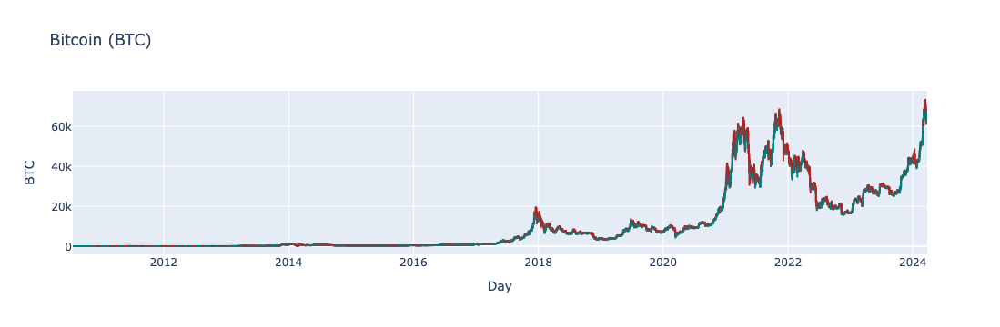

In [185]:
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as py

df_g = df_1_sorted.copy()

fig = go.Figure(data=[go.Candlestick(x = df_g['Date'],
                                     open = df_g['Open'], 
                                     high = df_g['High'],
                                     low = df_g['Low'], 
                                     close = df_g['Close'], 
                                     increasing_line_color='#008080',  # Color de línea de velas alcistas
                                     decreasing_line_color='#B22222',    # Color de línea de velas bajistas
                                     increasing_fillcolor='#B0E0E6',   # Color de relleno de velas alcistas
                                     decreasing_fillcolor='#DB7093'      # Color de relleno de velas bajistas)
                                     )
                        ]
                )      
                     
fig.update_layout(
    title="Bitcoin (BTC)",
    xaxis_title="Day",
    yaxis_title="BTC",
    font=dict(
        family="Verdana, monospace",
        size=12,
    )
)
fig.update_layout(xaxis_rangeslider_visible=False)
fig.show()



El gráfico de velas (candlestick) representa la evolución del precio de la criptomoneda Bitcoin desde el 18 de Julio de 2010 al 24 de marzo de 2024, mostrando datos diarios. En este gráfico cada vela representa un día de trading:

* Si el precio de apertura es mayor que el precio de cierre para ese día, la vela se dibuja de color azul, la cola superior de la vela representa el precio máximo alcanzado durante el día y la cola inferior de la vela representa el precio mínimo alcanzado durante el día.  

* Si el precio de cierre es mayor que el precio de apertura para ese día, la vela se dibuja de color rojo. De igual forma la cola superior de la vela representa el precio máximo alcanzado durante el día y la cola inferior de la vela representa el precio mínimo alcanzado durante el día.

En resumen, el gráfico de candlestick ofrece una representación visual de la variación diaria del precio de Bitcoin durante el periodo mencionado, mostrando tanto los rangos de precio máximo y mínimo como la relación entre el precio de apertura y el precio de cierre de cada día.

### <font color="#30143"> Histograma (Volume) </font>

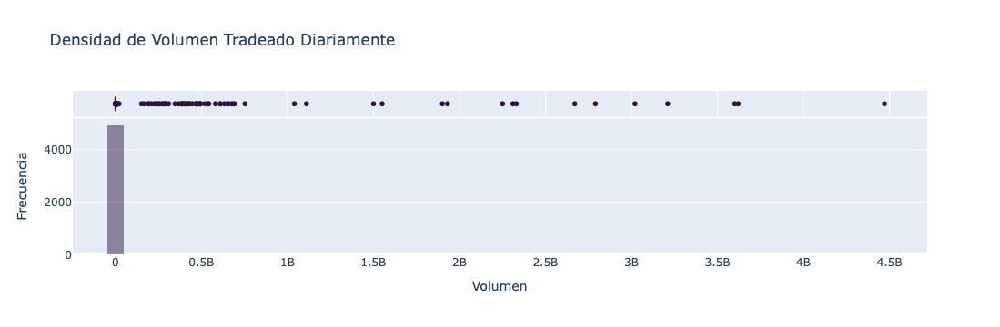

In [188]:
import plotly.express as px
import plotly.graph_objects as go

# Gráfico de densidad interactivo usando Plotly Express
fig_density = px.histogram(df_1_st, x="Vol", marginal="box", nbins=50, title="Densidad de Volumen Tradeado Diariamente",
                           labels={'Vol': 'Volumen'}, color_discrete_sequence=['#30143F'],
    opacity=0.7)


fig_density.update_traces(
    marker=dict(color='#30143F'),  # Ajustar la opacidad de las barras
    selector=dict(type='histogram'),
    opacity=0.7
)

# Ajustar el diseño del gráfico de densidad
fig_density.update_layout(
    xaxis_title="Volumen",
    yaxis_title="Frecuencia",
    showlegend=False
)

fig_density.show()

El gráfico de distribución del volumen de transacciones diarias presenta un sesgo hacia la derecha, con una mayor frecuencia alrededor de cero. Este fenómeno puede explicarse por el hecho de que hasta 2018, el Bitcoin comenzó a ganar una considerable aceptación en el mercado global. Es importante señalar que los datos abarcan desde 2010, lo que influye significativamente en la representación gráfica observada.

---

## <font color="#30143"> Análisis Exploratorio de serie de tiempo de precio del Bitcoin</font>

### <font color="#30143">  Gráficos Subserie Estacional </font>

A continuación consultamos la frecuencia de nuestra serie temporal (Price)  y el resultado es que nuestros datos presentan una frencuencia diaria, sin embargo, la tendencia general no siempre es evidente a corto plazo, debido a que se pueden presentar valores altos  y bajo a lo largo del tiempo. Por esta razón ajustaremos la linea de tendencia. Para esto, importamos la librería `LinearRegresion`de `scikit-learn` y ajustamos nuestro modelo lineal al índice temporal. 

In [194]:
trend_model = LinearRegression(fit_intercept=True)
trend_model.fit(np.arange(df_1_st.shape[0]).reshape((-1,1)), df_1_st['Price'])

LinearRegression()

In [195]:
print('Trend model coefficient={} and intercept={}'.format(trend_model.coef_[0], trend_model.intercept_))

Trend model coefficient=8.372567619953761 and intercept=-10110.763145597117


In [196]:
residuals = np.array(df_1_st['Price']) - trend_model.predict(np.arange(df_1_st.shape[0]).reshape((-1,1)))
df_1_st['Residuals'] = residuals

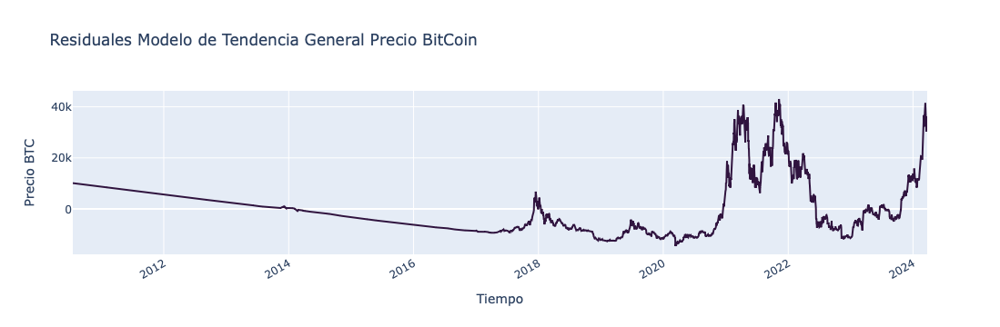

In [197]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=df_1_st.index,
    y=residuals,
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Residuales Modelo de Tendencia General Precio BitCoin',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()


Los residuales del modelo de tendencia general del precio del Bitcoin exhiben un comportamiento que se asemeja al gráfico de velas (candlestick) que ilustra la evolución de esta criptomoneda desde el 18 de julio de 2010 hasta el 24 de marzo de 2024. Este análisis revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

#### <font color="#30143"> Agrupación de datos semanales </font>

In [200]:
# Extraer día, mes y año del índice
df_1_st['Day'] = df_1_st.index.day
df_1_st['Week'] = df_1_st.index.isocalendar().week
df_1_st['Month'] = df_1_st.index.month
df_1_st['Year'] = df_1_st.index.year


In [201]:
# Mapa para días del mes a semanas
week_map = {
    1: 'S1', 2: 'S1', 3: 'S1', 4: 'S1', 5: 'S1', 6: 'S1', 7: 'S1',
    8: 'S2', 9: 'S2', 10: 'S2', 11: 'S2', 12: 'S2', 13: 'S2', 14: 'S2',
    15: 'S3', 16: 'S3', 17: 'S3', 18: 'S3', 19: 'S3', 20: 'S3', 21: 'S3',
    22: 'S4', 23: 'S4', 24: 'S4', 25: 'S4', 26: 'S4', 27: 'S4', 28: 'S4',
    29: 'S5', 30: 'S5', 31: 'S5'
}

# Asignar la semana usando el día del mes
df_1_st['week'] = df_1_st['Day'].map(lambda d: week_map.get(d))

In [202]:
seasonal_sub_series_data_week = df_1_st.groupby(by=['Year', 'week'])['Residuals'].aggregate([np.mean, np.std])
seasonal_sub_series_data_week.columns = ['week_mean', 'week_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `week_map`

In [204]:
seasonal_sub_series_data_week.reset_index(inplace=True)
seasonal_sub_series_data_week.index = seasonal_sub_series_data_week['Year'].astype(str) + '-' + seasonal_sub_series_data_week['week']
seasonal_sub_series_data_week

,Year,week,week_mean,week_sd
2010-S1,2010,S1,9456.1855,366.7504
2010-S2,2010,S2,9397.5690,366.7606
2010-S3,2010,S3,9416.8526,418.1190
2010-S4,2010,S4,9409.0319,443.1066
2010-S5,2010,S5,9384.6117,467.0275
...,...,...,...,...
2024-S1,2024,S1,19284.6315,10103.3752
2024-S2,2024,S2,23237.3474,11598.6981
2024-S3,2024,S3,22111.8394,10208.2188
2024-S4,2024,S4,19144.8532,9547.8983


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = semanal. 

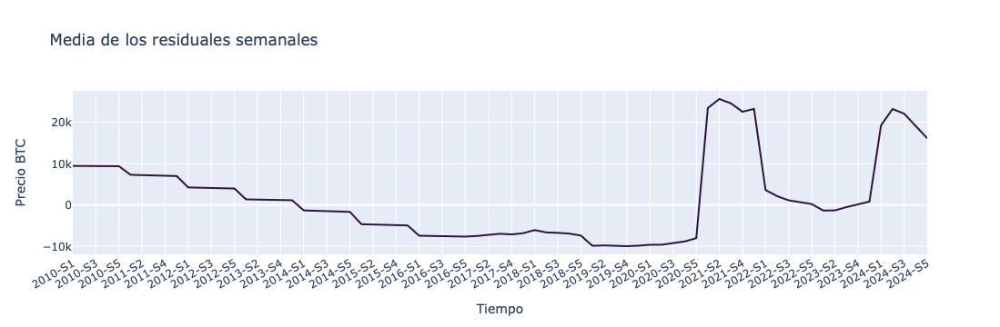

In [206]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week.index,
    y=seasonal_sub_series_data_week['week_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

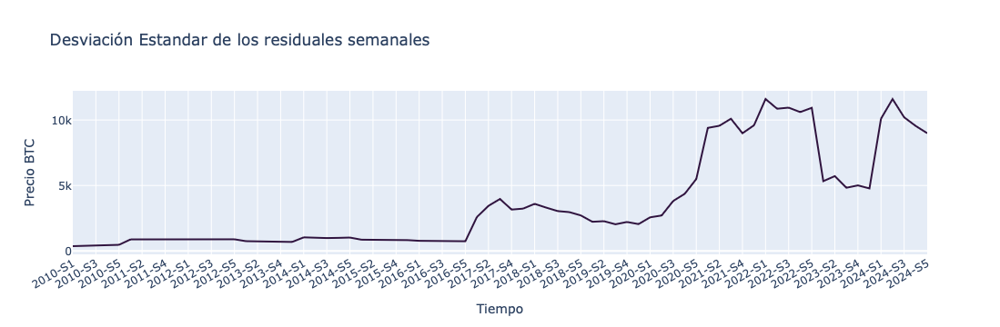

In [208]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week.index,
    y=seasonal_sub_series_data_week['week_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

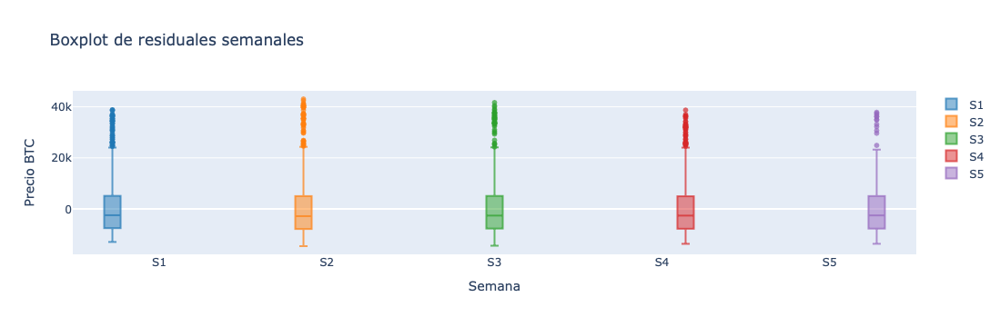

In [210]:
import plotly.graph_objects as go

color_semana = {
    'S1': 'rgba(31, 119, 180, 0.7)',
    'S2': 'rgba(255, 127, 14, 0.7)',
    'S3': 'rgba(44, 160, 44, 0.7)',
    'S4': 'rgba(214, 39, 40, 0.7)',
    'S5': 'rgba(148, 103, 189, 0.7)',
    'S6': 'rgba(227, 119, 194, 0.7)'
}

fig = go.Figure()

# Agrupar por semana y añadir trazas de boxplot
for week, color in color_semana.items():
    week_data = df_1_st[df_1_st['week'] == week]
    fig.add_trace(go.Box(
        y=week_data['Residuals'],
        name=week,
        marker_color=color
    ))

# Configurar el diseño del gráfico
fig.update_layout(
    title='Boxplot de residuales semanales',
    xaxis_title='Semana',
    yaxis_title='Precio BTC',
    boxmode='group'  # Agrupa los boxplots
)

fig.show()


El gráfico de subseries estacionales refleja la tendencia central como la dispersión de los datos estacionales en un lote de unidades temporales, en este caso semanal. Además, la separación entre dos gráficos de caja adyacentes revela las variaciones dentro de la temporada, la cual es nula. 

#### <font color="#30143"> Agrupación de datos Mensual </font>

In [213]:
# Mapa para meses
month_map = {
    1: 'M1', 2: 'M2', 3: 'M3', 4: 'M4', 5: 'M5', 6: 'M6',
    7: 'M7', 8: 'M8', 9: 'M9', 10: 'M10', 11: 'M11', 12: 'M12'
}

# Asignar el mes usando la columna 'Month'
df_1_st['month'] = df_1_st['Month'].map(month_map)

In [214]:
seasonal_sub_series_data_month = df_1_st.groupby(by=['Year', 'month'])['Residuals'].aggregate([np.mean, np.std])
seasonal_sub_series_data_month.columns = ['month_mean', 'month_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `month_map`

In [216]:
seasonal_sub_series_data_month.reset_index(inplace=True)
seasonal_sub_series_data_month.index = seasonal_sub_series_data_month['Year'].astype(str) + '-' + seasonal_sub_series_data_month['month']
seasonal_sub_series_data_month.head()

,Year,month,month_mean,month_sd
2010-M10,2010,M10,9357.3514,76.0969
2010-M11,2010,M11,9102.1321,73.6929
2010-M12,2010,M12,8846.7441,76.1006
2010-M7,2010,M7,10056.4415,35.0250
2010-M8,2010,M8,9868.0587,76.1244


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = mensual. 

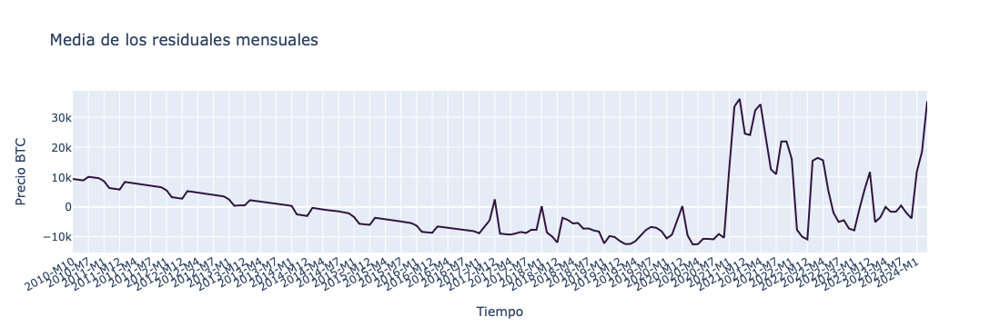

In [218]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

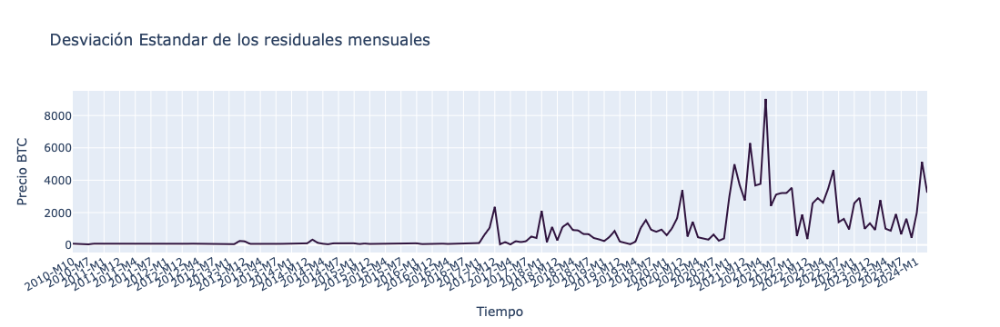

In [220]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

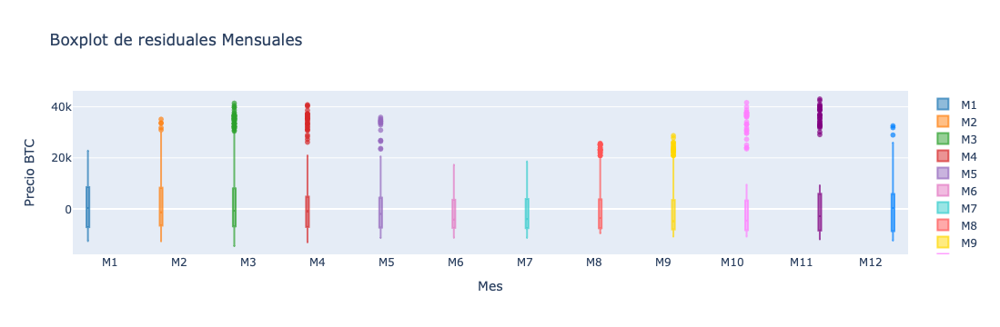

In [222]:
import plotly.graph_objects as go

# Mapa de colores para los meses
color_mes = {
    'M1': 'rgba(31, 119, 180, 0.7)',  
    'M2': 'rgba(255, 127, 14, 0.7)',   
    'M3': 'rgba(44, 160, 44, 0.7)',   
    'M4': 'rgba(214, 39, 40, 0.7)',    
    'M5': 'rgba(148, 103, 189, 0.7)',   
    'M6': 'rgba(227, 119, 194, 0.7)',   
    'M7': 'rgba(51, 204, 204, 0.7)',    
    'M8': 'rgba(255, 85, 85, 0.7)',     
    'M9': 'rgba(255, 215, 0, 0.7)',     
    'M10': 'rgba(255, 127, 255, 0.7)', 
    'M11': 'rgba(128, 0, 128, 0.7)',    
    'M12': 'rgba(0, 128, 255, 0.7)'     
}


fig = go.Figure()


for month, color in color_mes.items():
    month_data = df_1_st[df_1_st['month'] == month]
    fig.add_trace(go.Box(
        y=month_data['Residuals'],
        name=month,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Mensuales',
    xaxis_title='Mes',
    yaxis_title='Precio BTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales muestra tanto la tendencia central como la dispersión de los datos en un intervalo temporal mensual respecto al precio del Bitcoin. Se observa que la variabilidad de los datos es considerablemente mayor en ciertos períodos. En particular, la comparación entre los gráficos de caja adyacentes revela que durante los meses de abril a octubre, la dispersión de los datos es relativamente menor. En contraste, los meses de noviembre, diciembre y enero presentan una mayor variabilidad. Este aumento en la dispersión se puede atribuir al incremento en la actividad del mercado durante las festividades de Navidad, cuando el flujo de capital es más intenso y las decisiones de inversión tienden a ser más erráticas. 

#### <font color="#30143"> Agrupación de datos Anual </font>

In [225]:
unique_years = df_1_st['Year'].unique()
unique_years

array([2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
       2021, 2022, 2023, 2024], dtype=int32)

In [226]:
# Mapa para year
year_map = {
    2010: '2010', 2011: '2011', 2012: '2012', 2013: '2013', 2014: '2014', 2015: '2015',
    2016: '2016', 2017: '2017', 2018: '2018', 2019: '2019', 2020: '2020', 2021: '2022',
    2023: '2023', 2024:'2024'
}

# Asignar el mes usando la columna 'Month'
df_1_st['year'] = df_1_st['Year'].map(year_map)

In [227]:
seasonal_sub_series_data_year = df_1_st.groupby(by=['Year', 'year'])['Residuals'].aggregate([np.mean, np.std])
seasonal_sub_series_data_year.columns = ['year_mean', 'year_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `year_map`

In [229]:
seasonal_sub_series_data_year.reset_index(inplace=True)
seasonal_sub_series_data_year.index = seasonal_sub_series_data_year['Year'].astype(str) + '-' + seasonal_sub_series_data_year['year']
seasonal_sub_series_data_year.head()

,Year,year,year_mean,year_sd
2010-2010,2010,2010,9415.9987,404.7756
2011-2011,2011,2011,7194.3817,882.2314
2012-2012,2012,2012,4136.8554,882.9378
2013-2013,2013,2013,1268.5392,726.8487
2014-2014,2014,2014,-1464.7058,1007.9219


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = anual. 

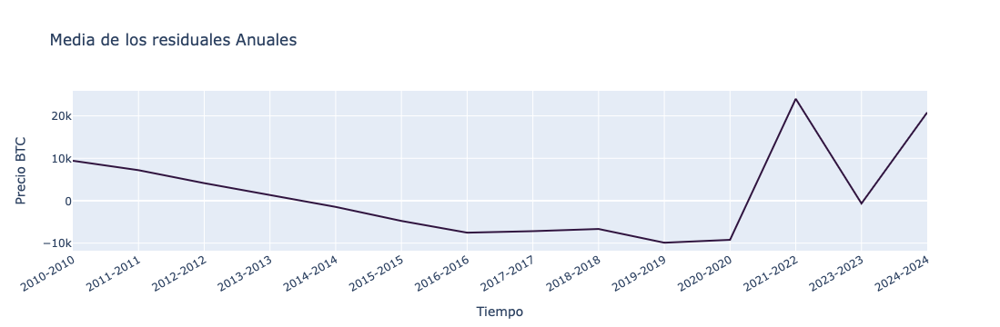

In [231]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales Anuales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

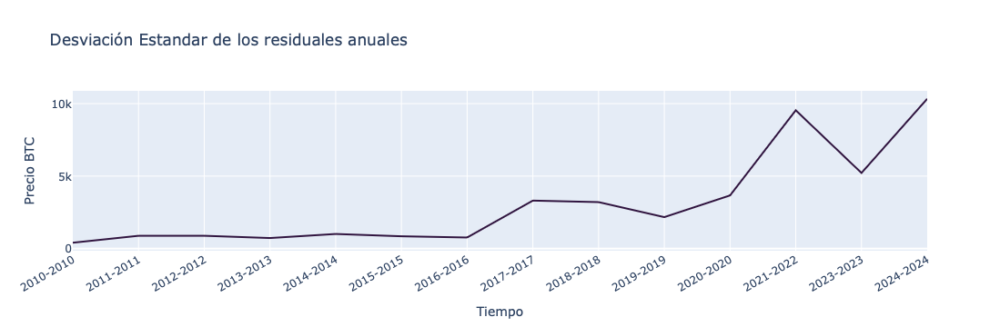

In [233]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales anuales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

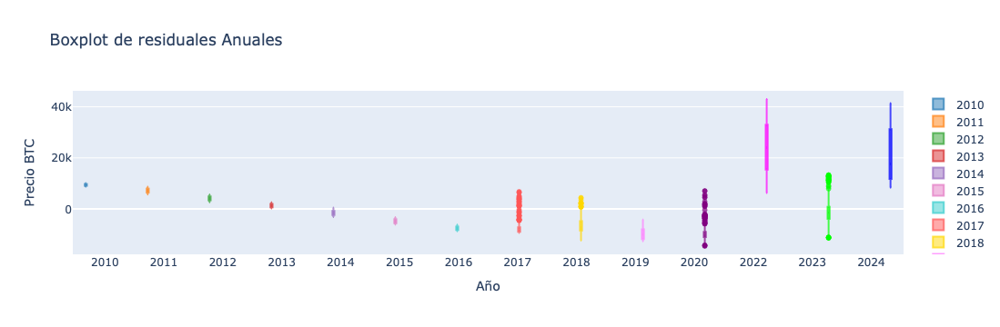

In [235]:
import plotly.graph_objects as go

color_año = {
    '2010': 'rgba(31, 119, 180, 0.7)',  
    '2011': 'rgba(255, 127, 14, 0.7)',   
    '2012': 'rgba(44, 160, 44, 0.7)',   
    '2013': 'rgba(214, 39, 40, 0.7)',    
    '2014': 'rgba(148, 103, 189, 0.7)',   
    '2015': 'rgba(227, 119, 194, 0.7)',   
    '2016': 'rgba(51, 204, 204, 0.7)',    
    '2017': 'rgba(255, 85, 85, 0.7)',     
    '2018': 'rgba(255, 215, 0, 0.7)',     
    '2019': 'rgba(255, 127, 255, 0.7)', 
    '2020': 'rgba(128, 0, 128, 0.7)',    
    '2021': 'rgba(0, 128, 255, 0.7)',     
    '2022': 'rgba(255, 0, 255, 0.7)',    
    '2023': 'rgba(0, 255, 0, 0.7)',      
    '2024': 'rgba(0, 0, 255, 0.7)'       
}


fig = go.Figure()


for year, color in color_año.items():
    year_data = df_1_st[df_1_st['year'] == year]
    fig.add_trace(go.Box(
        y=year_data['Residuals'],
        name=year,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Anuales',
    xaxis_title='Año',
    yaxis_title='Precio BTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales ilustra tanto la tendencia central como la dispersión de los datos mensuales en relación con el precio del Bitcoin. A lo largo de diferentes períodos, se destaca una notable variabilidad en los precios. Desde 2010 hasta 2016, el precio del Bitcoin se mantuvo relativamente estable, pero en 2017 experimentó un aumento significativo, acompañado de una fuerte fluctuación. En 2018, el precio descendió levemente; sin embargo, entre 2020 y 2022, se observó un notable incremento en su valor. El comportamiento del mercado en 2023 fue similar al de 2020, mientras que 2022 mostró patrones que se asemejan a los de 2024, sugiriendo tendencias recurrentes en la evolución del precio del Bitcoin. 

### Eliminación de la tendencia entre la serie y sus rezagos. 

A continuación gráficamos la `Autocorrelación` y `Autocorrelación parcial` de la serie de tiempo asociada con el precio del Bitcoin. 

#### <font color="#30143"> Gráfico Autocorrelación y Autocorrelación Parical  </font>

A continuación se presenta gráfico de autocorrelación y autocorrelación parcial de nuestra serie temporal (Precio).

In [241]:
def plotds(xt, nlag=1, fig_size=(12, 10)):
    if not isinstance(xt, pd.Series):
        xt = pd.Series(xt)

    plt.figure(figsize=fig_size)
    layout = (2, 2)
    
    ax_acf = plt.subplot2grid(layout, (1, 0))
    ax_pacf = plt.subplot2grid(layout, (1, 1))

    plot_acf(xt, lags=100, ax=ax_acf)
    plot_pacf(xt, lags=100, ax=ax_pacf)

    ax_acf.set_title('ACF')
    ax_pacf.set_title('PACF')
    plt.tight_layout()
    
    plt.show() 
    return None

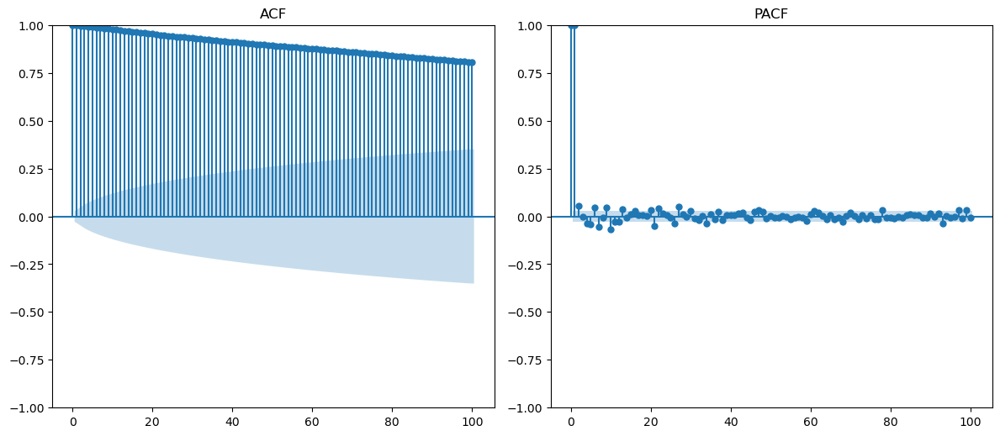

In [242]:
plotds(df_1_st['Price'])

Al examinar el gráfico de `autocorrelación (ACF)`, se observa un decaimiento lento en lugar de uno rápido. Esto indica que las correlaciones entre los valores actuales y sus antecedentes permanecen significativas a lo largo de numerosos rezagos. Este hallazgo es `coherente` con los resultados del test de `Dickey-Fuller`, que también confirma que la serie es `NO estacionaria`.

Por otro lado, el gráfico de `autocorrelación parcial (PACF)` sugiere la existencia de `componentes cíclicos`. Además, la forma de onda observada en este gráfico refuerza la idea de no estacionaridad, ya que la `variabilidad` parece estar vinculada a ciclos específicos. Esto implica que las `propiedades estadísticas de la serie cambian con el tiempo`.

La eliminación de la tendencia y de la correlación entre la serie y sus rezagos puede hacerse por diferenciación.

##### Diferenciación de 1er Orden: 

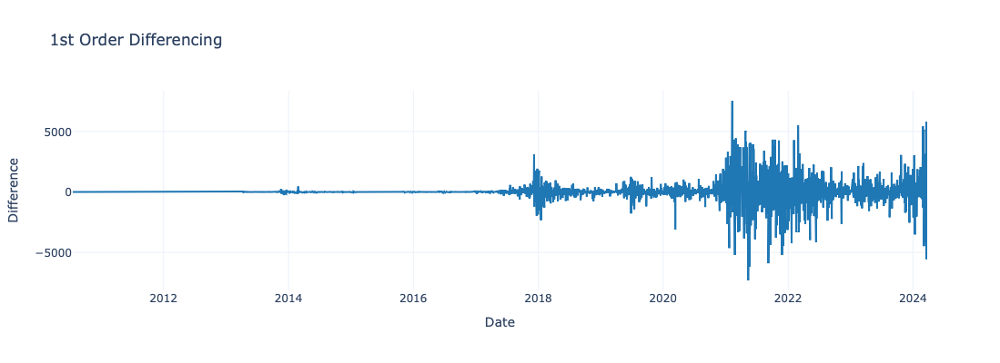

<Figure size 1000x500 with 0 Axes>

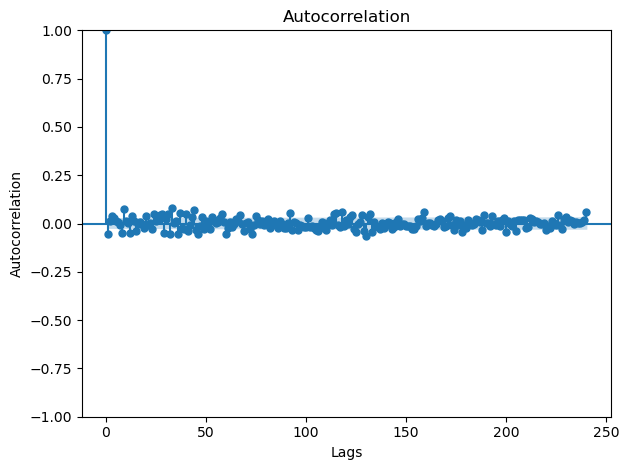

In [246]:
diff_price = df_1_st.Price.diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_price.index, y=diff_price, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='1st Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_price, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()

Luego de aplicar una diferenciación de 1er orden, procedemos aplicar nuevamente la prueba de `Dickey-Fuller` para validar si nuestra serie de tiempo es estacionaria.

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [249]:
result1 = adfuller(df_1_st.Price.diff().dropna())
dickeyfuller_t1 = result1[1]
print('ADF Statistic: %f' % result1[0])
print('p-value: %f' % result1[1])

# Evaluar resultados del test
if dickeyfuller_t1 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -9.886578
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


##### Diferenciación de 2do Orden: 

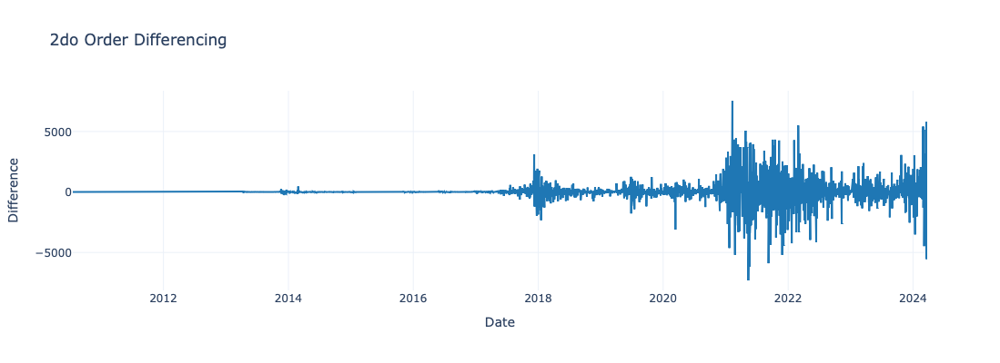

<Figure size 1000x500 with 0 Axes>

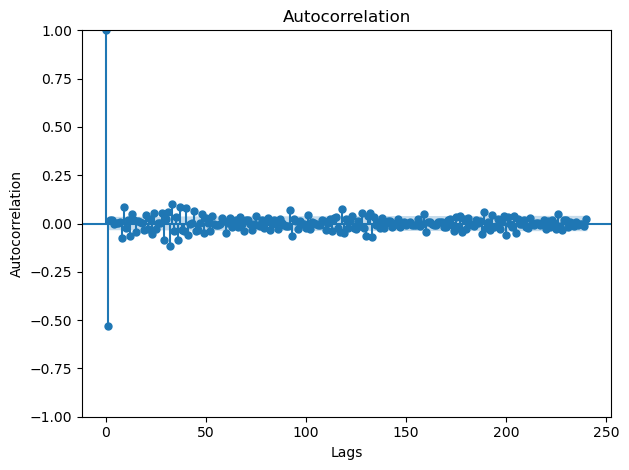

In [251]:
diff_price2 = df_1_st.Price.diff().diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_price2.index, y=diff_price, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='2do Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_price2, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()


In [252]:
result2 = adfuller(df_1_st.Price.diff().diff().dropna())
dickeyfuller_t2 = result2[1]
print('ADF Statistic: %f' % result2[0])
print('p-value: %f' % result2[1])

# Evaluar resultados del test
if dickeyfuller_t2 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -22.671517
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


De acuerdo al resultado obtenido con la prueba de `Dickey-Fuller` con P-value $<0.00000$, por tanto no se rechaza la hipótesis nula con una significancia $\alpha = 0.05$, es decir que `la serie de tiempo es no estacionaria`. Sin embargo al momento de análizar el gráfico de autocorrelación para la 2da diferenciación, el retraso entra en el zona negativa muy distante de nuestro limite de tolerancia, lo que indica que la serie podría haber sido sobrediferenciada. 

Por lo tanto, `vamos a fijar el orden de diferenciación como 1`, es decir,  $ d = 1$ . 


### <font color="#30143"> Agregacion por grupos (Price) </font>

Primero, vamos a agregar los datos por semanas, días y meses, y calcular las estadísticas de media y desviación estándar. Usamos `pandas` para la agregación:

In [256]:
# Asegurándonos de que la fecha esté en el índice


# Agregación semanal
weekly_stats = df_1_st['Price'].resample('W').agg(['mean', 'std']).rename(columns={'mean': 'Weekly Mean', 'std': 'Weekly Std'})

# Agregación diaria
daily_stats = df_1_st['Price'].resample('D').agg(['mean', 'std']).rename(columns={'mean': 'Daily Mean', 'std': 'Daily Std'})

# Agregación mensual
monthly_stats = df_1_st['Price'].resample('M').agg(['mean', 'std']).rename(columns={'mean': 'Monthly Mean', 'std': 'Monthly Std'})


Para calcular los estadísticos móviles (media y desviación estándar móviles), podemos usar ventanas móviles para `Price`. A continuación, calcularemos las medias móviles y desviaciones móviles:

In [258]:
# Definir ventanas móviles (lags)
window_sizes = [7, 14, 21, 28]

# Crear DataFrame vacío para almacenar las estadísticas móviles
moving_stats = pd.DataFrame(index=df_1_st.index)

# Calcular estadísticas móviles para cada ventana
for window in window_sizes:
    moving_stats[f'Moving Mean ({window} days)'] = df_1_st['Price'].rolling(window=window).mean()
    moving_stats[f'Moving Std ({window} days)'] = df_1_st['Price'].rolling(window=window).std()

# Mostrar las estadísticas móviles
moving_stats.tail()


,Moving Mean (7 days),Moving Std (7 days),Moving Mean (14 days),Moving Std (14 days),Moving Mean (21 days),Moving Std (21 days),Moving Mean (28 days),Moving Std (28 days)
Date,,,,,,,,
2024-03-20,67436.3857,3009.6809,68646.3500,2877.5168,67042.3476,3559.9281,63830.8357,6748.7324
2024-03-21,66595.8571,2500.9079,68549.8143,2963.6078,67248.7524,3319.9514,64337.3857,6291.7604
2024-03-22,65784.6857,2330.7664,68236.4929,3226.8130,67314.8381,3231.1858,64803.2786,5703.0870
2024-03-23,65602.3429,2421.8568,67927.3000,3415.2813,67412.1381,3090.6747,65248.5000,5084.9773
2024-03-24,65433.8714,2228.8493,67802.0929,3406.4399,67606.2381,2932.6376,65801.6857,4348.1717


Finalmente, para la parte de la distribución de frecuencias, podemos usar un histograma para visualizar la distribución de la variable `Price` y cómo cambia con diferentes lags:

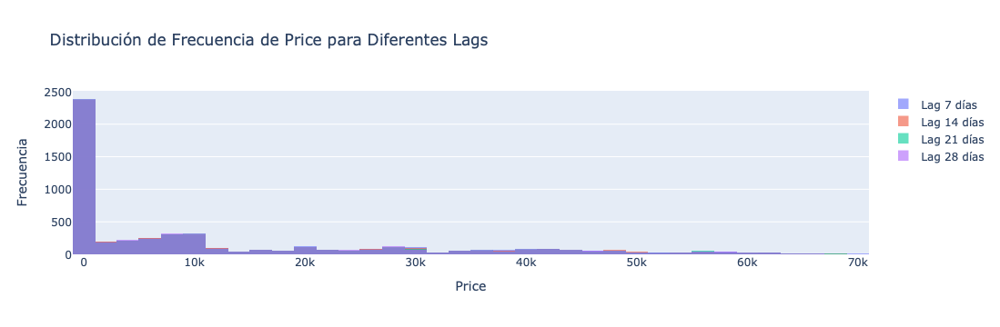

In [260]:
import plotly.express as px
import plotly.graph_objects as go

# Definir lags (ventanas móviles)
lags = [7, 14, 21, 28]

# Crear un gráfico para cada ventana móvil
fig = go.Figure()

for lag in lags:
    fig.add_trace(go.Histogram(
        x=df_1_st['Price'].rolling(window=lag).mean(),
        name=f'Lag {lag} días',
        opacity=0.6,
        nbinsx=50
    ))

# Ajustar el diseño del gráfico
fig.update_layout(
    title='Distribución de Frecuencia de Price para Diferentes Lags',
    xaxis_title='Price',
    yaxis_title='Frecuencia',
    barmode='overlay',  # Para que se superpongan las distribuciones
    showlegend=True
)

# Mostrar el gráfico
fig.show()



La gráfica de distribución de frecuencias del precio de Bitcoin para diferentes ventanas móviles (lags de 7, 14, 21 y 28 días) muestra una alta concentración de observaciones en los precios más bajos, reflejando que durante la mayor parte del tiempo Bitcoin mantuvo valores por debajo de los 10,000 USD. A medida que los precios aumentan, la frecuencia disminuye drásticamente, lo que indica que los máximos históricos fueron alcanzados en un número reducido de días. El comportamiento de las distribuciones es similar para todas las ventanas móviles, lo que sugiere que los patrones del precio no varían significativamente con diferentes lags.

### <font color="#30143"> Medias Moviles (Price) </font>

Para aplicar las medias móviles indicadas a la serie de tiempo del precio de cierre de BTC-USD, y verificar si se logra estacionaridad, seguimos los siguientes pasos:

1. **Cálculo de las Medias Móviles**: Definimos las medias móviles simples $ \hat{M}_t^{(2)}, \hat{M}_t^{(3)}, \hat{M}_t^{(4)} $, y sus respectivas versiones con desplazamiento temporal $ \hat{M}_t^{(2)}(t, t+1), $ etc. Estas se calculan con ventanas móviles de tamaño 2, 3, y 4 días.

2. **Aplicar Medias Móviles al Precio de Cierre (Price)**:
    - $ \hat{M}_t^{(2)} $: media móvil de dos días.
    - $ \hat{M}_t^{(3)} $: media móvil de tres días.
    - $ \hat{M}_t^{(4)} $: media móvil de cuatro días.

3. **Remover la Tendencia**: Para eliminar la tendencia, restamos la media móvil calculada a la serie original del precio de cierre (Close). Esto nos permite obtener la serie sin tendencia.
4. **Pruebas de Estacionaridad**: Aplicamos la prueba de **Dickey-Fuller** para verificar si la serie ajustada se vuelve estacionaria. Luego, aplicamos la prueba de **Ljung-Box** para comprobar la independencia de los residuales.



In [264]:
# Importar las librerías necesarias
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox
import numpy as np

# Calcular medias móviles para diferentes ventanas
df_1_st['M_t_2'] = df_1_st['Price'].rolling(window=2).mean()
df_1_st['M_t_3'] = df_1_st['Price'].rolling(window=3).mean()
df_1_st['M_t_4'] = df_1_st['Price'].rolling(window=4).mean()

# Calcular las medias móviles desplazadas
df_1_st['M_t_2_shift'] = df_1_st['Price'].rolling(window=2).mean().shift(1)
df_1_st['M_t_3_shift'] = df_1_st['Price'].rolling(window=3).mean().shift(1)
df_1_st['M_t_4_shift'] = df_1_st['Price'].rolling(window=4).mean().shift(1)

# Eliminar tendencia restando la media móvil a la serie original (Asegúrate de usar df_1_st)
df_1_st['detrended_2'] = df_1_st['Price'] - df_1_st['M_t_2']
df_1_st['detrended_3'] = df_1_st['Price'] - df_1_st['M_t_3']
df_1_st['detrended_4'] = df_1_st['Price'] - df_1_st['M_t_4']

# Función para aplicar la prueba de Dickey-Fuller y Ljung-Box
def apply_stationarity_tests(series):
    # Eliminar los valores nulos antes de aplicar las pruebas
    series_clean = series.dropna()
    
    # Verificar que la serie no esté vacía después de eliminar los NaN
    if series_clean.empty:
        print("La serie es demasiado corta para realizar el test.")
        return
    
    # Prueba de Dickey-Fuller
    result_dickeyfuller = adfuller(series_clean)
    p_value_dickey = result_dickeyfuller[1]
    print(f"Dickey-Fuller p-value: {p_value_dickey}")
    
    # Prueba de Ljung-Box para los residuales
    result_ljungbox = acorr_ljungbox(series_clean, lags=[10], return_df=True)
    p_value_ljungbox = result_ljungbox['lb_pvalue'].iloc[0]
    print(f"Ljung-Box p-value: {p_value_ljungbox}")
    
    return p_value_dickey, p_value_ljungbox

# Aplicar las pruebas para cada una de las series detrendizadas
print("Resultados para Media Móvil de 2 días:")
apply_stationarity_tests(df_1_st['detrended_2'])

print("\nResultados para Media Móvil de 3 días:")
apply_stationarity_tests(df_1_st['detrended_3'])

print("\nResultados para Media Móvil de 4 días:")
apply_stationarity_tests(df_1_st['detrended_4'])


Resultados para Media Móvil de 2 días:
Dickey-Fuller p-value: 3.650527341575163e-17
Ljung-Box p-value: 1.3817815337886075e-11

Resultados para Media Móvil de 3 días:
Dickey-Fuller p-value: 3.157399273324852e-16
Ljung-Box p-value: 2.029878968834469e-154

Resultados para Media Móvil de 4 días:
Dickey-Fuller p-value: 1.5093100712033155e-15
Ljung-Box p-value: 0.0


(1.5093100712033155e-15, 0.0)

Los resultados de las pruebas de Dickey-Fuller y Ljung-Box para las series de precios del Bitcoin detrendizadas usando medias móviles de 2, 3 y 4 días indican lo siguiente:

1. **Dickey-Fuller Test**:
   - Para las tres medias móviles (2, 3 y 4 días), el p-valor es extremadamente bajo (menor a 0.05), lo que nos permite rechazar la hipótesis nula de no estacionaridad. Por lo tanto, las series parecen estacionarias después de eliminar la tendencia utilizando las medias móviles.

2. **Ljung-Box Test**:
   - Los p-valores para las pruebas de independencia de los residuales son también extremadamente bajos para las medias móviles de 2 y 3 días, lo que indica que los residuales no son independientes y presentan autocorrelación.
   - En el caso de la media móvil de 4 días, el p-valor es 0, lo que refuerza la idea de que los residuales no son independientes y hay autocorrelación significativa.

Aunque la serie parece ser estacionaria según el test de Dickey-Fuller, las pruebas de Ljung-Box sugieren que hay autocorrelación en los residuales, lo cual indica que no todas las propiedades de estacionaridad están satisfechas.


### <font color="#30143"> Descomposición de la serie temporal (Price) </font>

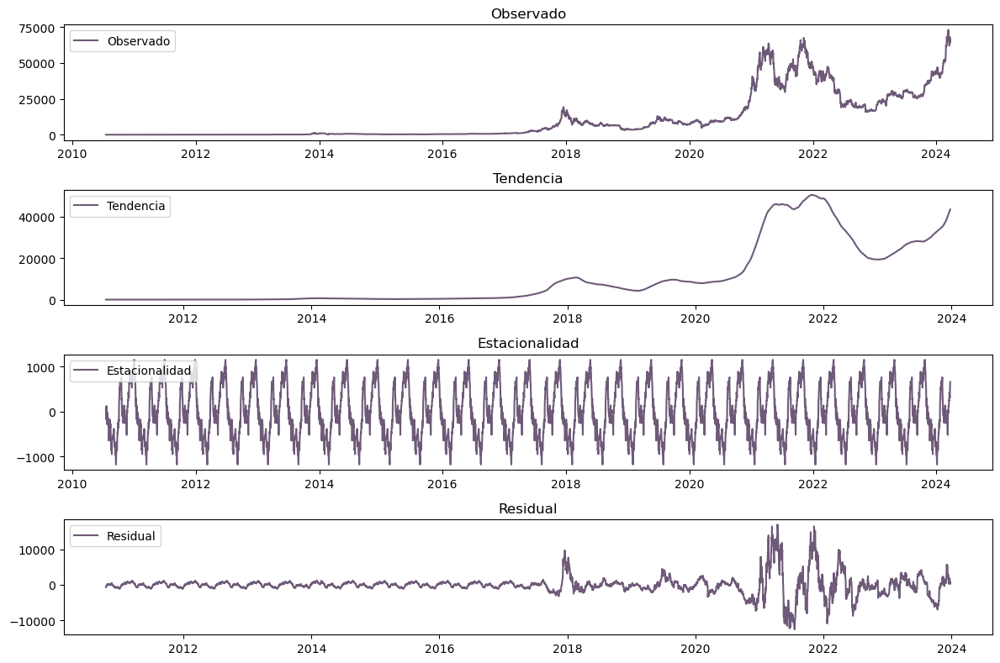

In [267]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

periodo = 180 # Cambia esto según la estacionalidad esperada 24 datos diarios (horario) x 365 días del año

# Realizar la descomposición estacional
decomposition = seasonal_decompose(df_1_st['Price'], model='aditive', period=periodo)

# Graficar los componentes
plt.figure(figsize=(12, 8))
plt.subplot(411)
plt.plot(df_1_st['Price'], label='Observado', color='#30143F', alpha=0.7)
plt.title('Observado')
plt.legend(loc='upper left')
plt.subplot(412)
plt.plot(decomposition.trend, label='Tendencia', color='#30143F', alpha=0.7)
plt.title('Tendencia')
plt.legend(loc='upper left')
plt.subplot(413)
plt.plot(decomposition.seasonal, label='Estacionalidad', color='#30143F', alpha=0.7)
plt.title('Estacionalidad')
plt.legend(loc='upper left')
plt.subplot(414)
plt.plot(decomposition.resid, label='Residual', color='#30143F', alpha=0.7)
plt.title('Residual')
plt.legend(loc='upper left')
plt.tight_layout()
plt.show()

El gráfico de descomposición de la serie de tiempo evidencia la no estacionaridad de la misma, ya que los valores no se mantienen constantes a lo largo del tiempo. Los residuales presentan una alta variabilidad, lo que sugiere que la varianza no es constante. Además, el gráfico de tendencia no revela un patrón claro, lo que indica la dificultad de capturar dicha tendencia de manera precisa.

#### <font color="#30143"> Estacionaridad </font>

<div class="alert alert-block" style="background-color: #e1d9e3; color: #30143; padding: 10px; border-radius: 10px;">
    <i class="fa fa-info-circle" aria-hidden="true"></i>
    <strong>Importante:</strong>
    Una serie de tiempo se considera <strong><em>No estacionaria</em></strong> si la distribución de sus datos (media, varianza, autocorrelación, etc.) <em>no permanece constante a lo largo del tiempo</em>, es decir, si  muestra <em>tendencia, variación en la varianza, autocorrelación significativa</em>. 
</div>

* **Prueba de Dickey-Fuller**

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [273]:
result_dickeyfuller = adfuller(df_1_st.Price)
dickeyfuller_t = result_dickeyfuller[1]

print('ADF Statistic: %f' % result_dickeyfuller[0])
print('p-value: %f' % result_dickeyfuller[1])

# Evaluar resultados del test
if dickeyfuller_t > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -0.164372
p-value: 0.942637
No se rechaza H0: La serie de tiempo es no estacionaria


* **Prueba de Ljung-Box**

De igual forma, podemos de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Ljung-Box`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{Los residuales son independientes (No correlacionados)}$$
$$ H_1 : \text{Los residuales no son independientes (Hay autocorrelación en los residuales)}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que hay suficiente evidencia estadística para afirmar que la serie es estacionaria y los residuales son independientes.

In [276]:
ljungbox_result = acorr_ljungbox(residuals, lags=[10], return_df=True)
print('LB Statistic: %f' % ljungbox_result['lb_stat'].iloc[0])
print('p-value: %f' % ljungbox_result['lb_pvalue'].iloc[0])


# Pruebas de independencia y normalidad
ljung_box_result = acorr_ljungbox(residuals, lags=[10], return_df=True)
jung_box_pval = ljung_box_result['lb_pvalue'].iloc[0]

# Evaluar resultados del test
if jung_box_pval > 0.05:
    print('No se rechaza H0: los residuales son independientes (no correlacionados)')
else:
    print('Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)')

LB Statistic: 48206.158615
p-value: 0.000000
Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)


## <font color="#30143">Análisis Exploratorio de series de tiempo de Retorno Acumulado diario </font>

### <font color="#30143">  Gráficos Subserie Estacional </font>

In [279]:
residuals_A_t = np.array(df_1_st['A_t']) - trend_model.predict(np.arange(df_1_st.shape[0]).reshape((-1,1)))
df_1_st['Residuals_A_t'] = residuals_A_t

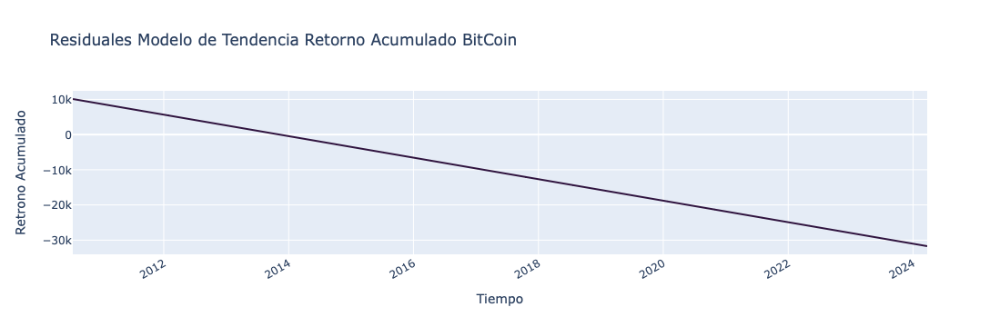

In [280]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=df_1_st.index,
    y=residuals_A_t,
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales de Retorno Acumulado'
))

fig.update_layout(
    title='Residuales Modelo de Tendencia Retorno Acumulado BitCoin',
    xaxis_title='Tiempo',
    yaxis_title='Retrono Acumulado',
    xaxis_tickangle=-30)


fig.show()


Los residuales del modelo de tendencia general del Retorno Acumulado describen una tendencia decreciente en el tiempo. 

#### <font color="#30143"> Agrupación de datos semanales </font>

In [283]:
seasonal_sub_series_data_week_r = df_1_st.groupby(by=['Year', 'week'])['Residuals_A_t'].aggregate([np.mean, np.std])
seasonal_sub_series_data_week_r.columns = ['week_mean', 'week_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `week_map`

In [285]:
seasonal_sub_series_data_week_r.reset_index(inplace=True)
seasonal_sub_series_data_week_r.index = seasonal_sub_series_data_week_r['Year'].astype(str) + '-' + seasonal_sub_series_data_week_r['week']
seasonal_sub_series_data_week_r

,Year,week,week_mean,week_sd
2010-S1,2010,S1,9456.6474,366.1033
2010-S2,2010,S2,9398.0632,366.0964
2010-S3,2010,S3,9417.3782,417.3911
2010-S4,2010,S4,9409.6804,442.2427
2010-S5,2010,S5,9385.3439,466.0874
...,...,...,...,...
2024-S1,2024,S1,-31296.1127,210.7190
2024-S2,2024,S2,-31354.6437,210.6893
2024-S3,2024,S3,-31413.2648,210.6862
2024-S4,2024,S4,-31410.5313,185.6574


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = semanal. 

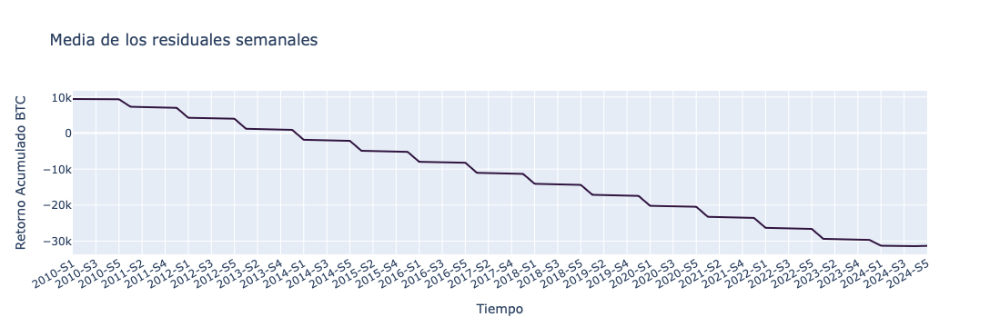

In [287]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Retorno Acumulado BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento estacional, lo que significa que se observan variaciones repetitivas y periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios siguen un patrón predecible a lo largo del tiempo.

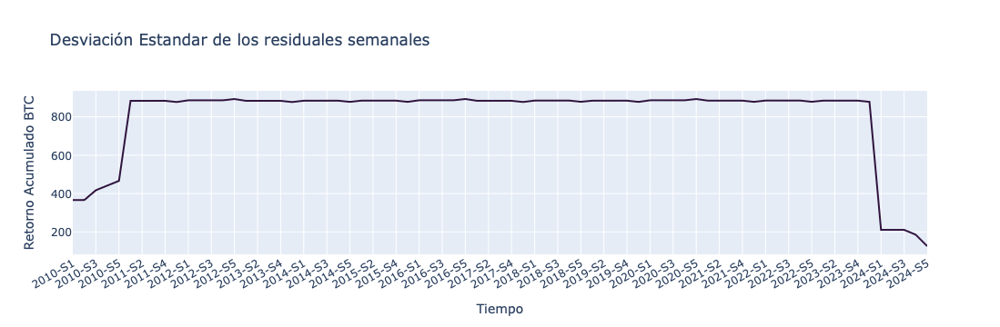

In [289]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Retorno Acumulado BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del retorno acumulado del Bitcoin refleja  poca variabilidad, lo que sugiere que no existen fluctuaciones y presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones son predecibles y periódicas.

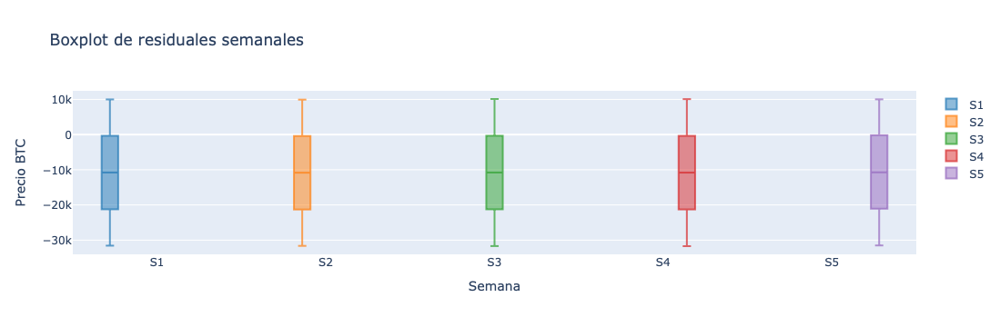

In [291]:
color_semana = {
    'S1': 'rgba(31, 119, 180, 0.7)',
    'S2': 'rgba(255, 127, 14, 0.7)',
    'S3': 'rgba(44, 160, 44, 0.7)',
    'S4': 'rgba(214, 39, 40, 0.7)',
    'S5': 'rgba(148, 103, 189, 0.7)',
    'S6': 'rgba(227, 119, 194, 0.7)'
}

fig = go.Figure()

# Agrupar por semana y añadir trazas de boxplot
for week, color in color_semana.items():
    week_data = df_1_st[df_1_st['week'] == week]
    fig.add_trace(go.Box(
        y=week_data['Residuals_A_t'],
        name=week,
        marker_color=color
    ))

# Configurar el diseño del gráfico
fig.update_layout(
    title='Boxplot de residuales semanales',
    xaxis_title='Semana',
    yaxis_title='Precio BTC',
    boxmode='group'  # Agrupa los boxplots
)

fig.show()


El gráfico de subseries estacionales refleja la tendencia central como la dispersión de los datos estacionales en un lote de unidades temporales, en este caso semanal. Además, la separación entre dos gráficos de caja adyacentes revela las variaciones dentro de la temporada, la cual es nula. 

#### <font color="#30143"> Agrupación de datos Mensual </font>

In [294]:
# Mapa para meses
month_map = {
    1: 'M1', 2: 'M2', 3: 'M3', 4: 'M4', 5: 'M5', 6: 'M6',
    7: 'M7', 8: 'M8', 9: 'M9', 10: 'M10', 11: 'M11', 12: 'M12'
}

# Asignar el mes usando la columna 'Month'
df_1_st['month'] = df_1_st['Month'].map(month_map)

In [295]:
seasonal_sub_series_data_month = df_1_st.groupby(by=['Year', 'month'])['Residuals'].aggregate([np.mean, np.std])
seasonal_sub_series_data_month.columns = ['month_mean', 'month_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `month_map`

In [297]:
seasonal_sub_series_data_month.reset_index(inplace=True)
seasonal_sub_series_data_month.index = seasonal_sub_series_data_month['Year'].astype(str) + '-' + seasonal_sub_series_data_month['month']
seasonal_sub_series_data_month.head()

,Year,month,month_mean,month_sd
2010-M10,2010,M10,9357.3514,76.0969
2010-M11,2010,M11,9102.1321,73.6929
2010-M12,2010,M12,8846.7441,76.1006
2010-M7,2010,M7,10056.4415,35.0250
2010-M8,2010,M8,9868.0587,76.1244


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = mensual. 

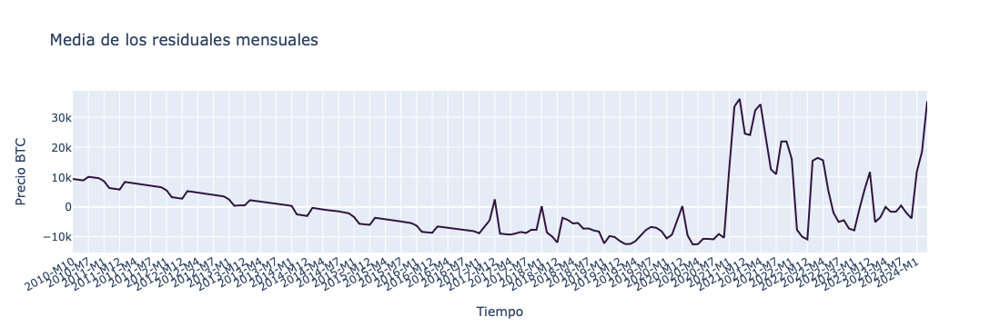

In [299]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

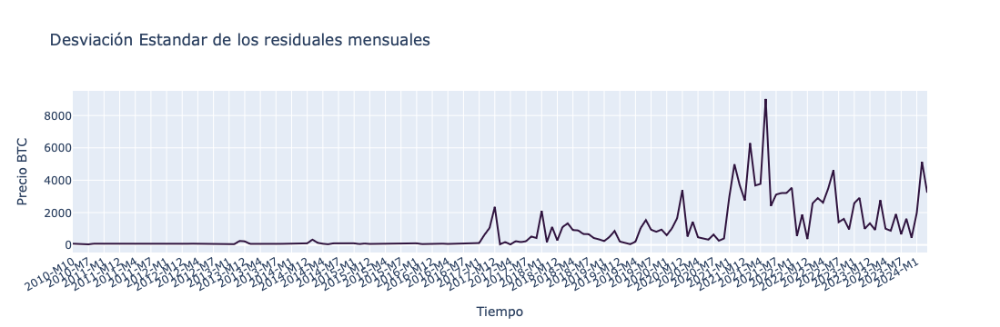

In [301]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

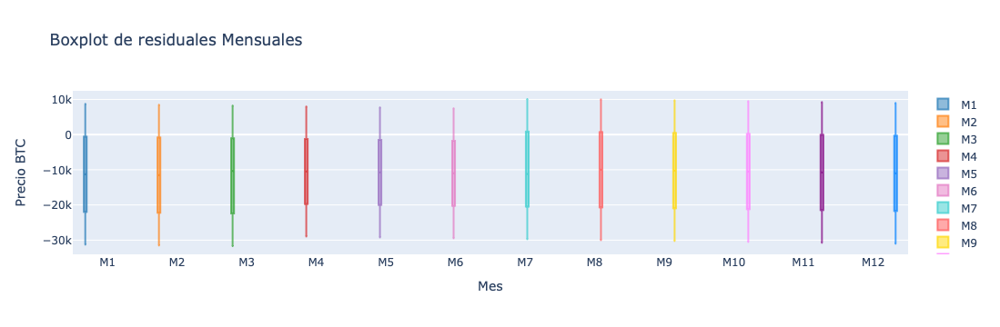

In [303]:
import plotly.graph_objects as go

# Mapa de colores para los meses
color_mes = {
    'M1': 'rgba(31, 119, 180, 0.7)',  
    'M2': 'rgba(255, 127, 14, 0.7)',   
    'M3': 'rgba(44, 160, 44, 0.7)',   
    'M4': 'rgba(214, 39, 40, 0.7)',    
    'M5': 'rgba(148, 103, 189, 0.7)',   
    'M6': 'rgba(227, 119, 194, 0.7)',   
    'M7': 'rgba(51, 204, 204, 0.7)',    
    'M8': 'rgba(255, 85, 85, 0.7)',     
    'M9': 'rgba(255, 215, 0, 0.7)',     
    'M10': 'rgba(255, 127, 255, 0.7)', 
    'M11': 'rgba(128, 0, 128, 0.7)',    
    'M12': 'rgba(0, 128, 255, 0.7)'     
}


fig = go.Figure()


for month, color in color_mes.items():
    month_data = df_1_st[df_1_st['month'] == month]
    fig.add_trace(go.Box(
        y=month_data['Residuals_A_t'],
        name=month,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Mensuales',
    xaxis_title='Mes',
    yaxis_title='Precio BTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales muestra tanto la tendencia central como la dispersión de los datos en un intervalo temporal mensual respecto al precio del Bitcoin. Se observa que la variabilidad de los datos es considerablemente mayor en ciertos períodos. En particular, la comparación entre los gráficos de caja adyacentes revela que durante los meses de abril a octubre, la dispersión de los datos es relativamente menor. En contraste, los meses de noviembre, diciembre y enero presentan una mayor variabilidad. Este aumento en la dispersión se puede atribuir al incremento en la actividad del mercado durante las festividades de Navidad, cuando el flujo de capital es más intenso y las decisiones de inversión tienden a ser más erráticas. 

#### <font color="#30143"> Agrupación de datos Anual </font>

In [306]:
unique_years = df_1_st['Year'].unique()
unique_years

array([2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
       2021, 2022, 2023, 2024], dtype=int32)

In [307]:
# Mapa para year
year_map = {
    2010: '2010', 2011: '2011', 2012: '2012', 2013: '2013', 2014: '2014', 2015: '2015',
    2016: '2016', 2017: '2017', 2018: '2018', 2019: '2019', 2020: '2020', 2021: '2022',
    2023: '2023', 2024:'2024'
}

# Asignar el mes usando la columna 'Month'
df_1_st['year'] = df_1_st['Year'].map(year_map)

In [308]:
seasonal_sub_series_data_year = df_1_st.groupby(by=['Year', 'year'])['Residuals'].aggregate([np.mean, np.std])
seasonal_sub_series_data_year.columns = ['year_mean', 'year_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `year_map`

In [310]:
seasonal_sub_series_data_year.reset_index(inplace=True)
seasonal_sub_series_data_year.index = seasonal_sub_series_data_year['Year'].astype(str) + '-' + seasonal_sub_series_data_year['year']
seasonal_sub_series_data_year.head()

,Year,year,year_mean,year_sd
2010-2010,2010,2010,9415.9987,404.7756
2011-2011,2011,2011,7194.3817,882.2314
2012-2012,2012,2012,4136.8554,882.9378
2013-2013,2013,2013,1268.5392,726.8487
2014-2014,2014,2014,-1464.7058,1007.9219


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = anual. 

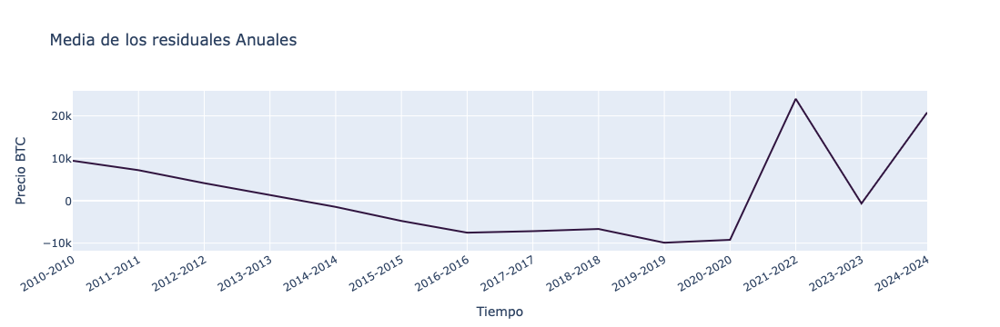

In [312]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales Anuales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

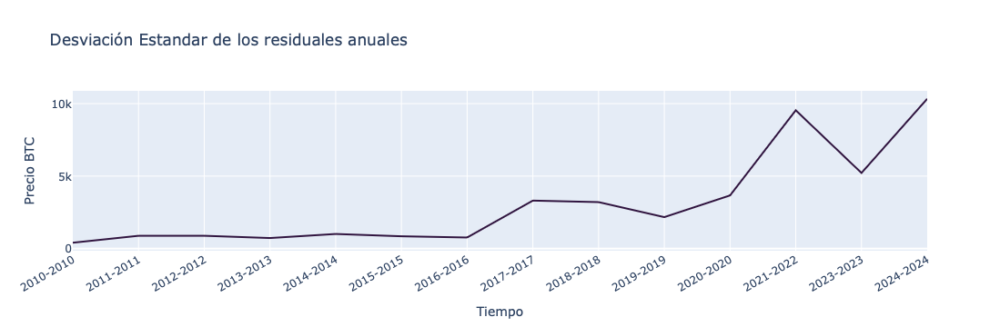

In [314]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales anuales',
    xaxis_title='Tiempo',
    yaxis_title='Precio BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

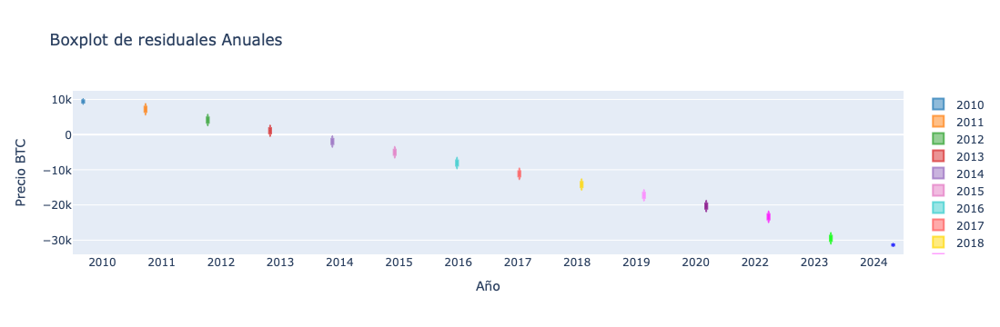

In [316]:
import plotly.graph_objects as go

color_año = {
    '2010': 'rgba(31, 119, 180, 0.7)',  
    '2011': 'rgba(255, 127, 14, 0.7)',   
    '2012': 'rgba(44, 160, 44, 0.7)',   
    '2013': 'rgba(214, 39, 40, 0.7)',    
    '2014': 'rgba(148, 103, 189, 0.7)',   
    '2015': 'rgba(227, 119, 194, 0.7)',   
    '2016': 'rgba(51, 204, 204, 0.7)',    
    '2017': 'rgba(255, 85, 85, 0.7)',     
    '2018': 'rgba(255, 215, 0, 0.7)',     
    '2019': 'rgba(255, 127, 255, 0.7)', 
    '2020': 'rgba(128, 0, 128, 0.7)',    
    '2021': 'rgba(0, 128, 255, 0.7)',     
    '2022': 'rgba(255, 0, 255, 0.7)',    
    '2023': 'rgba(0, 255, 0, 0.7)',      
    '2024': 'rgba(0, 0, 255, 0.7)'       
}


fig = go.Figure()


for year, color in color_año.items():
    year_data = df_1_st[df_1_st['year'] == year]
    fig.add_trace(go.Box(
        y=year_data['Residuals_A_t'],
        name=year,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Anuales',
    xaxis_title='Año',
    yaxis_title='Precio BTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales ilustra tanto la tendencia central como la dispersión de los datos mensuales en relación con el precio del Bitcoin. A lo largo de diferentes períodos, se destaca una notable variabilidad en los precios. Desde 2010 hasta 2016, el precio del Bitcoin se mantuvo relativamente estable, pero en 2017 experimentó un aumento significativo, acompañado de una fuerte fluctuación. En 2018, el precio descendió levemente; sin embargo, entre 2020 y 2022, se observó un notable incremento en su valor. El comportamiento del mercado en 2023 fue similar al de 2020, mientras que 2022 mostró patrones que se asemejan a los de 2024, sugiriendo tendencias recurrentes en la evolución del precio del Bitcoin. 

### Eliminación de la tendencia entre la serie y sus rezagos. 

A continuación gráficamos la `Autocorrelación` y `Autocorrelación parcial` de la serie de tiempo asociada con el precio del Bitcoin. 

#### <font color="#30143"> Gráfico Autocorrelación y Autocorrelación Parical  </font>

A continuación se presenta gráfico de autocorrelación y autocorrelación parcial de nuestra serie temporal (Precio).

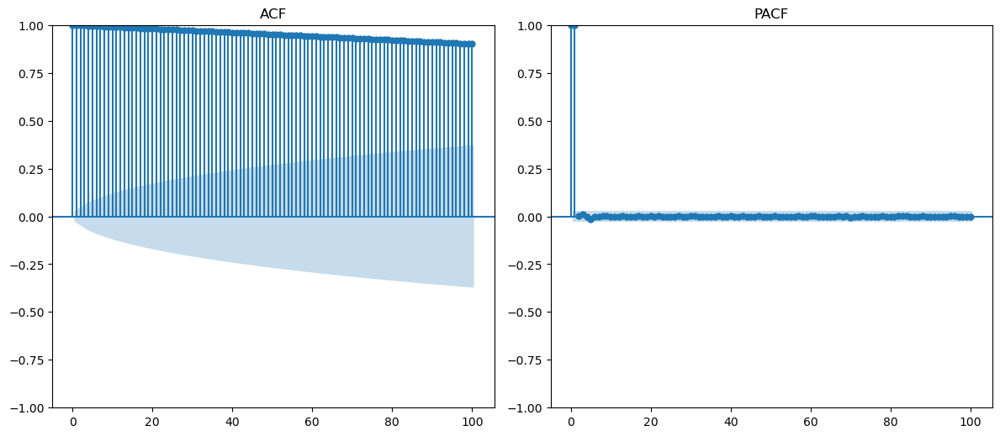

In [322]:
plotds(df_1_st['A_t'])

Al examinar el gráfico de `autocorrelación (ACF)`, se observa un decaimiento lento en lugar de uno rápido. Esto indica que las correlaciones entre los valores actuales y sus antecedentes permanecen significativas a lo largo de numerosos rezagos. 
Por otro lado, el gráfico de `autocorrelación parcial (PACF)` sugiere la no existencia de `componentes cíclicos`. Además, la forma de onda observada dentro del intervalo en este gráfico refuerza la idea de estacionaridad. Esto implica que las `propiedades estadísticas de la serie no cambian con el tiempo`.

La eliminación de la tendencia y de la correlación entre la serie y sus rezagos puede hacerse por diferenciación.

##### Diferenciación de 1er Orden: 

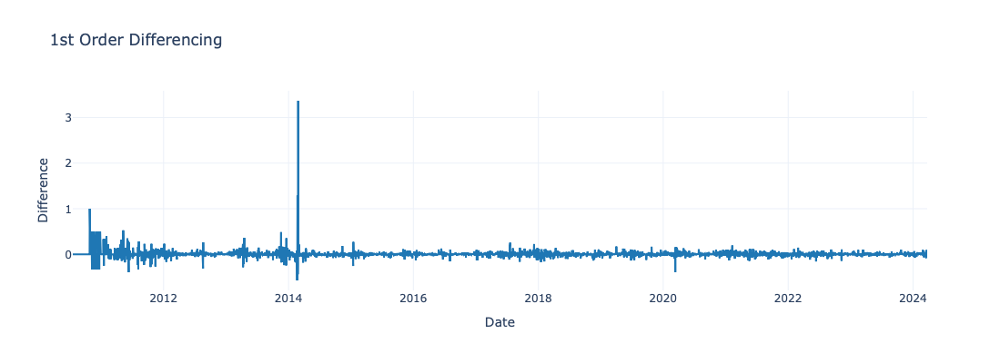

<Figure size 1000x500 with 0 Axes>

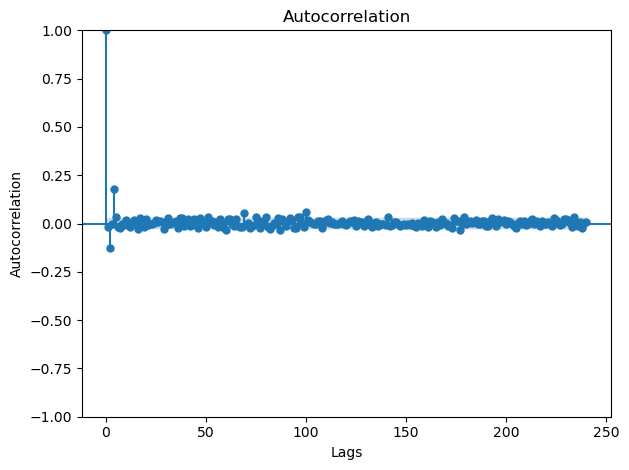

In [326]:
diff_at = df_1_st.A_t.diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_at.index, y=diff_at, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='1st Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_at, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()

Luego de aplicar una diferenciación de 1er orden, procedemos aplicar nuevamente la prueba de `Dickey-Fuller` para validar si nuestra serie de tiempo es estacionaria.

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [329]:
resultat1 = adfuller(df_1_st.A_t.diff().dropna())
dickeyfuller_at1 = resultat1[1]
print('ADF Statistic: %f' % resultat1[0])
print('p-value: %f' % resultat1[1])

# Evaluar resultados del test
if dickeyfuller_at1 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -22.931255
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


##### Diferenciación de 2do Orden: 

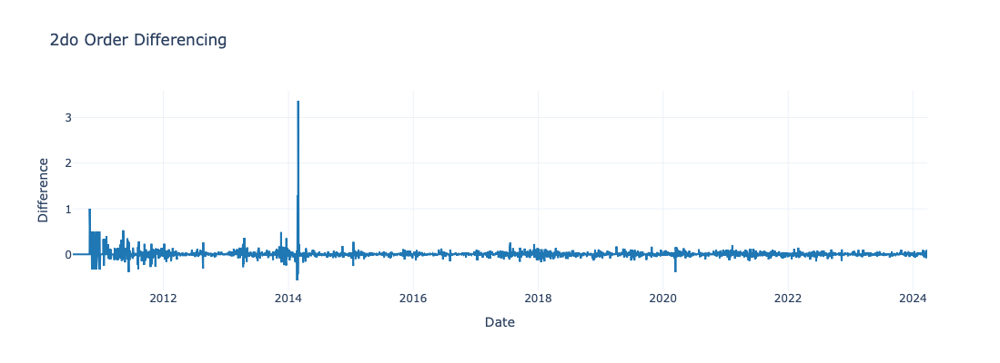

<Figure size 1000x500 with 0 Axes>

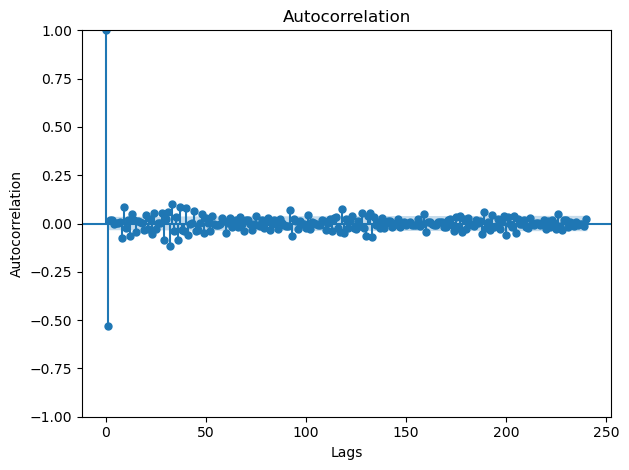

In [331]:
diff_price2 = df_1_st.Price.diff().diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_price2.index, y=diff_at, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='2do Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_price2, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()


In [332]:
resultat2 = adfuller(df_1_st.Price.diff().diff().dropna())
dickeyfuller_at2 = resultat2[1]
print('ADF Statistic: %f' % result2[0])
print('p-value: %f' % result2[1])

# Evaluar resultados del test
if dickeyfuller_at2 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -22.671517
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


De acuerdo al resultado obtenido con la prueba de `Dickey-Fuller` con P-value $<0.00000$, por tanto no se rechaza la hipótesis nula con una significancia $\alpha = 0.05$, es decir que `la serie de tiempo es no estacionaria`. Sin embargo al momento de análizar el gráfico de autocorrelación para la 2da diferenciación, el retraso entra en el zona negativa muy distante de nuestro limite de tolerancia, lo que indica que la serie podría haber sido sobrediferenciada. 

Por lo tanto, `vamos a fijar el orden de diferenciación como 1`, es decir,  $ d = 1$ . 


### <font color="#30143"> Agregacion por grupos (A_T) </font>

Primero, vamos a agregar los datos por semanas, días y meses, y calcular las estadísticas de media y desviación estándar. Usamos `pandas` para la agregación:

In [336]:
# Asegurándonos de que la fecha esté en el índice


# Agregación semanal
weekly_stats = df_1_st['A_t'].resample('W').agg(['mean', 'std']).rename(columns={'mean': 'Weekly Mean', 'std': 'Weekly Std'})

# Agregación diaria
daily_stats = df_1_st['A_t'].resample('D').agg(['mean', 'std']).rename(columns={'mean': 'Daily Mean', 'std': 'Daily Std'})

# Agregación mensual
monthly_stats = df_1_st['A_t'].resample('M').agg(['mean', 'std']).rename(columns={'mean': 'Monthly Mean', 'std': 'Monthly Std'})


Para calcular los estadísticos móviles (media y desviación estándar móviles), podemos usar ventanas móviles para `Retorno Acumulado`. A continuación, calcularemos las medias móviles y desviaciones móviles:

In [338]:
# Definir ventanas móviles (lags)
window_sizes = [7, 14, 21, 28]

# Crear DataFrame vacío para almacenar las estadísticas móviles
moving_stats = pd.DataFrame(index=df_1_st.index)

# Calcular estadísticas móviles para cada ventana
for window in window_sizes:
    moving_stats[f'Moving Mean ({window} days)'] = df_1_st['A_t'].rolling(window=window).mean()
    moving_stats[f'Moving Std ({window} days)'] = df_1_st['A_t'].rolling(window=window).std()

# Mostrar las estadísticas móviles
moving_stats.tail()


,Moving Mean (7 days),Moving Std (7 days),Moving Mean (14 days),Moving Std (14 days),Moving Mean (21 days),Moving Std (21 days),Moving Mean (28 days),Moving Std (28 days)
Date,,,,,,,,
2024-03-20,23.7056,0.0436,23.7209,0.0408,23.6943,0.0554,23.6377,0.1167
2024-03-21,23.6950,0.0368,23.7204,0.0412,23.6985,0.0508,23.6474,0.1084
2024-03-22,23.6845,0.0348,23.7166,0.0444,23.7005,0.0481,23.6565,0.0973
2024-03-23,23.6830,0.0355,23.7129,0.0467,23.7030,0.0444,23.6652,0.0854
2024-03-24,23.6820,0.0343,23.7122,0.0466,23.7070,0.0411,23.6756,0.0713


Finalmente, para la parte de la distribución de frecuencias, podemos usar un histograma para visualizar la distribución de la variable `Retorno Acumulado` y cómo cambia con diferentes lags:

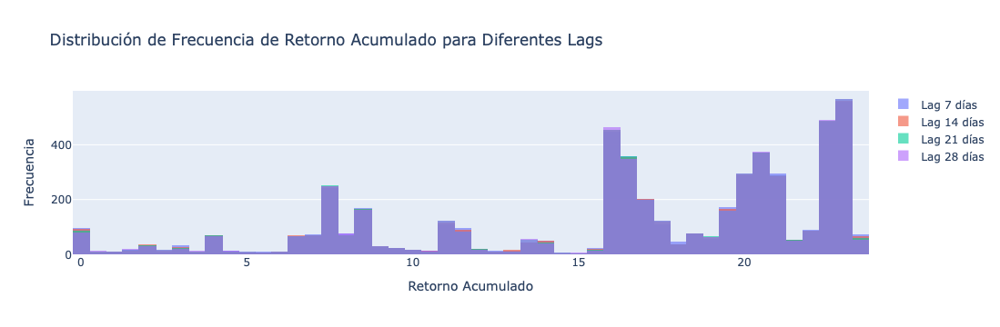

In [340]:
import plotly.express as px
import plotly.graph_objects as go

# Definir lags (ventanas móviles)
lags = [7, 14, 21, 28]

# Crear un gráfico para cada ventana móvil
fig = go.Figure()

for lag in lags:
    fig.add_trace(go.Histogram(
        x=df_1_st['A_t'].rolling(window=lag).mean(),
        name=f'Lag {lag} días',
        opacity=0.6,
        nbinsx=50
    ))

# Ajustar el diseño del gráfico
fig.update_layout(
    title='Distribución de Frecuencia de Retorno Acumulado para Diferentes Lags',
    xaxis_title='Retorno Acumulado',
    yaxis_title='Frecuencia',
    barmode='overlay',  # Para que se superpongan las distribuciones
    showlegend=True
)

# Mostrar el gráfico
fig.show()



El gráfico muestra la **distribución de frecuencias** del retorno acumulado para diferentes lags (7, 14, 21 y 28 días). Se observa que para los lags de 14 y 7 días, hay un mayor número de eventos concentrados en los valores bajos de retorno acumulado, mientras que los lags de 21 y 28 días tienen menor frecuencia en esos mismos rangos. El lag de 14 días destaca por tener una mayor concentración en valores alrededor de 15 y 20, lo que sugiere que los retornos acumulados más grandes tienden a ser más frecuentes con este lag.


### <font color="#30143"> Medias Moviles (Retorno Acumulado) </font>

Para aplicar las medias móviles indicadas a la serie de tiempo del Retorno acumulado de BTC-USD, y verificar si se logra estacionaridad, seguimos los siguientes pasos:

1. **Cálculo de las Medias Móviles**: Definimos las medias móviles simples $ \hat{M}_t^{(2)}, \hat{M}_t^{(3)}, \hat{M}_t^{(4)} $, y sus respectivas versiones con desplazamiento temporal $ \hat{M}_t^{(2)}(t, t+1), $ etc. Estas se calculan con ventanas móviles de tamaño 2, 3, y 4 días.

2. **Aplicar Medias Móviles al Precio de Cierre (Price)**:
    - $ \hat{M}_t^{(2)} $: media móvil de dos días.
    - $ \hat{M}_t^{(3)} $: media móvil de tres días.
    - $ \hat{M}_t^{(4)} $: media móvil de cuatro días.

3. **Remover la Tendencia**: Para eliminar la tendencia, restamos la media móvil calculada a la serie original del Retorno acumulado. Esto nos permite obtener la serie sin tendencia.
4. **Pruebas de Estacionaridad**: Aplicamos la prueba de **Dickey-Fuller** para verificar si la serie ajustada se vuelve estacionaria. Luego, aplicamos la prueba de **Ljung-Box** para comprobar la independencia de los residuales.



In [344]:
# Importar las librerías necesarias
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox
import numpy as np

# Calcular medias móviles para diferentes ventanas
df_1_st['M_t_2'] = df_1_st['A_t'].rolling(window=2).mean()
df_1_st['M_t_3'] = df_1_st['A_t'].rolling(window=3).mean()
df_1_st['M_t_4'] = df_1_st['A_t'].rolling(window=4).mean()

# Calcular las medias móviles desplazadas
df_1_st['M_t_2_shift'] = df_1_st['A_t'].rolling(window=2).mean().shift(1)
df_1_st['M_t_3_shift'] = df_1_st['A_t'].rolling(window=3).mean().shift(1)
df_1_st['M_t_4_shift'] = df_1_st['A_t'].rolling(window=4).mean().shift(1)

# Eliminar tendencia restando la media móvil a la serie original (Asegúrate de usar df_1_st)
df_1_st['detrended_2'] = df_1_st['A_t'] - df_1_st['M_t_2']
df_1_st['detrended_3'] = df_1_st['A_t'] - df_1_st['M_t_3']
df_1_st['detrended_4'] = df_1_st['A_t'] - df_1_st['M_t_4']

# Función para aplicar la prueba de Dickey-Fuller y Ljung-Box
def apply_stationarity_tests(series):
    # Eliminar los valores nulos antes de aplicar las pruebas
    series_clean = series.dropna()
    
    # Verificar que la serie no esté vacía después de eliminar los NaN
    if series_clean.empty:
        print("La serie es demasiado corta para realizar el test.")
        return
    
    # Prueba de Dickey-Fuller
    result_dickeyfuller = adfuller(series_clean)
    p_value_dickey = result_dickeyfuller[1]
    print(f"Dickey-Fuller p-value: {p_value_dickey}")
    
    # Prueba de Ljung-Box para los residuales
    result_ljungbox = acorr_ljungbox(series_clean, lags=[10], return_df=True)
    p_value_ljungbox = result_ljungbox['lb_pvalue'].iloc[0]
    print(f"Ljung-Box p-value: {p_value_ljungbox}")
    
    return p_value_dickey, p_value_ljungbox

# Aplicar las pruebas para cada una de las series detrendizadas
print("Resultados para Media Móvil de 2 días:")
apply_stationarity_tests(df_1_st['detrended_2'])

print("\nResultados para Media Móvil de 3 días:")
apply_stationarity_tests(df_1_st['detrended_3'])

print("\nResultados para Media Móvil de 4 días:")
apply_stationarity_tests(df_1_st['detrended_4'])


Resultados para Media Móvil de 2 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 1.1778404261407928e-47

Resultados para Media Móvil de 3 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 7.676997200411348e-188

Resultados para Media Móvil de 4 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 0.0


(0.0, 0.0)

Los resultados de las pruebas de Dickey-Fuller y Ljung-Box para las series de precios detrendizadas usando medias móviles de 2, 3 y 4 días indican lo siguiente:

1. **Dickey-Fuller Test**:
   - Para las tres medias móviles (2, 3 y 4 días), el p-valor es 0.0, lo que nos permite rechazar la hipótesis nula de no estacionaridad. Por lo tanto, las series parecen estacionarias después de eliminar la tendencia utilizando las medias móviles.

2. **Ljung-Box Test**:
   - Los p-valores para las pruebas de independencia de los residuales son extremadamente bajos para las medias móviles de 2 y 3 días, lo que indica que los residuales no son independientes y presentan autocorrelación.
   - En el caso de la media móvil de 4 días, el p-valor es 0.0, lo que refuerza la idea de que los residuales no son independientes y hay autocorrelación significativa.

Aunque la serie parece ser estacionaria según el test de Dickey-Fuller, las pruebas de Ljung-Box sugieren que hay autocorrelación en los residuales, lo que indica que no todas las propiedades de estacionaridad están satisfechas.



### <font color="#30143"> Descomposición de la serie temporal (A_t) </font>

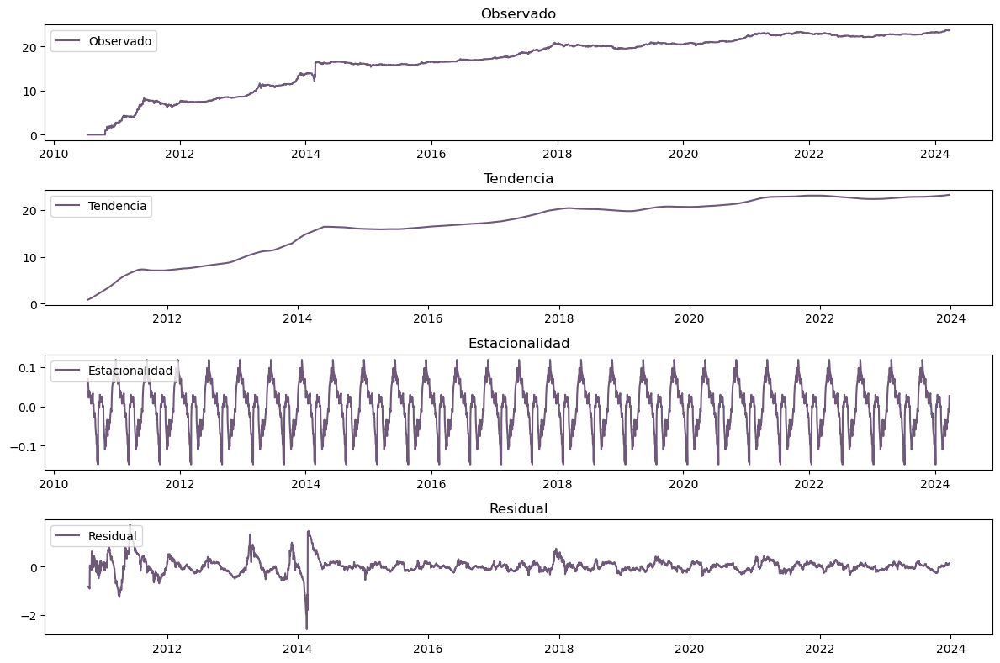

In [347]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

periodo = 180 # Cambia esto según la estacionalidad esperada 24 datos diarios (horario) x 365 días del año

# Realizar la descomposición estacional
decomposition = seasonal_decompose(df_1_st['A_t'], model='aditive', period=periodo)

# Graficar los componentes
plt.figure(figsize=(12, 8))
plt.subplot(411)
plt.plot(df_1_st['A_t'], label='Observado', color='#30143F', alpha=0.7)
plt.title('Observado')
plt.legend(loc='upper left')
plt.subplot(412)
plt.plot(decomposition.trend, label='Tendencia', color='#30143F', alpha=0.7)
plt.title('Tendencia')
plt.legend(loc='upper left')
plt.subplot(413)
plt.plot(decomposition.seasonal, label='Estacionalidad', color='#30143F', alpha=0.7)
plt.title('Estacionalidad')
plt.legend(loc='upper left')
plt.subplot(414)
plt.plot(decomposition.resid, label='Residual', color='#30143F', alpha=0.7)
plt.title('Residual')
plt.legend(loc='upper left')
plt.tight_layout()
plt.show()

El gráfico de descomposición de la serie de tiempo evidencia la  estacionaridad de la misma, ya que los valores  se mantienen constantes a lo largo del tiempo. Los residuales  no presentan una alta variabilidad, lo que sugiere que la varianza  es aparentemente constante constante. Además, el gráfico de tendencia  revela un patrón claro, lo que indica la facilidad de capturar dicha tendencia de manera precisa.

#### <font color="#30143"> Estacionaridad </font>

<div class="alert alert-block" style="background-color: #e1d9e3; color: #30143; padding: 10px; border-radius: 10px;">
    <i class="fa fa-info-circle" aria-hidden="true"></i>
    <strong>Importante:</strong>
    Una serie de tiempo se considera <strong><em>No estacionaria</em></strong> si la distribución de sus datos (media, varianza, autocorrelación, etc.) <em>no permanece constante a lo largo del tiempo</em>, es decir, si  muestra <em>tendencia, variación en la varianza, autocorrelación significativa</em>. 
</div>

* **Prueba de Dickey-Fuller**

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [353]:
result_dickeyfullerat = adfuller(df_1_st.A_t)
dickeyfuller_at = result_dickeyfullerat[1]

print('ADF Statistic: %f' % result_dickeyfullerat[0])
print('p-value: %f' % result_dickeyfullerat[1])

# Evaluar resultados del test
if dickeyfuller_at > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -3.920802
p-value: 0.001887
Se rechaza H0: La serie de tiempo es estacionaria


* **Prueba de Ljung-Box**

De igual forma, podemos de validar si los residuales son independiente o no al aplicar la prueba de `Ljung-Box`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{Los residuales son independientes (No correlacionados)}$$
$$ H_1 : \text{Los residuales no son independientes (Hay autocorrelación en los residuales)}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que hay suficiente evidencia estadística para afirmar que la serie es estacionaria y los residuales son independientes.

In [356]:
ljungbox_resultat = acorr_ljungbox(residuals_A_t, lags=[10], return_df=True)
print('LB Statistic: %f' % ljungbox_result['lb_stat'].iloc[0])
print('p-value: %f' % ljungbox_result['lb_pvalue'].iloc[0])


# Pruebas de independencia y normalidad
ljungbox_resultat = acorr_ljungbox(residuals_A_t, lags=[10], return_df=True)
jung_box_pvalat = ljungbox_resultat['lb_pvalue'].iloc[0]

# Evaluar resultados del test
if jung_box_pvalat > 0.05:
    print('No se rechaza H0: los residuales son independientes (no correlacionados)')
else:
    print('Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)')

LB Statistic: 48206.158615
p-value: 0.000000
Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)


## <font color="#30143">Análisis Exploratorio de series de tiempo Volatilidad 7 dias </font>

### <font color="#30143">  Gráficos Subserie Estacional </font>

In [359]:
residuals_vol7 = np.array(df_1_st['Volatilidad_7']) - trend_model.predict(np.arange(df_1_st.shape[0]).reshape((-1,1)))
df_1_st['Residuals_vol7'] = residuals_vol7

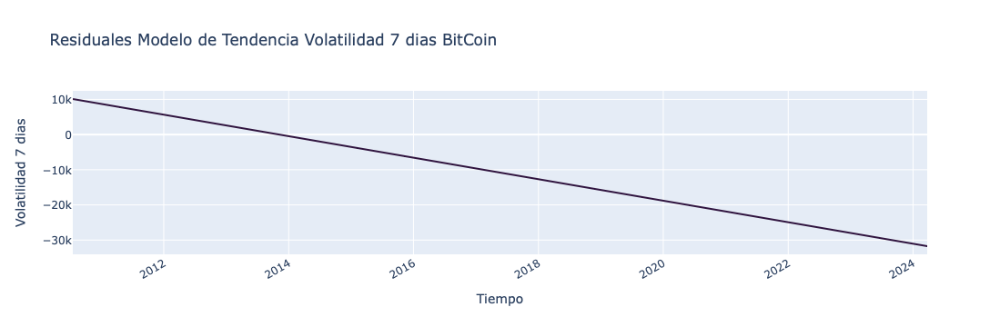

In [360]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=df_1_st.index,
    y=residuals_vol7,
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales de Volatilidad 7 dias'
))

fig.update_layout(
    title='Residuales Modelo de Tendencia Volatilidad 7 dias BitCoin',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 7 dias',
    xaxis_tickangle=-30)


fig.show()


Los residuales del modelo de tendencia general de la volatilidad 7 dias describen una tendencia decreciente en el tiempo. 

#### <font color="#30143"> Agrupación de datos semanales </font>

In [363]:
seasonal_sub_series_data_week_r = df_1_st.groupby(by=['Year', 'week'])['Residuals_vol7'].aggregate([np.mean, np.std])
seasonal_sub_series_data_week_r.columns = ['week_mean', 'week_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `week_map`

In [365]:
seasonal_sub_series_data_week_r.reset_index(inplace=True)
seasonal_sub_series_data_week_r.index = seasonal_sub_series_data_week_r['Year'].astype(str) + '-' + seasonal_sub_series_data_week_r['week']
seasonal_sub_series_data_week_r

,Year,week,week_mean,week_sd
2010-S1,2010,S1,9456.1051,366.7208
2010-S2,2010,S2,9397.4914,366.7497
2010-S3,2010,S3,9416.7828,418.0830
2010-S4,2010,S4,9408.9627,443.0739
2010-S5,2010,S5,9384.5718,467.0003
...,...,...,...,...
2024-S1,2024,S1,-31319.4640,210.8813
2024-S2,2024,S2,-31378.0721,210.8902
2024-S3,2024,S3,-31436.6794,210.8812
2024-S4,2024,S4,-31433.8892,185.8445


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = semanal. 

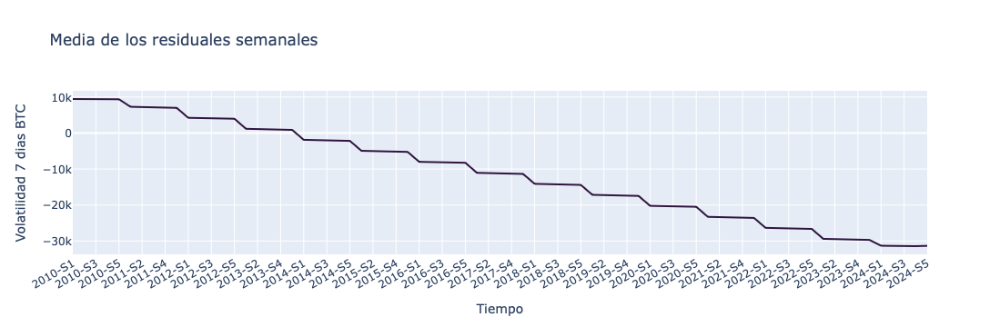

In [367]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 7 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento estacional, lo que significa que se observan variaciones repetitivas y periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios siguen un patrón predecible a lo largo del tiempo.

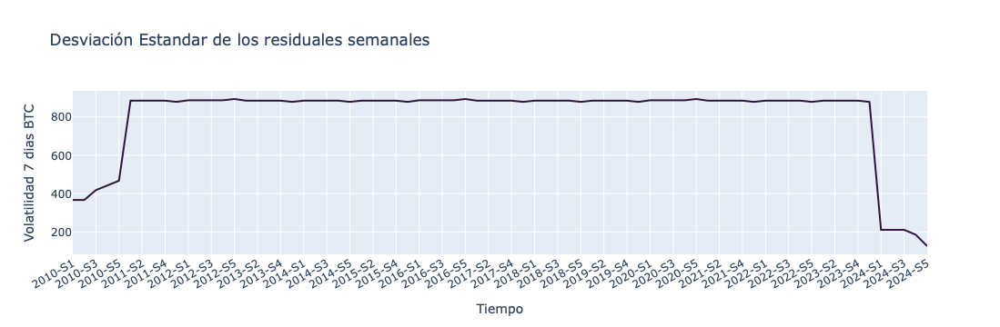

In [369]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 7 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del retorno acumulado del Bitcoin refleja  poca variabilidad, lo que sugiere que no existen fluctuaciones y presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones son predecibles y periódicas.

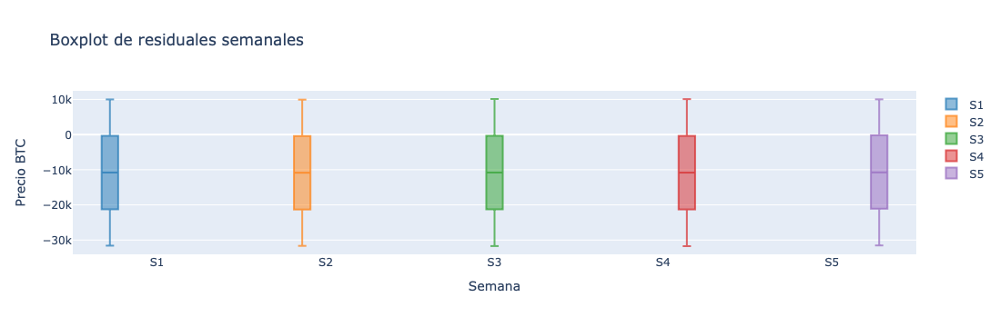

In [371]:
color_semana = {
    'S1': 'rgba(31, 119, 180, 0.7)',
    'S2': 'rgba(255, 127, 14, 0.7)',
    'S3': 'rgba(44, 160, 44, 0.7)',
    'S4': 'rgba(214, 39, 40, 0.7)',
    'S5': 'rgba(148, 103, 189, 0.7)',
    'S6': 'rgba(227, 119, 194, 0.7)'
}

fig = go.Figure()

# Agrupar por semana y añadir trazas de boxplot
for week, color in color_semana.items():
    week_data = df_1_st[df_1_st['week'] == week]
    fig.add_trace(go.Box(
        y=week_data['Residuals_vol7'],
        name=week,
        marker_color=color
    ))

# Configurar el diseño del gráfico
fig.update_layout(
    title='Boxplot de residuales semanales',
    xaxis_title='Semana',
    yaxis_title='Precio BTC',
    boxmode='group'  # Agrupa los boxplots
)

fig.show()


El gráfico de subseries estacionales refleja la tendencia central como la dispersión de los datos estacionales en un lote de unidades temporales, en este caso semanal. Además, la separación entre dos gráficos de caja adyacentes revela las variaciones dentro de la temporada, la cual es nula. 

#### <font color="#30143"> Agrupación de datos Mensual </font>

In [374]:
# Mapa para meses
month_map = {
    1: 'M1', 2: 'M2', 3: 'M3', 4: 'M4', 5: 'M5', 6: 'M6',
    7: 'M7', 8: 'M8', 9: 'M9', 10: 'M10', 11: 'M11', 12: 'M12'
}

# Asignar el mes usando la columna 'Month'
df_1_st['month'] = df_1_st['Month'].map(month_map)

In [375]:
seasonal_sub_series_data_month = df_1_st.groupby(by=['Year', 'month'])['Residuals_vol7'].aggregate([np.mean, np.std])
seasonal_sub_series_data_month.columns = ['month_mean', 'month_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `month_map`

In [377]:
seasonal_sub_series_data_month.reset_index(inplace=True)
seasonal_sub_series_data_month.index = seasonal_sub_series_data_month['Year'].astype(str) + '-' + seasonal_sub_series_data_month['month']
seasonal_sub_series_data_month.head()

,Year,month,month_mean,month_sd
2010-M10,2010,M10,9357.3052,76.0206
2010-M11,2010,M11,9102.0554,73.7392
2010-M12,2010,M12,8846.7260,76.0789
2010-M7,2010,M7,10056.3415,35.0250
2010-M8,2010,M8,9867.9587,76.1244


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = mensual. 

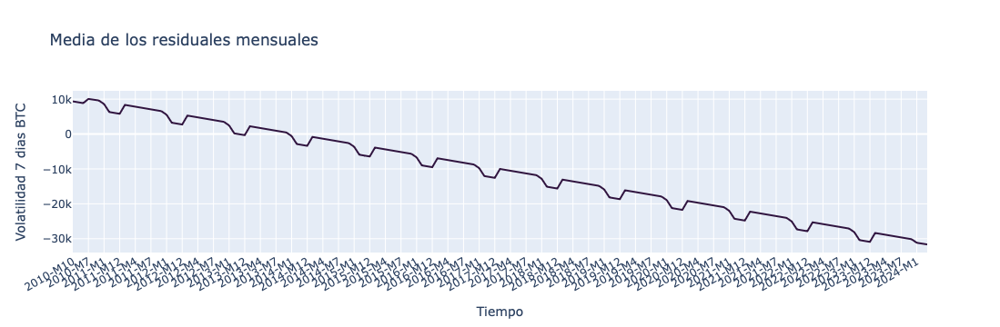

In [379]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 7 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

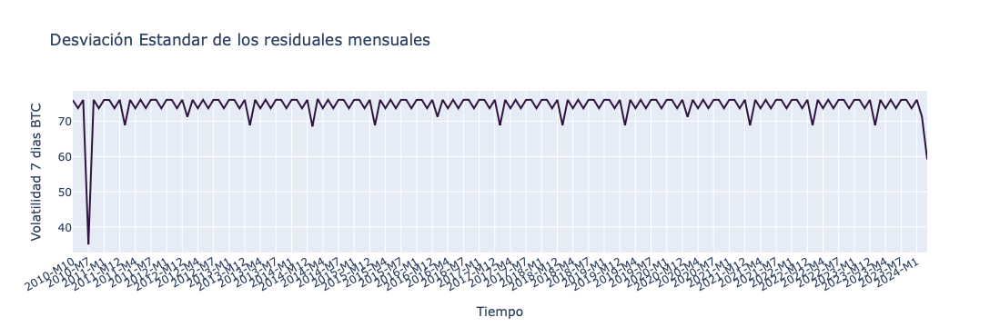

In [381]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 7 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

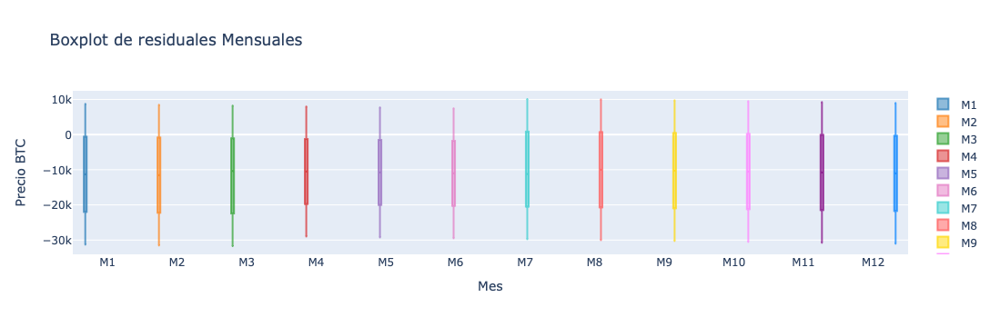

In [383]:
import plotly.graph_objects as go

# Mapa de colores para los meses
color_mes = {
    'M1': 'rgba(31, 119, 180, 0.7)',  
    'M2': 'rgba(255, 127, 14, 0.7)',   
    'M3': 'rgba(44, 160, 44, 0.7)',   
    'M4': 'rgba(214, 39, 40, 0.7)',    
    'M5': 'rgba(148, 103, 189, 0.7)',   
    'M6': 'rgba(227, 119, 194, 0.7)',   
    'M7': 'rgba(51, 204, 204, 0.7)',    
    'M8': 'rgba(255, 85, 85, 0.7)',     
    'M9': 'rgba(255, 215, 0, 0.7)',     
    'M10': 'rgba(255, 127, 255, 0.7)', 
    'M11': 'rgba(128, 0, 128, 0.7)',    
    'M12': 'rgba(0, 128, 255, 0.7)'     
}


fig = go.Figure()


for month, color in color_mes.items():
    month_data = df_1_st[df_1_st['month'] == month]
    fig.add_trace(go.Box(
        y=month_data['Residuals_vol7'],
        name=month,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Mensuales',
    xaxis_title='Mes',
    yaxis_title='Precio BTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales muestra tanto la tendencia central como la dispersión de los datos en un intervalo temporal mensual respecto al precio del Bitcoin. Se observa que la variabilidad de los datos es considerablemente mayor en ciertos períodos. En particular, la comparación entre los gráficos de caja adyacentes revela que durante los meses de abril a octubre, la dispersión de los datos es relativamente menor. En contraste, los meses de noviembre, diciembre y enero presentan una mayor variabilidad. Este aumento en la dispersión se puede atribuir al incremento en la actividad del mercado durante las festividades de Navidad, cuando el flujo de capital es más intenso y las decisiones de inversión tienden a ser más erráticas. 

#### <font color="#30143"> Agrupación de datos Anual </font>

In [386]:
unique_years = df_1_st['Year'].unique()
unique_years

array([2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
       2021, 2022, 2023, 2024], dtype=int32)

In [387]:
# Mapa para year
year_map = {
    2010: '2010', 2011: '2011', 2012: '2012', 2013: '2013', 2014: '2014', 2015: '2015',
    2016: '2016', 2017: '2017', 2018: '2018', 2019: '2019', 2020: '2020', 2021: '2022',
    2023: '2023', 2024:'2024'
}

# Asignar el mes usando la columna 'Month'
df_1_st['year'] = df_1_st['Year'].map(year_map)

In [388]:
seasonal_sub_series_data_year = df_1_st.groupby(by=['Year', 'year'])['Residuals_vol7'].aggregate([np.mean, np.std])
seasonal_sub_series_data_year.columns = ['year_mean', 'year_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `year_map`

In [390]:
seasonal_sub_series_data_year.reset_index(inplace=True)
seasonal_sub_series_data_year.index = seasonal_sub_series_data_year['Year'].astype(str) + '-' + seasonal_sub_series_data_year['year']
seasonal_sub_series_data_year.head()

,Year,year,year_mean,year_sd
2010-2010,2010,2010,9415.9281,404.7476
2011-2011,2011,2011,7188.8172,883.4020
2012-2012,2012,2012,4128.5956,885.8228
2013-2013,2013,2013,1068.4468,883.3806
2014-2014,2014,2014,-1987.5319,883.4395


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = anual. 

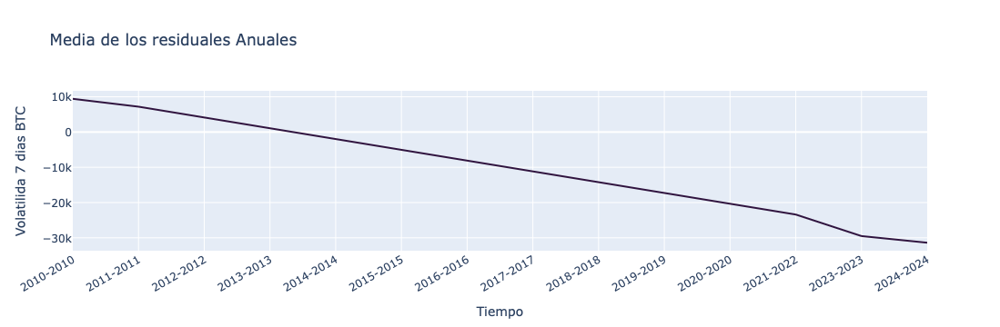

In [392]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales Anuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilida 7 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

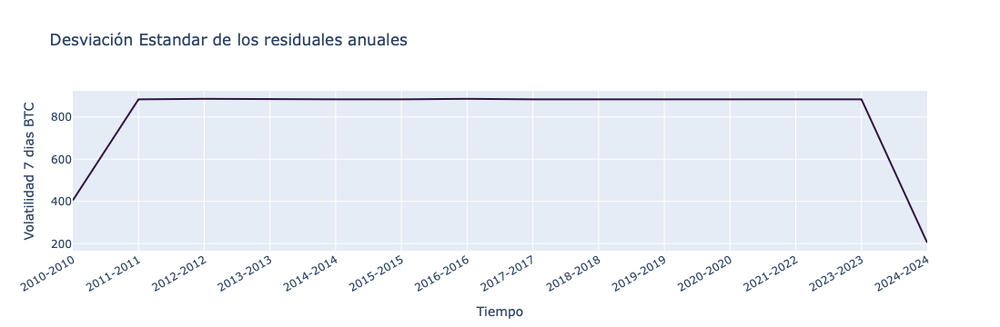

In [394]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales anuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 7 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

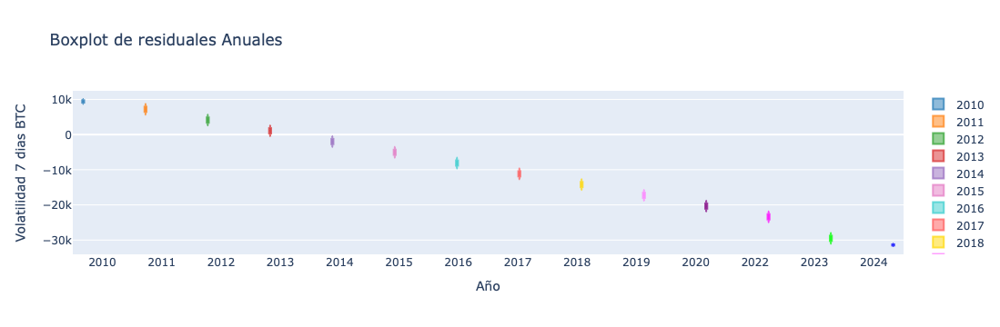

In [396]:
import plotly.graph_objects as go

color_año = {
    '2010': 'rgba(31, 119, 180, 0.7)',  
    '2011': 'rgba(255, 127, 14, 0.7)',   
    '2012': 'rgba(44, 160, 44, 0.7)',   
    '2013': 'rgba(214, 39, 40, 0.7)',    
    '2014': 'rgba(148, 103, 189, 0.7)',   
    '2015': 'rgba(227, 119, 194, 0.7)',   
    '2016': 'rgba(51, 204, 204, 0.7)',    
    '2017': 'rgba(255, 85, 85, 0.7)',     
    '2018': 'rgba(255, 215, 0, 0.7)',     
    '2019': 'rgba(255, 127, 255, 0.7)', 
    '2020': 'rgba(128, 0, 128, 0.7)',    
    '2021': 'rgba(0, 128, 255, 0.7)',     
    '2022': 'rgba(255, 0, 255, 0.7)',    
    '2023': 'rgba(0, 255, 0, 0.7)',      
    '2024': 'rgba(0, 0, 255, 0.7)'       
}


fig = go.Figure()


for year, color in color_año.items():
    year_data = df_1_st[df_1_st['year'] == year]
    fig.add_trace(go.Box(
        y=year_data['Residuals_vol7'],
        name=year,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Anuales',
    xaxis_title='Año',
    yaxis_title='Volatilidad 7 dias BTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales ilustra tanto la tendencia central como la dispersión de los datos mensuales en relación con el precio del Bitcoin. A lo largo de diferentes períodos, se destaca una notable variabilidad en los precios. Desde 2010 hasta 2016, el precio del Bitcoin se mantuvo relativamente estable, pero en 2017 experimentó un aumento significativo, acompañado de una fuerte fluctuación. En 2018, el precio descendió levemente; sin embargo, entre 2020 y 2022, se observó un notable incremento en su valor. El comportamiento del mercado en 2023 fue similar al de 2020, mientras que 2022 mostró patrones que se asemejan a los de 2024, sugiriendo tendencias recurrentes en la evolución del precio del Bitcoin. 

### Eliminación de la tendencia entre la serie y sus rezagos. 

A continuación gráficamos la `Autocorrelación` y `Autocorrelación parcial` de la serie de tiempo asociada con el precio del Bitcoin. 

#### <font color="#30143"> Gráfico Autocorrelación y Autocorrelación Parical  </font>

A continuación se presenta gráfico de autocorrelación y autocorrelación parcial de nuestra serie temporal (Precio).

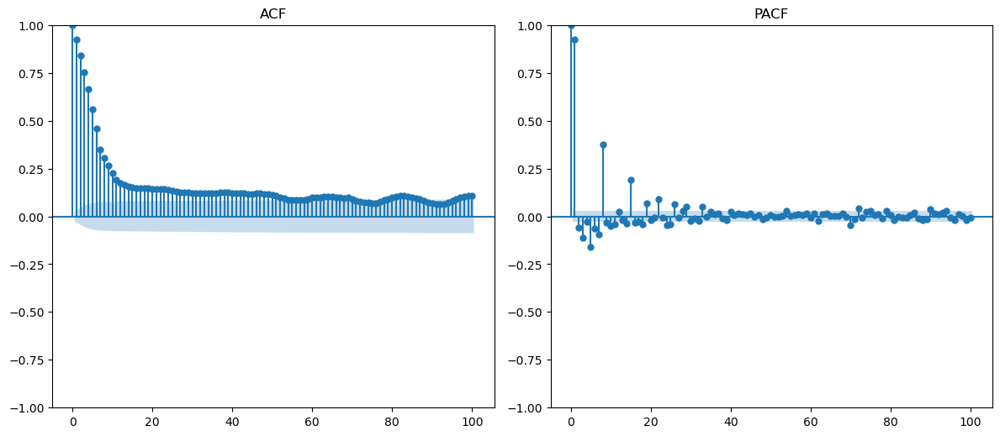

In [402]:
plotds(df_1_st['Volatilidad_7'])

Al examinar el gráfico de `autocorrelación (ACF)`, se observa un decaimiento lento en lugar de uno rápido. Esto indica que las correlaciones entre los valores actuales y sus antecedentes permanecen significativas a lo largo de numerosos rezagos. 
Por otro lado, el gráfico de `autocorrelación parcial (PACF)` sugiere la no existencia de `componentes cíclicos`. Además, la forma de onda observada dentro del intervalo en este gráfico refuerza la idea de estacionaridad. Esto implica que las `propiedades estadísticas de la serie no cambian con el tiempo`.

La eliminación de la tendencia y de la correlación entre la serie y sus rezagos puede hacerse por diferenciación.

##### Diferenciación de 1er Orden: 

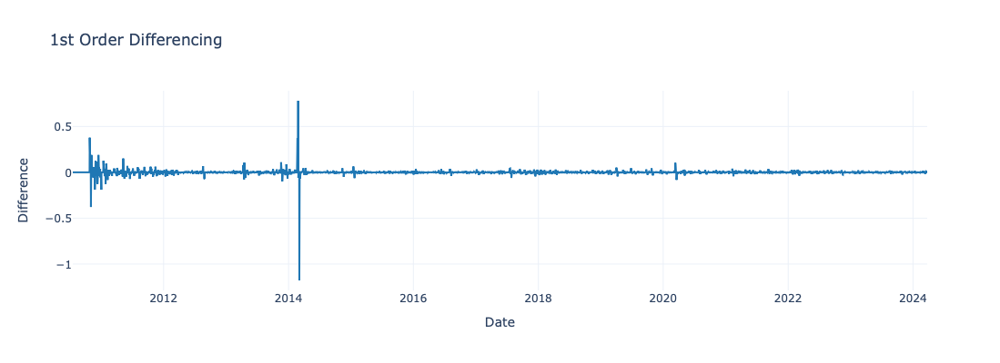

<Figure size 1000x500 with 0 Axes>

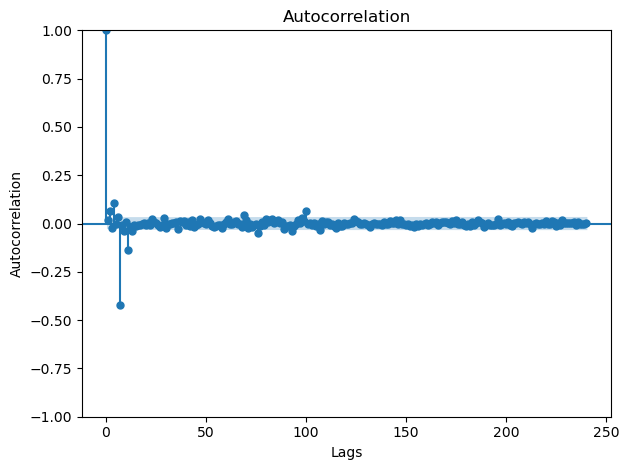

In [406]:
diff_vol7 = df_1_st.Volatilidad_7.diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_vol7.index, y=diff_vol7, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='1st Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_vol7, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()

Luego de aplicar una diferenciación de 1er orden, procedemos aplicar nuevamente la prueba de `Dickey-Fuller` para validar si nuestra serie de tiempo es estacionaria.

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [409]:
resultat1 = adfuller(df_1_st.Volatilidad_7.diff().dropna())
dickeyfuller_at1 = resultat1[1]
print('ADF Statistic: %f' % resultat1[0])
print('p-value: %f' % resultat1[1])

# Evaluar resultados del test
if dickeyfuller_at1 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -18.949829
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


##### Diferenciación de 2do Orden: 

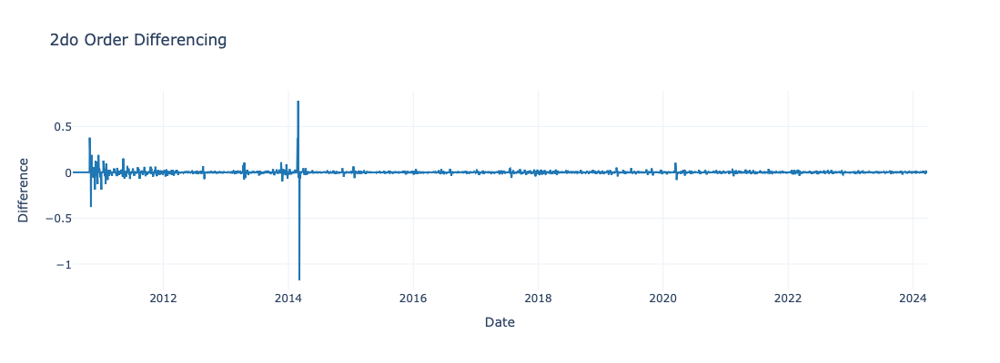

<Figure size 1000x500 with 0 Axes>

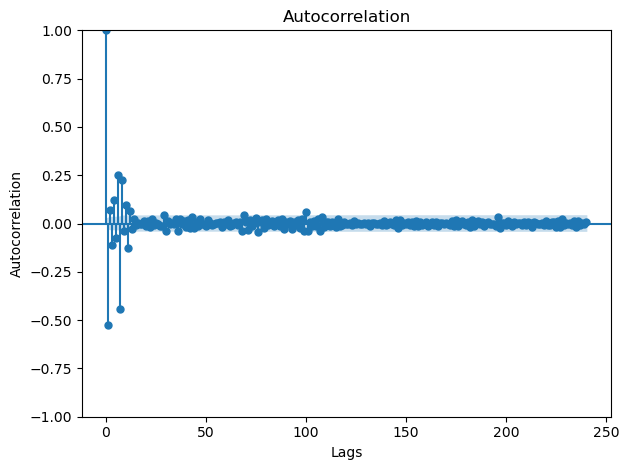

In [411]:
diff_price2 = df_1_st.Volatilidad_7.diff().diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_price2.index, y=diff_vol7, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='2do Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_price2, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()


In [412]:
resultat2 = adfuller(df_1_st.Volatilidad_7.diff().diff().dropna())
dickeyfuller_at2 = resultat2[1]
print('ADF Statistic: %f' % result2[0])
print('p-value: %f' % result2[1])

# Evaluar resultados del test
if dickeyfuller_at2 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -22.671517
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


De acuerdo al resultado obtenido con la prueba de `Dickey-Fuller` con P-value $<0.00000$, por tanto no se rechaza la hipótesis nula con una significancia $\alpha = 0.05$, es decir que `la serie de tiempo es no estacionaria`. Sin embargo al momento de análizar el gráfico de autocorrelación para la 2da diferenciación, el retraso entra en el zona negativa muy distante de nuestro limite de tolerancia, lo que indica que la serie podría haber sido sobrediferenciada. 

Por lo tanto, `vamos a fijar el orden de diferenciación como 1`, es decir,  $ d = 1$ . 


### <font color="#30143"> Agregacion por grupos (A_T) </font>

Primero, vamos a agregar los datos por semanas, días y meses, y calcular las estadísticas de media y desviación estándar. Usamos `pandas` para la agregación:

In [416]:
# Asegurándonos de que la fecha esté en el índice


# Agregación semanal
weekly_stats = df_1_st['Volatilidad_7'].resample('W').agg(['mean', 'std']).rename(columns={'mean': 'Weekly Mean', 'std': 'Weekly Std'})

# Agregación diaria
daily_stats = df_1_st['Volatilidad_7'].resample('D').agg(['mean', 'std']).rename(columns={'mean': 'Daily Mean', 'std': 'Daily Std'})

# Agregación mensual
monthly_stats = df_1_st['Volatilidad_7'].resample('M').agg(['mean', 'std']).rename(columns={'mean': 'Monthly Mean', 'std': 'Monthly Std'})


Para calcular los estadísticos móviles (media y desviación estándar móviles), podemos usar ventanas móviles para `Volatilidad 7 dias`. A continuación, calcularemos las medias móviles y desviaciones móviles:

In [418]:
# Definir ventanas móviles (lags)
window_sizes = [7, 14, 21, 28]

# Crear DataFrame vacío para almacenar las estadísticas móviles
moving_stats = pd.DataFrame(index=df_1_st.index)

# Calcular estadísticas móviles para cada ventana
for window in window_sizes:
    moving_stats[f'Moving Mean ({window} days)'] = df_1_st['Volatilidad_7'].rolling(window=window).mean()
    moving_stats[f'Moving Std ({window} days)'] = df_1_st['Volatilidad_7'].rolling(window=window).std()

# Mostrar las estadísticas móviles
moving_stats.tail()


,Moving Mean (7 days),Moving Std (7 days),Moving Mean (14 days),Moving Std (14 days),Moving Mean (21 days),Moving Std (21 days),Moving Mean (28 days),Moving Std (28 days)
Date,,,,,,,,
2024-03-20,0.0375,0.0128,0.0365,0.0121,0.0388,0.0109,0.0337,0.0141
2024-03-21,0.0431,0.0135,0.0377,0.0137,0.0398,0.0119,0.0356,0.0141
2024-03-22,0.0482,0.0125,0.0389,0.0150,0.0409,0.0128,0.0375,0.0140
2024-03-23,0.0514,0.0113,0.0399,0.0158,0.0417,0.0133,0.0391,0.0135
2024-03-24,0.0539,0.0103,0.0409,0.0164,0.0426,0.0137,0.0408,0.0127


Finalmente, para la parte de la distribución de frecuencias, podemos usar un histograma para visualizar la distribución de la variable `Volatilidad 7 dias` y cómo cambia con diferentes lags:

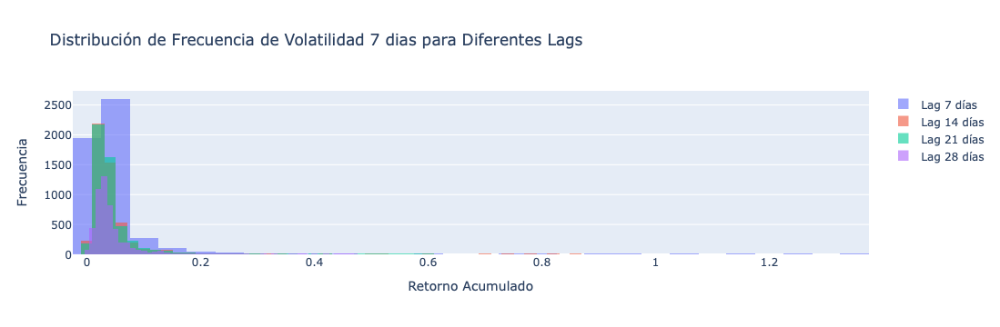

In [420]:
import plotly.express as px
import plotly.graph_objects as go

# Definir lags (ventanas móviles)
lags = [7, 14, 21, 28]

# Crear un gráfico para cada ventana móvil
fig = go.Figure()

for lag in lags:
    fig.add_trace(go.Histogram(
        x=df_1_st['Volatilidad_7'].rolling(window=lag).mean(),
        name=f'Lag {lag} días',
        opacity=0.6,
        nbinsx=50
    ))

# Ajustar el diseño del gráfico
fig.update_layout(
    title='Distribución de Frecuencia de Volatilidad 7 dias para Diferentes Lags',
    xaxis_title='Retorno Acumulado',
    yaxis_title='Frecuencia',
    barmode='overlay',  # Para que se superpongan las distribuciones
    showlegend=True
)

# Mostrar el gráfico
fig.show()



La distribución de la volatilidad acumulada a 7 días para diferentes lags muestra que la mayoría de los eventos se concentran en valores bajos, indicando una volatilidad generalmente baja en los periodos analizados. Los lags más cortos, como los de 7 y 14 días, capturan con mayor precisión estos periodos de baja volatilidad, mientras que en lags más largos (21 y 28 días) se observa una menor frecuencia en los valores bajos. Además, hay algunos eventos aislados de mayor volatilidad, lo que refleja episodios esporádicos de cambios significativos en el precio del Bitcoin.


### <font color="#30143"> Medias Moviles (Volatilida 7 dias) </font>

Para aplicar las medias móviles indicadas a la serie de tiempo del Retorno acumulado de BTC-USD, y verificar si se logra estacionaridad, seguimos los siguientes pasos:

1. **Cálculo de las Medias Móviles**: Definimos las medias móviles simples $ \hat{M}_t^{(2)}, \hat{M}_t^{(3)}, \hat{M}_t^{(4)} $, y sus respectivas versiones con desplazamiento temporal $ \hat{M}_t^{(2)}(t, t+1), $ etc. Estas se calculan con ventanas móviles de tamaño 2, 3, y 4 días.

2. **Aplicar Medias Móviles al Precio de Cierre (Price)**:
    - $ \hat{M}_t^{(2)} $: media móvil de dos días.
    - $ \hat{M}_t^{(3)} $: media móvil de tres días.
    - $ \hat{M}_t^{(4)} $: media móvil de cuatro días.

3. **Remover la Tendencia**: Para eliminar la tendencia, restamos la media móvil calculada a la serie original del Retorno acumulado. Esto nos permite obtener la serie sin tendencia.
4. **Pruebas de Estacionaridad**: Aplicamos la prueba de **Dickey-Fuller** para verificar si la serie ajustada se vuelve estacionaria. Luego, aplicamos la prueba de **Ljung-Box** para comprobar la independencia de los residuales.



In [424]:
# Importar las librerías necesarias
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox
import numpy as np

# Calcular medias móviles para diferentes ventanas
df_1_st['M_t_2'] = df_1_st['Volatilidad_7'].rolling(window=2).mean()
df_1_st['M_t_3'] = df_1_st['Volatilidad_7'].rolling(window=3).mean()
df_1_st['M_t_4'] = df_1_st['Volatilidad_7'].rolling(window=4).mean()

# Calcular las medias móviles desplazadas
df_1_st['M_t_2_shift'] = df_1_st['Volatilidad_7'].rolling(window=2).mean().shift(1)
df_1_st['M_t_3_shift'] = df_1_st['Volatilidad_7'].rolling(window=3).mean().shift(1)
df_1_st['M_t_4_shift'] = df_1_st['Volatilidad_7'].rolling(window=4).mean().shift(1)

# Eliminar tendencia restando la media móvil a la serie original (Asegúrate de usar df_1_st)
df_1_st['detrended_2'] = df_1_st['Volatilidad_7'] - df_1_st['M_t_2']
df_1_st['detrended_3'] = df_1_st['Volatilidad_7'] - df_1_st['M_t_3']
df_1_st['detrended_4'] = df_1_st['Volatilidad_7'] - df_1_st['M_t_4']

# Función para aplicar la prueba de Dickey-Fuller y Ljung-Box
def apply_stationarity_tests(series):
    # Eliminar los valores nulos antes de aplicar las pruebas
    series_clean = series.dropna()
    
    # Verificar que la serie no esté vacía después de eliminar los NaN
    if series_clean.empty:
        print("La serie es demasiado corta para realizar el test.")
        return
    
    # Prueba de Dickey-Fuller
    result_dickeyfuller = adfuller(series_clean)
    p_value_dickey = result_dickeyfuller[1]
    print(f"Dickey-Fuller p-value: {p_value_dickey}")
    
    # Prueba de Ljung-Box para los residuales
    result_ljungbox = acorr_ljungbox(series_clean, lags=[10], return_df=True)
    p_value_ljungbox = result_ljungbox['lb_pvalue'].iloc[0]
    print(f"Ljung-Box p-value: {p_value_ljungbox}")
    
    return p_value_dickey, p_value_ljungbox

# Aplicar las pruebas para cada una de las series detrendizadas
print("Resultados para Media Móvil de 2 días:")
apply_stationarity_tests(df_1_st['detrended_2'])

print("\nResultados para Media Móvil de 3 días:")
apply_stationarity_tests(df_1_st['detrended_3'])

print("\nResultados para Media Móvil de 4 días:")
apply_stationarity_tests(df_1_st['detrended_4'])


Resultados para Media Móvil de 2 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 2.1134587529316915e-206

Resultados para Media Móvil de 3 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 0.0

Resultados para Media Móvil de 4 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 0.0


(0.0, 0.0)

Los resultados de las pruebas de Dickey-Fuller y Ljung-Box para la volatilidad de 7 días usando medias móviles de 2, 3 y 4 días indican lo siguiente:

1. **Dickey-Fuller Test**:
   - Para las tres medias móviles (2, 3 y 4 días), el p-valor es 0.0, lo que nos permite rechazar la hipótesis nula de no estacionaridad. Por lo tanto, las series parecen estacionarias después de aplicar las medias móviles.

2. **Ljung-Box Test**:
   - Los p-valores para las pruebas de independencia de los residuales son extremadamente bajos, especialmente en el caso de la media móvil de 2 días (2.11e-206), lo que sugiere que los residuales no son independientes y presentan autocorrelación significativa.
   - Para las medias móviles de 3 y 4 días, el p-valor es 0.0, lo que refuerza la autocorrelación en los residuales.

Aunque las series parecen ser estacionarias según el test de Dickey-Fuller, las pruebas de Ljung-Box indican que persiste una fuerte autocorrelación en los residuales, lo cual sugiere que la serie no cumple completamente con las propiedades de estacionaridad.




### <font color="#30143"> Descomposición de la serie temporal (Volatilidad 7 dias) </font>

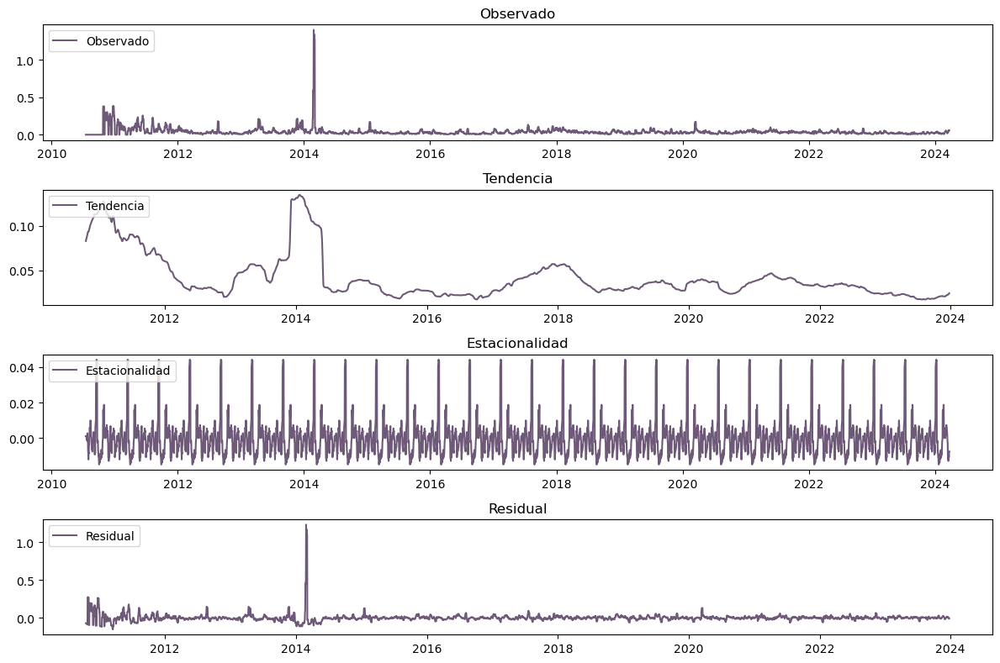

In [427]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

periodo = 180 # Cambia esto según la estacionalidad esperada 24 datos diarios (horario) x 365 días del año

# Realizar la descomposición estacional
decomposition = seasonal_decompose(df_1_st['Volatilidad_7'], model='aditive', period=periodo)

# Graficar los componentes
plt.figure(figsize=(12, 8))
plt.subplot(411)
plt.plot(df_1_st['Volatilidad_7'], label='Observado', color='#30143F', alpha=0.7)
plt.title('Observado')
plt.legend(loc='upper left')
plt.subplot(412)
plt.plot(decomposition.trend, label='Tendencia', color='#30143F', alpha=0.7)
plt.title('Tendencia')
plt.legend(loc='upper left')
plt.subplot(413)
plt.plot(decomposition.seasonal, label='Estacionalidad', color='#30143F', alpha=0.7)
plt.title('Estacionalidad')
plt.legend(loc='upper left')
plt.subplot(414)
plt.plot(decomposition.resid, label='Residual', color='#30143F', alpha=0.7)
plt.title('Residual')
plt.legend(loc='upper left')
plt.tight_layout()
plt.show()

El análisis de la volatilidad a 7 días muestra que, aunque la volatilidad general se ha mantenido baja en la mayor parte del tiempo, existen algunos picos notables, especialmente entre 2013 y 2014. La tendencia indica una disminución gradual en la volatilidad a largo plazo, mientras que la componente estacional sugiere un patrón repetitivo en el tiempo. Sin embargo, los residuales evidencian algunos eventos de volatilidad no explicados completamente por la estacionalidad o la tendencia, lo que destaca la naturaleza impredecible de ciertos periodos en la serie.

#### <font color="#30143"> Estacionaridad </font>

<div class="alert alert-block" style="background-color: #e1d9e3; color: #30143; padding: 10px; border-radius: 10px;">
    <i class="fa fa-info-circle" aria-hidden="true"></i>
    <strong>Importante:</strong>
    Una serie de tiempo se considera <strong><em>No estacionaria</em></strong> si la distribución de sus datos (media, varianza, autocorrelación, etc.) <em>no permanece constante a lo largo del tiempo</em>, es decir, si  muestra <em>tendencia, variación en la varianza, autocorrelación significativa</em>. 
</div>

* **Prueba de Dickey-Fuller**

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [433]:
result_dickeyfullerat = adfuller(df_1_st.Volatilidad_7)
dickeyfuller_at = result_dickeyfullerat[1]

print('ADF Statistic: %f' % result_dickeyfullerat[0])
print('p-value: %f' % result_dickeyfullerat[1])

# Evaluar resultados del test
if dickeyfuller_at > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -8.611600
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


* **Prueba de Ljung-Box**

De igual forma, podemos de validar si los residuales son independiente o no al aplicar la prueba de `Ljung-Box`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{Los residuales son independientes (No correlacionados)}$$
$$ H_1 : \text{Los residuales no son independientes (Hay autocorrelación en los residuales)}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que hay suficiente evidencia estadística para afirmar que la serie es estacionaria y los residuales son independientes.

In [436]:
ljungbox_resultat = acorr_ljungbox(residuals_vol7, lags=[10], return_df=True)
print('LB Statistic: %f' % ljungbox_result['lb_stat'].iloc[0])
print('p-value: %f' % ljungbox_result['lb_pvalue'].iloc[0])


# Pruebas de independencia y normalidad
ljungbox_resultat = acorr_ljungbox(residuals_vol7, lags=[10], return_df=True)
jung_box_pvalat = ljungbox_resultat['lb_pvalue'].iloc[0]

# Evaluar resultados del test
if jung_box_pvalat > 0.05:
    print('No se rechaza H0: los residuales son independientes (no correlacionados)')
else:
    print('Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)')

LB Statistic: 48206.158615
p-value: 0.000000
Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)


## <font color="#30143">Análisis Exploratorio de series de tiempo Volatilidad 14 dias </font>

### <font color="#30143">  Gráficos Subserie Estacional </font>

In [439]:
residuals_vol14 = np.array(df_1_st['Volatilidad_14']) - trend_model.predict(np.arange(df_1_st.shape[0]).reshape((-1,1)))
df_1_st['Residuals_vol14'] = residuals_vol14

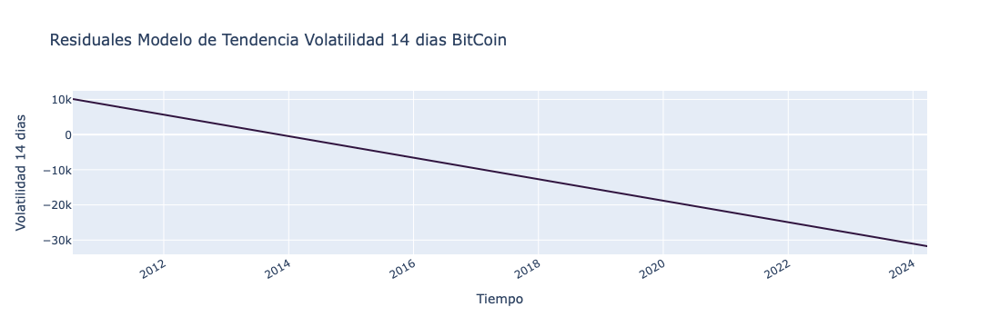

In [440]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=df_1_st.index,
    y=residuals_vol14,
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales de Volatilidad 14 dias'
))

fig.update_layout(
    title='Residuales Modelo de Tendencia Volatilidad 14 dias BitCoin',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 14 dias',
    xaxis_tickangle=-30)


fig.show()


Los residuales del modelo de tendencia general de la volatilidad 14 dias describen una tendencia decreciente en el tiempo. 

#### <font color="#30143"> Agrupación de datos semanales </font>

In [443]:
seasonal_sub_series_data_week_r = df_1_st.groupby(by=['Year', 'week'])['Residuals_vol14'].aggregate([np.mean, np.std])
seasonal_sub_series_data_week_r.columns = ['week_mean', 'week_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `week_map`

In [445]:
seasonal_sub_series_data_week_r.reset_index(inplace=True)
seasonal_sub_series_data_week_r.index = seasonal_sub_series_data_week_r['Year'].astype(str) + '-' + seasonal_sub_series_data_week_r['week']
seasonal_sub_series_data_week_r

,Year,week,week_mean,week_sd
2010-S1,2010,S1,9456.1204,366.7180
2010-S2,2010,S2,9397.5043,366.7238
2010-S3,2010,S3,9416.7780,418.0918
2010-S4,2010,S4,9408.9625,443.0744
2010-S5,2010,S5,9384.5693,466.9836
...,...,...,...,...
2024-S1,2024,S1,-31319.4660,210.8820
2024-S2,2024,S2,-31378.0713,210.8853
2024-S3,2024,S3,-31436.6784,210.8851
2024-S4,2024,S4,-31433.8906,185.8486


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = semanal. 

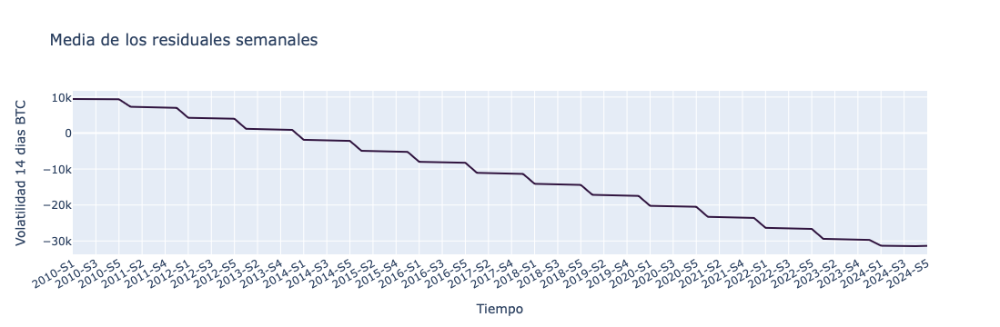

In [447]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 14 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento estacional, lo que significa que se observan variaciones repetitivas y periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios siguen un patrón predecible a lo largo del tiempo.

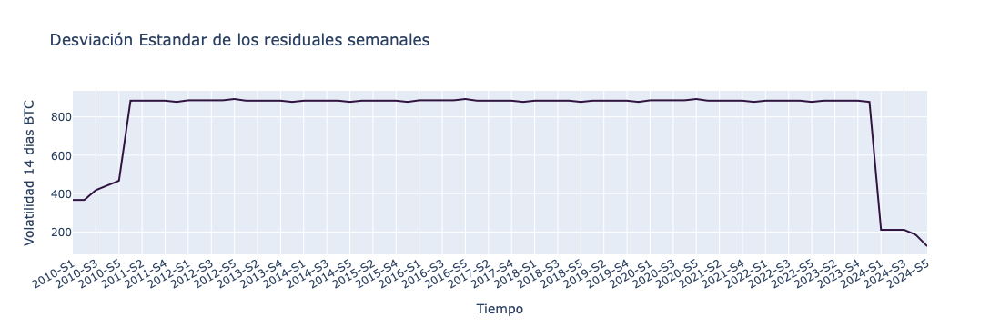

In [449]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 14 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del retorno acumulado del Bitcoin refleja  poca variabilidad, lo que sugiere que no existen fluctuaciones y presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones son predecibles y periódicas.

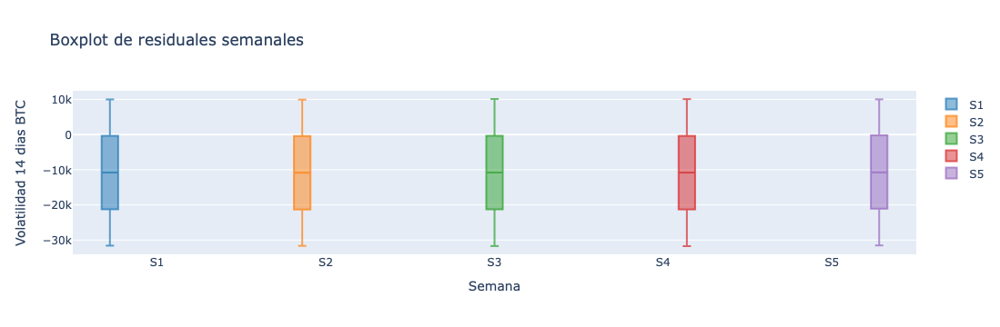

In [451]:
color_semana = {
    'S1': 'rgba(31, 119, 180, 0.7)',
    'S2': 'rgba(255, 127, 14, 0.7)',
    'S3': 'rgba(44, 160, 44, 0.7)',
    'S4': 'rgba(214, 39, 40, 0.7)',
    'S5': 'rgba(148, 103, 189, 0.7)',
    'S6': 'rgba(227, 119, 194, 0.7)'
}

fig = go.Figure()

# Agrupar por semana y añadir trazas de boxplot
for week, color in color_semana.items():
    week_data = df_1_st[df_1_st['week'] == week]
    fig.add_trace(go.Box(
        y=week_data['Residuals_vol14'],
        name=week,
        marker_color=color
    ))

# Configurar el diseño del gráfico
fig.update_layout(
    title='Boxplot de residuales semanales',
    xaxis_title='Semana',
    yaxis_title='Volatilidad 14 dias BTC',
    boxmode='group'  # Agrupa los boxplots
)

fig.show()


El gráfico de subseries estacionales refleja la tendencia central como la dispersión de los datos estacionales en un lote de unidades temporales, en este caso semanal. Además, la separación entre dos gráficos de caja adyacentes revela las variaciones dentro de la temporada, la cual es nula. 

#### <font color="#30143"> Agrupación de datos Mensual </font>

In [454]:
# Mapa para meses
month_map = {
    1: 'M1', 2: 'M2', 3: 'M3', 4: 'M4', 5: 'M5', 6: 'M6',
    7: 'M7', 8: 'M8', 9: 'M9', 10: 'M10', 11: 'M11', 12: 'M12'
}

# Asignar el mes usando la columna 'Month'
df_1_st['month'] = df_1_st['Month'].map(month_map)

In [455]:
seasonal_sub_series_data_month = df_1_st.groupby(by=['Year', 'month'])['Residuals_vol14'].aggregate([np.mean, np.std])
seasonal_sub_series_data_month.columns = ['month_mean', 'month_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `month_map`

In [457]:
seasonal_sub_series_data_month.reset_index(inplace=True)
seasonal_sub_series_data_month.index = seasonal_sub_series_data_month['Year'].astype(str) + '-' + seasonal_sub_series_data_month['month']
seasonal_sub_series_data_month.head()

,Year,month,month_mean,month_sd
2010-M10,2010,M10,9357.2838,76.0510
2010-M11,2010,M11,9102.1056,73.7387
2010-M12,2010,M12,8846.7231,76.0803
2010-M7,2010,M7,10056.3415,35.0250
2010-M8,2010,M8,9867.9587,76.1244


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = mensual. 

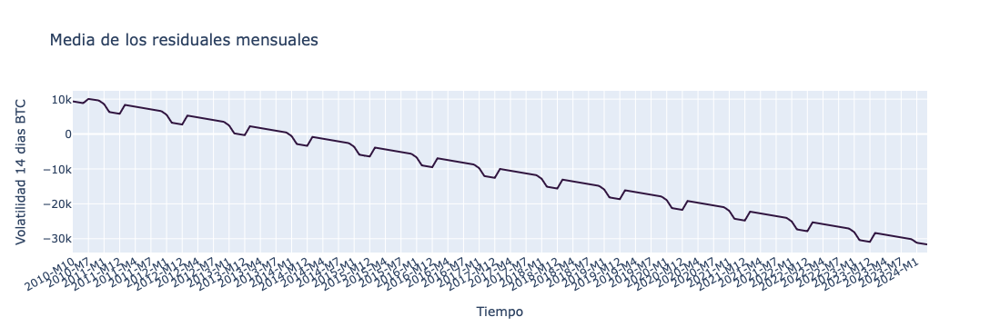

In [459]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 14 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

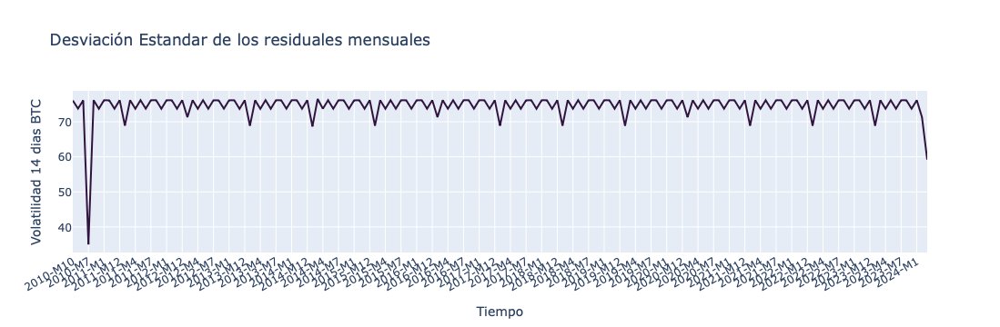

In [461]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 14 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

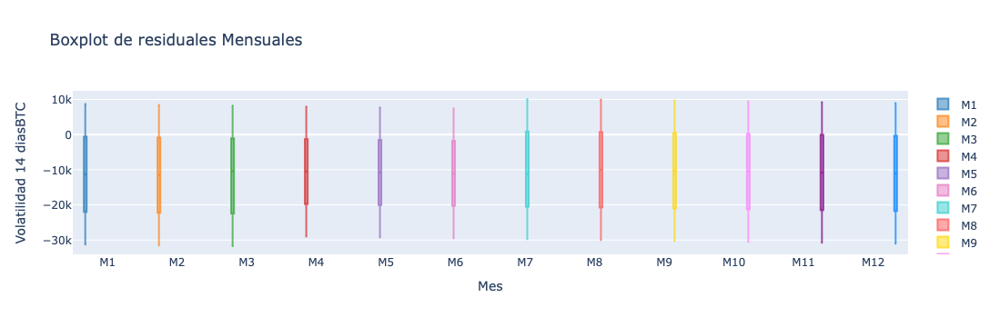

In [463]:
import plotly.graph_objects as go

# Mapa de colores para los meses
color_mes = {
    'M1': 'rgba(31, 119, 180, 0.7)',  
    'M2': 'rgba(255, 127, 14, 0.7)',   
    'M3': 'rgba(44, 160, 44, 0.7)',   
    'M4': 'rgba(214, 39, 40, 0.7)',    
    'M5': 'rgba(148, 103, 189, 0.7)',   
    'M6': 'rgba(227, 119, 194, 0.7)',   
    'M7': 'rgba(51, 204, 204, 0.7)',    
    'M8': 'rgba(255, 85, 85, 0.7)',     
    'M9': 'rgba(255, 215, 0, 0.7)',     
    'M10': 'rgba(255, 127, 255, 0.7)', 
    'M11': 'rgba(128, 0, 128, 0.7)',    
    'M12': 'rgba(0, 128, 255, 0.7)'     
}


fig = go.Figure()


for month, color in color_mes.items():
    month_data = df_1_st[df_1_st['month'] == month]
    fig.add_trace(go.Box(
        y=month_data['Residuals_vol14'],
        name=month,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Mensuales',
    xaxis_title='Mes',
    yaxis_title='Volatilidad 14 diasBTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales muestra tanto la tendencia central como la dispersión de los datos en un intervalo temporal mensual respecto al precio del Bitcoin. Se observa que la variabilidad de los datos es considerablemente mayor en ciertos períodos. En particular, la comparación entre los gráficos de caja adyacentes revela que durante los meses de abril a octubre, la dispersión de los datos es relativamente menor. En contraste, los meses de noviembre, diciembre y enero presentan una mayor variabilidad. Este aumento en la dispersión se puede atribuir al incremento en la actividad del mercado durante las festividades de Navidad, cuando el flujo de capital es más intenso y las decisiones de inversión tienden a ser más erráticas. 

#### <font color="#30143"> Agrupación de datos Anual </font>

In [466]:
unique_years = df_1_st['Year'].unique()
unique_years

array([2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
       2021, 2022, 2023, 2024], dtype=int32)

In [467]:
# Mapa para year
year_map = {
    2010: '2010', 2011: '2011', 2012: '2012', 2013: '2013', 2014: '2014', 2015: '2015',
    2016: '2016', 2017: '2017', 2018: '2018', 2019: '2019', 2020: '2020', 2021: '2022',
    2023: '2023', 2024:'2024'
}

# Asignar el mes usando la columna 'Month'
df_1_st['year'] = df_1_st['Year'].map(year_map)

In [468]:
seasonal_sub_series_data_year = df_1_st.groupby(by=['Year', 'year'])['Residuals_vol14'].aggregate([np.mean, np.std])
seasonal_sub_series_data_year.columns = ['year_mean', 'year_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `year_map`

In [470]:
seasonal_sub_series_data_year.reset_index(inplace=True)
seasonal_sub_series_data_year.index = seasonal_sub_series_data_year['Year'].astype(str) + '-' + seasonal_sub_series_data_year['year']
seasonal_sub_series_data_year.head()

,Year,year,year_mean,year_sd
2010-2010,2010,2010,9415.9326,404.7429
2011-2011,2011,2011,7188.8266,883.4080
2012-2012,2012,2012,4128.5978,885.8225
2013-2013,2013,2013,1068.4492,883.3793
2014-2014,2014,2014,-1987.5217,883.4485


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = anual. 

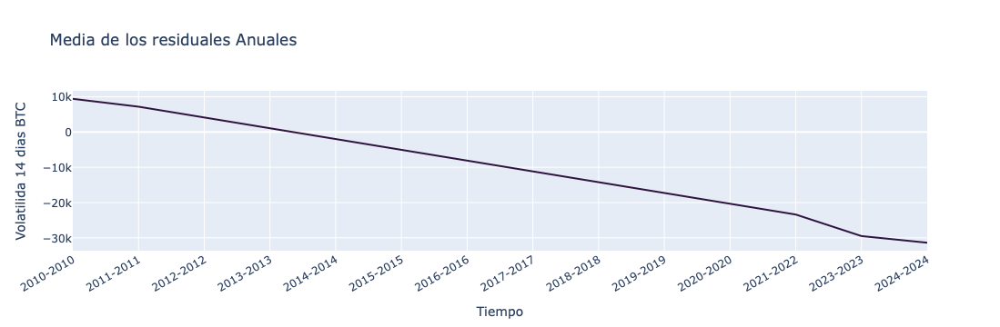

In [472]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales Anuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilida 14 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

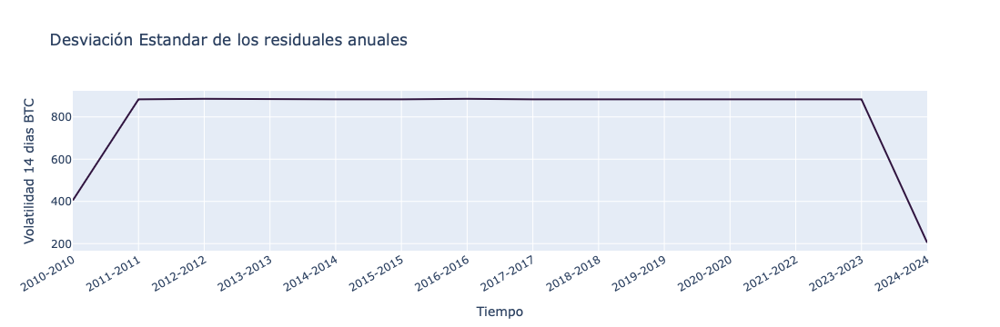

In [474]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales anuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 14 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

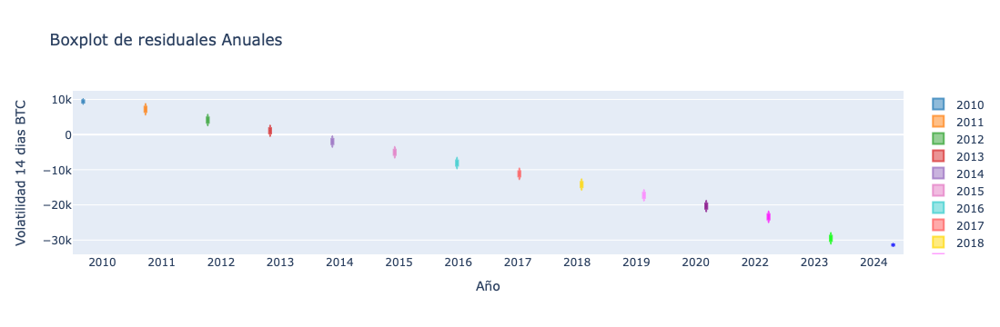

In [476]:
import plotly.graph_objects as go

color_año = {
    '2010': 'rgba(31, 119, 180, 0.7)',  
    '2011': 'rgba(255, 127, 14, 0.7)',   
    '2012': 'rgba(44, 160, 44, 0.7)',   
    '2013': 'rgba(214, 39, 40, 0.7)',    
    '2014': 'rgba(148, 103, 189, 0.7)',   
    '2015': 'rgba(227, 119, 194, 0.7)',   
    '2016': 'rgba(51, 204, 204, 0.7)',    
    '2017': 'rgba(255, 85, 85, 0.7)',     
    '2018': 'rgba(255, 215, 0, 0.7)',     
    '2019': 'rgba(255, 127, 255, 0.7)', 
    '2020': 'rgba(128, 0, 128, 0.7)',    
    '2021': 'rgba(0, 128, 255, 0.7)',     
    '2022': 'rgba(255, 0, 255, 0.7)',    
    '2023': 'rgba(0, 255, 0, 0.7)',      
    '2024': 'rgba(0, 0, 255, 0.7)'       
}


fig = go.Figure()


for year, color in color_año.items():
    year_data = df_1_st[df_1_st['year'] == year]
    fig.add_trace(go.Box(
        y=year_data['Residuals_vol14'],
        name=year,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Anuales',
    xaxis_title='Año',
    yaxis_title='Volatilidad 14 dias BTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales ilustra tanto la tendencia central como la dispersión de los datos mensuales en relación con el precio del Bitcoin. A lo largo de diferentes períodos, se destaca una notable variabilidad en los precios. Desde 2010 hasta 2016, el precio del Bitcoin se mantuvo relativamente estable, pero en 2017 experimentó un aumento significativo, acompañado de una fuerte fluctuación. En 2018, el precio descendió levemente; sin embargo, entre 2020 y 2022, se observó un notable incremento en su valor. El comportamiento del mercado en 2023 fue similar al de 2020, mientras que 2022 mostró patrones que se asemejan a los de 2024, sugiriendo tendencias recurrentes en la evolución del precio del Bitcoin. 

### Eliminación de la tendencia entre la serie y sus rezagos. 

A continuación gráficamos la `Autocorrelación` y `Autocorrelación parcial` de la serie de tiempo asociada con la volatilidad de 7 dias del Bitcoin. 

#### <font color="#30143"> Gráfico Autocorrelación y Autocorrelación Parical  </font>

A continuación se presenta gráfico de autocorrelación y autocorrelación parcial de nuestra serie temporal (Precio).

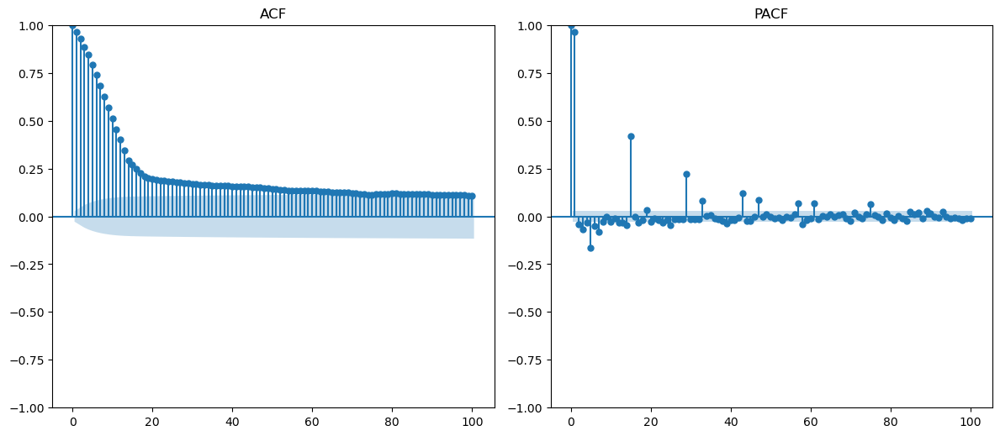

In [482]:
plotds(df_1_st['Volatilidad_14'])

Al examinar el gráfico de `autocorrelación (ACF)`, se observa un decaimiento lento en lugar de uno rápido. Esto indica que las correlaciones entre los valores actuales y sus antecedentes permanecen significativas a lo largo de numerosos rezagos. 
Por otro lado, el gráfico de `autocorrelación parcial (PACF)` sugiere la no existencia de `componentes cíclicos`. Además, la forma de onda observada dentro del intervalo en este gráfico refuerza la idea de estacionaridad. Esto implica que las `propiedades estadísticas de la serie no cambian con el tiempo`.

La eliminación de la tendencia y de la correlación entre la serie y sus rezagos puede hacerse por diferenciación.

##### Diferenciación de 1er Orden: 

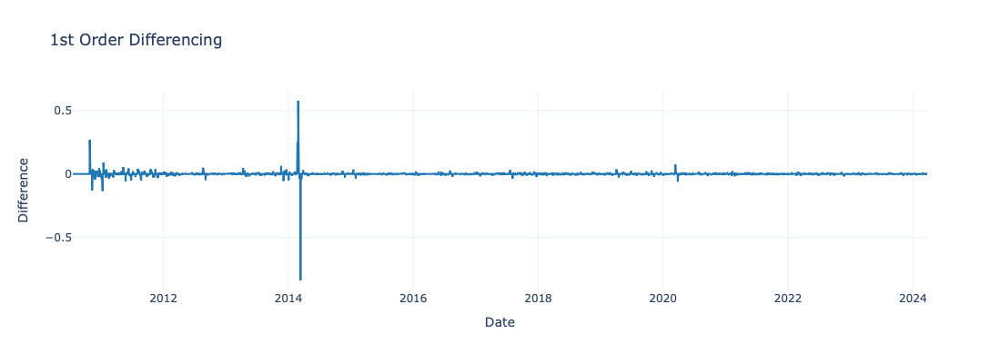

<Figure size 1000x500 with 0 Axes>

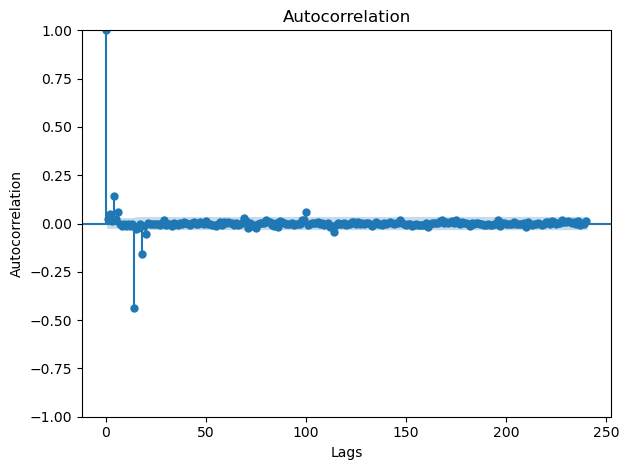

In [486]:
diff_vol14 = df_1_st.Volatilidad_14.diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_vol14.index, y=diff_vol14, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='1st Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_vol14, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()

Luego de aplicar una diferenciación de 1er orden, procedemos aplicar nuevamente la prueba de `Dickey-Fuller` para validar si nuestra serie de tiempo es estacionaria.

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [489]:
resultat1 = adfuller(df_1_st.Volatilidad_14.diff().dropna())
dickeyfuller_at1 = resultat1[1]
print('ADF Statistic: %f' % resultat1[0])
print('p-value: %f' % resultat1[1])

# Evaluar resultados del test
if dickeyfuller_at1 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -19.033257
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


##### Diferenciación de 2do Orden: 

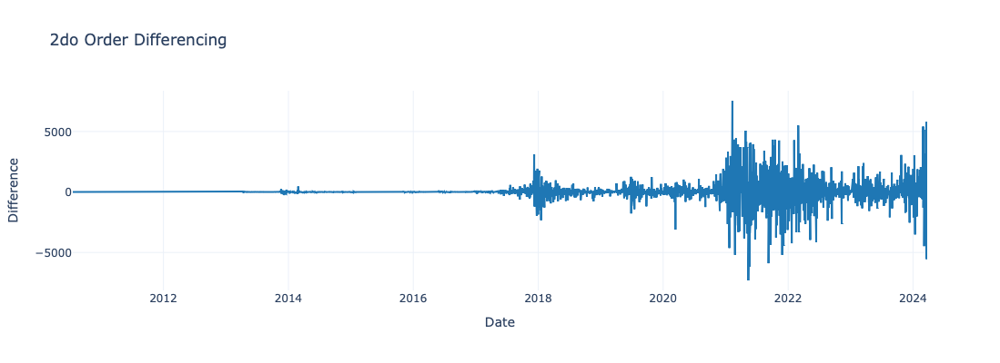

<Figure size 1000x500 with 0 Axes>

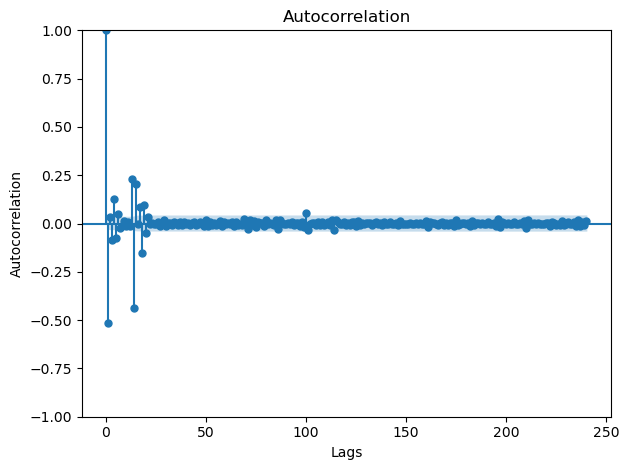

In [491]:
diff_price2 = df_1_st.Volatilidad_14.diff().diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_price2.index, y=diff_price, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='2do Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_price2, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()


In [492]:
resultat2 = adfuller(df_1_st.Volatilidad_14.diff().diff().dropna())
dickeyfuller_at2 = resultat2[1]
print('ADF Statistic: %f' % result2[0])
print('p-value: %f' % result2[1])

# Evaluar resultados del test
if dickeyfuller_at2 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -22.671517
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


De acuerdo al resultado obtenido con la prueba de `Dickey-Fuller` con P-value $<0.00000$, por tanto no se rechaza la hipótesis nula con una significancia $\alpha = 0.05$, es decir que `la serie de tiempo es no estacionaria`. Sin embargo al momento de análizar el gráfico de autocorrelación para la 2da diferenciación, el retraso entra en el zona negativa muy distante de nuestro limite de tolerancia, lo que indica que la serie podría haber sido sobrediferenciada. 

Por lo tanto, `vamos a fijar el orden de diferenciación como 1`, es decir,  $ d = 1$ . 


### <font color="#30143"> Agregacion por grupos (A_T) </font>

Primero, vamos a agregar los datos por semanas, días y meses, y calcular las estadísticas de media y desviación estándar. Usamos `pandas` para la agregación:

In [496]:
# Asegurándonos de que la fecha esté en el índice


# Agregación semanal
weekly_stats = df_1_st['Volatilidad_14'].resample('W').agg(['mean', 'std']).rename(columns={'mean': 'Weekly Mean', 'std': 'Weekly Std'})

# Agregación diaria
daily_stats = df_1_st['Volatilidad_14'].resample('D').agg(['mean', 'std']).rename(columns={'mean': 'Daily Mean', 'std': 'Daily Std'})

# Agregación mensual
monthly_stats = df_1_st['Volatilidad_14'].resample('M').agg(['mean', 'std']).rename(columns={'mean': 'Monthly Mean', 'std': 'Monthly Std'})


Para calcular los estadísticos móviles (media y desviación estándar móviles), podemos usar ventanas móviles para `Volatilidad 14 dias`. A continuación, calcularemos las medias móviles y desviaciones móviles:

In [498]:
# Definir ventanas móviles (lags)
window_sizes = [7, 14, 21, 28]

# Crear DataFrame vacío para almacenar las estadísticas móviles
moving_stats = pd.DataFrame(index=df_1_st.index)

# Calcular estadísticas móviles para cada ventana
for window in window_sizes:
    moving_stats[f'Moving Mean ({window} days)'] = df_1_st['Volatilidad_14'].rolling(window=window).mean()
    moving_stats[f'Moving Std ({window} days)'] = df_1_st['Volatilidad_14'].rolling(window=window).std()

# Mostrar las estadísticas móviles
moving_stats.tail()


,Moving Mean (7 days),Moving Std (7 days),Moving Mean (14 days),Moving Std (14 days),Moving Mean (21 days),Moving Std (21 days),Moving Mean (28 days),Moving Std (28 days)
Date,,,,,,,,
2024-03-20,0.0381,0.0038,0.0389,0.0033,0.0378,0.0042,0.0333,0.0090
2024-03-21,0.0398,0.0042,0.0392,0.0037,0.0384,0.0043,0.0343,0.0088
2024-03-22,0.0413,0.0041,0.0396,0.0041,0.0391,0.0043,0.0353,0.0083
2024-03-23,0.0422,0.0043,0.0399,0.0044,0.0397,0.0042,0.0364,0.0076
2024-03-24,0.0431,0.0048,0.0404,0.0048,0.0405,0.0041,0.0375,0.0068


Finalmente, para la parte de la distribución de frecuencias, podemos usar un histograma para visualizar la distribución de la variable `Volatilidad 7 dias` y cómo cambia con diferentes lags:

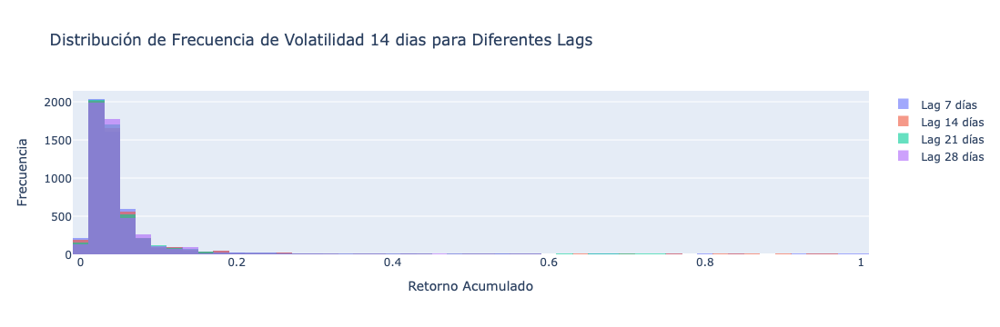

In [500]:
import plotly.express as px
import plotly.graph_objects as go

# Definir lags (ventanas móviles)
lags = [7, 14, 21, 28]

# Crear un gráfico para cada ventana móvil
fig = go.Figure()

for lag in lags:
    fig.add_trace(go.Histogram(
        x=df_1_st['Volatilidad_14'].rolling(window=lag).mean(),
        name=f'Lag {lag} días',
        opacity=0.6,
        nbinsx=50
    ))

# Ajustar el diseño del gráfico
fig.update_layout(
    title='Distribución de Frecuencia de Volatilidad 14 dias para Diferentes Lags',
    xaxis_title='Retorno Acumulado',
    yaxis_title='Frecuencia',
    barmode='overlay',  # Para que se superpongan las distribuciones
    showlegend=True
)

# Mostrar el gráfico
fig.show()



La distribución de la volatilidad acumulada a 7 días para diferentes lags muestra que la mayoría de los eventos se concentran en valores bajos, indicando una volatilidad generalmente baja en los periodos analizados. Los lags más cortos, como los de 7 y 14 días, capturan con mayor precisión estos periodos de baja volatilidad, mientras que en lags más largos (21 y 28 días) se observa una menor frecuencia en los valores bajos. Además, hay algunos eventos aislados de mayor volatilidad, lo que refleja episodios esporádicos de cambios significativos en el precio del Bitcoin.


### <font color="#30143"> Medias Moviles (Volatilida 7 dias) </font>

Para aplicar las medias móviles indicadas a la serie de tiempo del Retorno acumulado de BTC-USD, y verificar si se logra estacionaridad, seguimos los siguientes pasos:

1. **Cálculo de las Medias Móviles**: Definimos las medias móviles simples $ \hat{M}_t^{(2)}, \hat{M}_t^{(3)}, \hat{M}_t^{(4)} $, y sus respectivas versiones con desplazamiento temporal $ \hat{M}_t^{(2)}(t, t+1), $ etc. Estas se calculan con ventanas móviles de tamaño 2, 3, y 4 días.

2. **Aplicar Medias Móviles al Precio de Cierre (Price)**:
    - $ \hat{M}_t^{(2)} $: media móvil de dos días.
    - $ \hat{M}_t^{(3)} $: media móvil de tres días.
    - $ \hat{M}_t^{(4)} $: media móvil de cuatro días.

3. **Remover la Tendencia**: Para eliminar la tendencia, restamos la media móvil calculada a la serie original del Retorno acumulado. Esto nos permite obtener la serie sin tendencia.
4. **Pruebas de Estacionaridad**: Aplicamos la prueba de **Dickey-Fuller** para verificar si la serie ajustada se vuelve estacionaria. Luego, aplicamos la prueba de **Ljung-Box** para comprobar la independencia de los residuales.



In [504]:
# Importar las librerías necesarias
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox
import numpy as np

# Calcular medias móviles para diferentes ventanas
df_1_st['M_t_2'] = df_1_st['Volatilidad_14'].rolling(window=2).mean()
df_1_st['M_t_3'] = df_1_st['Volatilidad_14'].rolling(window=3).mean()
df_1_st['M_t_4'] = df_1_st['Volatilidad_14'].rolling(window=4).mean()

# Calcular las medias móviles desplazadas
df_1_st['M_t_2_shift'] = df_1_st['Volatilidad_14'].rolling(window=2).mean().shift(1)
df_1_st['M_t_3_shift'] = df_1_st['Volatilidad_14'].rolling(window=3).mean().shift(1)
df_1_st['M_t_4_shift'] = df_1_st['Volatilidad_14'].rolling(window=4).mean().shift(1)

# Eliminar tendencia restando la media móvil a la serie original (Asegúrate de usar df_1_st)
df_1_st['detrended_2'] = df_1_st['Volatilidad_14'] - df_1_st['M_t_2']
df_1_st['detrended_3'] = df_1_st['Volatilidad_14'] - df_1_st['M_t_3']
df_1_st['detrended_4'] = df_1_st['Volatilidad_14'] - df_1_st['M_t_4']

# Función para aplicar la prueba de Dickey-Fuller y Ljung-Box
def apply_stationarity_tests(series):
    # Eliminar los valores nulos antes de aplicar las pruebas
    series_clean = series.dropna()
    
    # Verificar que la serie no esté vacía después de eliminar los NaN
    if series_clean.empty:
        print("La serie es demasiado corta para realizar el test.")
        return
    
    # Prueba de Dickey-Fuller
    result_dickeyfuller = adfuller(series_clean)
    p_value_dickey = result_dickeyfuller[1]
    print(f"Dickey-Fuller p-value: {p_value_dickey}")
    
    # Prueba de Ljung-Box para los residuales
    result_ljungbox = acorr_ljungbox(series_clean, lags=[10], return_df=True)
    p_value_ljungbox = result_ljungbox['lb_pvalue'].iloc[0]
    print(f"Ljung-Box p-value: {p_value_ljungbox}")
    
    return p_value_dickey, p_value_ljungbox

# Aplicar las pruebas para cada una de las series detrendizadas
print("Resultados para Media Móvil de 2 días:")
apply_stationarity_tests(df_1_st['detrended_2'])

print("\nResultados para Media Móvil de 3 días:")
apply_stationarity_tests(df_1_st['detrended_3'])

print("\nResultados para Media Móvil de 4 días:")
apply_stationarity_tests(df_1_st['detrended_4'])


Resultados para Media Móvil de 2 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 1.6046638087651203e-24

Resultados para Media Móvil de 3 días:
Dickey-Fuller p-value: 2.4671291666352183e-30
Ljung-Box p-value: 7.207512794509218e-251

Resultados para Media Móvil de 4 días:
Dickey-Fuller p-value: 3.121201332747896e-30
Ljung-Box p-value: 0.0


(3.121201332747896e-30, 0.0)

Los resultados de las pruebas de Dickey-Fuller y Ljung-Box para la volatilidad de 14 días usando medias móviles de 2, 3 y 4 días indican lo siguiente:

1. **Dickey-Fuller Test**:
   - Para las tres medias móviles (2, 3 y 4 días), los p-valores son extremadamente bajos (cercanos a 0), lo que nos permite rechazar la hipótesis nula de no estacionaridad. Por lo tanto, las series parecen ser estacionarias después de aplicar las medias móviles.

2. **Ljung-Box Test**:
   - Los p-valores para las pruebas de independencia de los residuales son también muy bajos, especialmente en el caso de la media móvil de 2 días (1.60e-24), lo que indica que los residuales no son independientes y presentan una autocorrelación significativa.
   - Para las medias móviles de 3 y 4 días, el p-valor es prácticamente cero, lo que refuerza la evidencia de autocorrelación en los residuales.

Aunque las series parecen ser estacionarias según el test de Dickey-Fuller, las pruebas de Ljung-Box sugieren que persiste una autocorrelación fuerte en los residuales, lo cual indica que la serie no cumple completamente con las propiedades de estacionaridad.





### <font color="#30143"> Descomposición de la serie temporal (Volatilidad 14 dias) </font>

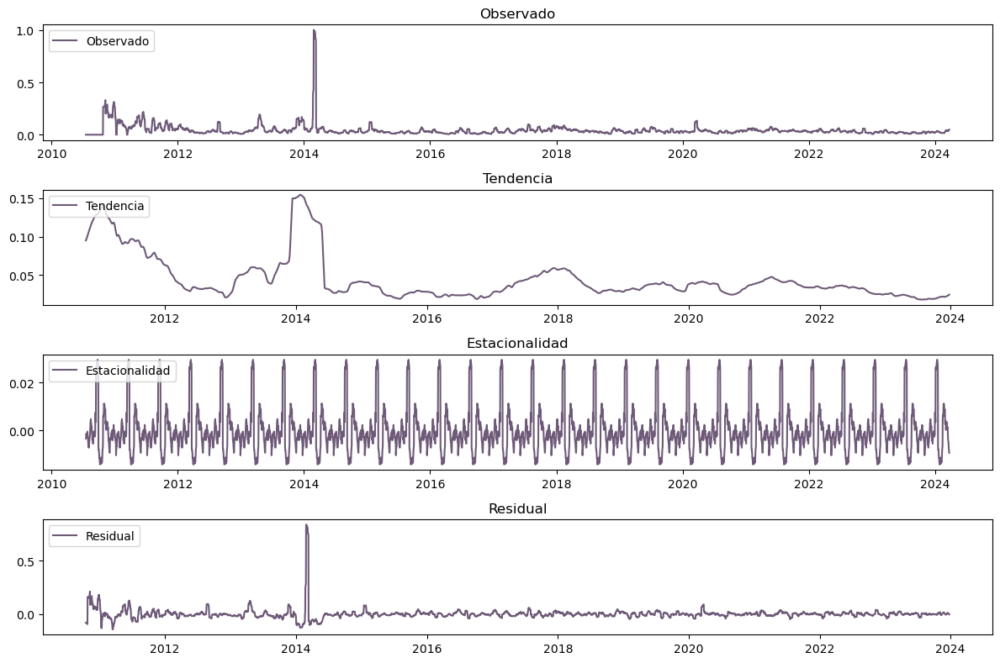

In [507]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

periodo = 180 # Cambia esto según la estacionalidad esperada 24 datos diarios (horario) x 365 días del año

# Realizar la descomposición estacional
decomposition = seasonal_decompose(df_1_st['Volatilidad_14'], model='aditive', period=periodo)

# Graficar los componentes
plt.figure(figsize=(12, 8))
plt.subplot(411)
plt.plot(df_1_st['Volatilidad_14'], label='Observado', color='#30143F', alpha=0.7)
plt.title('Observado')
plt.legend(loc='upper left')
plt.subplot(412)
plt.plot(decomposition.trend, label='Tendencia', color='#30143F', alpha=0.7)
plt.title('Tendencia')
plt.legend(loc='upper left')
plt.subplot(413)
plt.plot(decomposition.seasonal, label='Estacionalidad', color='#30143F', alpha=0.7)
plt.title('Estacionalidad')
plt.legend(loc='upper left')
plt.subplot(414)
plt.plot(decomposition.resid, label='Residual', color='#30143F', alpha=0.7)
plt.title('Residual')
plt.legend(loc='upper left')
plt.tight_layout()
plt.show()

El análisis de la volatilidad a 14 días muestra que, aunque la volatilidad general se ha mantenido baja en la mayor parte del tiempo, existen algunos picos notables, especialmente entre 2013 y 2014. La tendencia indica una disminución gradual en la volatilidad a largo plazo, mientras que la componente estacional sugiere un patrón repetitivo en el tiempo. Sin embargo, los residuales evidencian algunos eventos de volatilidad no explicados completamente por la estacionalidad o la tendencia, lo que destaca la naturaleza impredecible de ciertos periodos en la serie.

#### <font color="#30143"> Estacionaridad </font>

<div class="alert alert-block" style="background-color: #e1d9e3; color: #30143; padding: 10px; border-radius: 10px;">
    <i class="fa fa-info-circle" aria-hidden="true"></i>
    <strong>Importante:</strong>
    Una serie de tiempo se considera <strong><em>No estacionaria</em></strong> si la distribución de sus datos (media, varianza, autocorrelación, etc.) <em>no permanece constante a lo largo del tiempo</em>, es decir, si  muestra <em>tendencia, variación en la varianza, autocorrelación significativa</em>. 
</div>

* **Prueba de Dickey-Fuller**

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [513]:
result_dickeyfullerat = adfuller(df_1_st.Volatilidad_14)
dickeyfuller_at = result_dickeyfullerat[1]

print('ADF Statistic: %f' % result_dickeyfullerat[0])
print('p-value: %f' % result_dickeyfullerat[1])

# Evaluar resultados del test
if dickeyfuller_at > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -7.504145
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


* **Prueba de Ljung-Box**

De igual forma, podemos de validar si los residuales son independiente o no al aplicar la prueba de `Ljung-Box`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{Los residuales son independientes (No correlacionados)}$$
$$ H_1 : \text{Los residuales no son independientes (Hay autocorrelación en los residuales)}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que hay suficiente evidencia estadística para afirmar que la serie es estacionaria y los residuales son independientes.

In [516]:
ljungbox_resultat = acorr_ljungbox(residuals_vol14, lags=[10], return_df=True)
print('LB Statistic: %f' % ljungbox_result['lb_stat'].iloc[0])
print('p-value: %f' % ljungbox_result['lb_pvalue'].iloc[0])


# Pruebas de independencia y normalidad
ljungbox_resultat = acorr_ljungbox(residuals_vol7, lags=[10], return_df=True)
jung_box_pvalat = ljungbox_resultat['lb_pvalue'].iloc[0]

# Evaluar resultados del test
if jung_box_pvalat > 0.05:
    print('No se rechaza H0: los residuales son independientes (no correlacionados)')
else:
    print('Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)')

LB Statistic: 48206.158615
p-value: 0.000000
Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)


## <font color="#30143">Análisis Exploratorio de series de tiempo Volatilidad 21 dias </font>

### <font color="#30143">  Gráficos Subserie Estacional </font>

In [519]:
residuals_vol21 = np.array(df_1_st['Volatilidad_21']) - trend_model.predict(np.arange(df_1_st.shape[0]).reshape((-1,1)))
df_1_st['Residuals_vol21'] = residuals_vol21

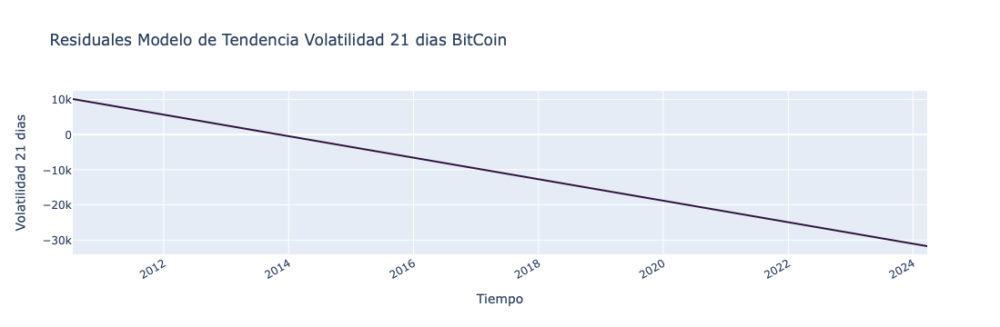

In [520]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=df_1_st.index,
    y=residuals_vol21,
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales de Volatilidad 21 dias'
))

fig.update_layout(
    title='Residuales Modelo de Tendencia Volatilidad 21 dias BitCoin',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 21 dias',
    xaxis_tickangle=-30)


fig.show()


Los residuales del modelo de tendencia general de la volatilidad 21 dias describen una tendencia decreciente en el tiempo. 

#### <font color="#30143"> Agrupación de datos semanales </font>

In [523]:
seasonal_sub_series_data_week_r = df_1_st.groupby(by=['Year', 'week'])['Residuals_vol21'].aggregate([np.mean, np.std])
seasonal_sub_series_data_week_r.columns = ['week_mean', 'week_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `week_map`

In [525]:
seasonal_sub_series_data_week_r.reset_index(inplace=True)
seasonal_sub_series_data_week_r.index = seasonal_sub_series_data_week_r['Year'].astype(str) + '-' + seasonal_sub_series_data_week_r['week']
seasonal_sub_series_data_week_r

,Year,week,week_mean,week_sd
2010-S1,2010,S1,9456.1143,366.7197
2010-S2,2010,S2,9397.5075,366.7248
2010-S3,2010,S3,9416.7770,418.0910
2010-S4,2010,S4,9408.9561,443.0827
2010-S5,2010,S5,9384.5550,466.9950
...,...,...,...,...
2024-S1,2024,S1,-31319.4674,210.8839
2024-S2,2024,S2,-31378.0729,210.8847
2024-S3,2024,S3,-31436.6786,210.8835
2024-S4,2024,S4,-31433.8893,185.8511


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = semanal. 

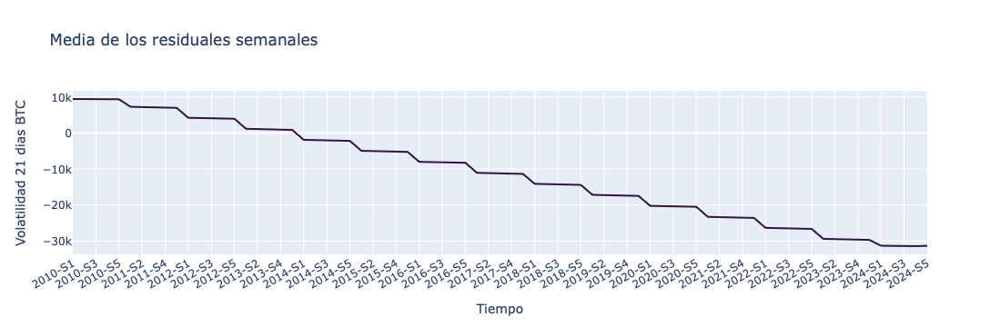

In [527]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 21 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento estacional, lo que significa que se observan variaciones repetitivas y periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios siguen un patrón predecible a lo largo del tiempo.

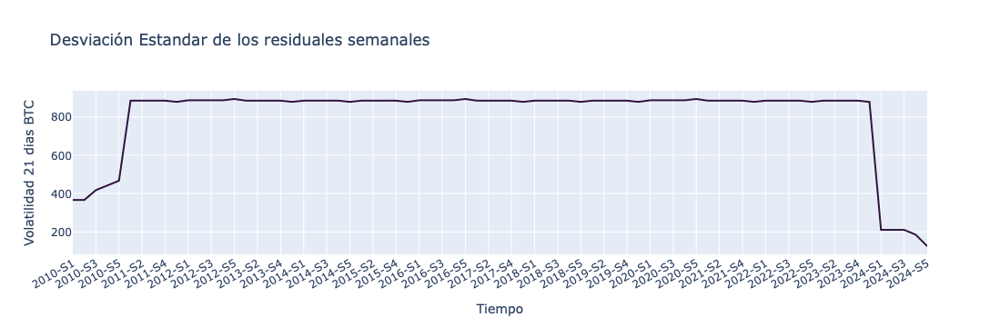

In [529]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 21 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del retorno acumulado del Bitcoin refleja  poca variabilidad, lo que sugiere que no existen fluctuaciones y presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones son predecibles y periódicas.

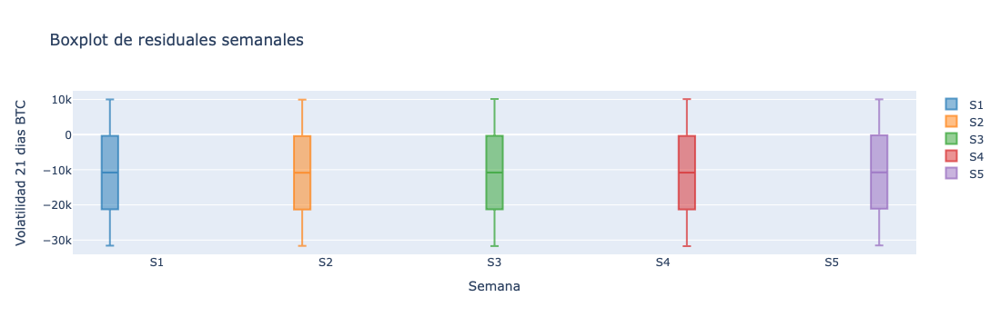

In [531]:
color_semana = {
    'S1': 'rgba(31, 119, 180, 0.7)',
    'S2': 'rgba(255, 127, 14, 0.7)',
    'S3': 'rgba(44, 160, 44, 0.7)',
    'S4': 'rgba(214, 39, 40, 0.7)',
    'S5': 'rgba(148, 103, 189, 0.7)',
    'S6': 'rgba(227, 119, 194, 0.7)'
}

fig = go.Figure()

# Agrupar por semana y añadir trazas de boxplot
for week, color in color_semana.items():
    week_data = df_1_st[df_1_st['week'] == week]
    fig.add_trace(go.Box(
        y=week_data['Residuals_vol21'],
        name=week,
        marker_color=color
    ))

# Configurar el diseño del gráfico
fig.update_layout(
    title='Boxplot de residuales semanales',
    xaxis_title='Semana',
    yaxis_title='Volatilidad 21 dias BTC',
    boxmode='group'  # Agrupa los boxplots
)

fig.show()


El gráfico de subseries estacionales refleja la tendencia central como la dispersión de los datos estacionales en un lote de unidades temporales, en este caso semanal. Además, la separación entre dos gráficos de caja adyacentes revela las variaciones dentro de la temporada, la cual es nula. 

#### <font color="#30143"> Agrupación de datos Mensual </font>

In [534]:
# Mapa para meses
month_map = {
    1: 'M1', 2: 'M2', 3: 'M3', 4: 'M4', 5: 'M5', 6: 'M6',
    7: 'M7', 8: 'M8', 9: 'M9', 10: 'M10', 11: 'M11', 12: 'M12'
}

# Asignar el mes usando la columna 'Month'
df_1_st['month'] = df_1_st['Month'].map(month_map)

In [535]:
seasonal_sub_series_data_month = df_1_st.groupby(by=['Year', 'month'])['Residuals_vol21'].aggregate([np.mean, np.std])
seasonal_sub_series_data_month.columns = ['month_mean', 'month_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `month_map`

In [537]:
seasonal_sub_series_data_month.reset_index(inplace=True)
seasonal_sub_series_data_month.index = seasonal_sub_series_data_month['Year'].astype(str) + '-' + seasonal_sub_series_data_month['month']
seasonal_sub_series_data_month.head()

,Year,month,month_mean,month_sd
2010-M10,2010,M10,9357.2743,76.0644
2010-M11,2010,M11,9102.1060,73.7199
2010-M12,2010,M12,8846.7116,76.0993
2010-M7,2010,M7,10056.3415,35.0250
2010-M8,2010,M8,9867.9587,76.1244


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = mensual. 

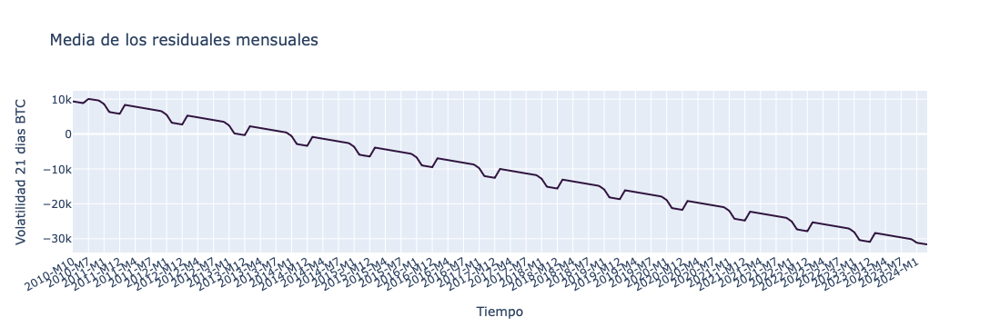

In [539]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 21 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

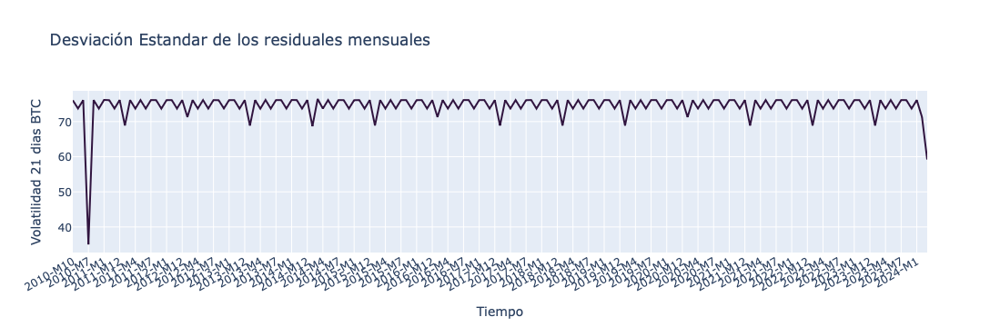

In [541]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 21 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

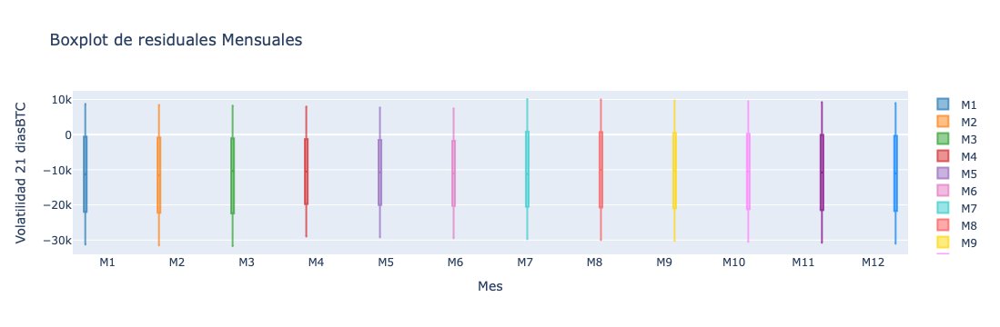

In [543]:
import plotly.graph_objects as go

# Mapa de colores para los meses
color_mes = {
    'M1': 'rgba(31, 119, 180, 0.7)',  
    'M2': 'rgba(255, 127, 14, 0.7)',   
    'M3': 'rgba(44, 160, 44, 0.7)',   
    'M4': 'rgba(214, 39, 40, 0.7)',    
    'M5': 'rgba(148, 103, 189, 0.7)',   
    'M6': 'rgba(227, 119, 194, 0.7)',   
    'M7': 'rgba(51, 204, 204, 0.7)',    
    'M8': 'rgba(255, 85, 85, 0.7)',     
    'M9': 'rgba(255, 215, 0, 0.7)',     
    'M10': 'rgba(255, 127, 255, 0.7)', 
    'M11': 'rgba(128, 0, 128, 0.7)',    
    'M12': 'rgba(0, 128, 255, 0.7)'     
}


fig = go.Figure()


for month, color in color_mes.items():
    month_data = df_1_st[df_1_st['month'] == month]
    fig.add_trace(go.Box(
        y=month_data['Residuals_vol21'],
        name=month,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Mensuales',
    xaxis_title='Mes',
    yaxis_title='Volatilidad 21 diasBTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales muestra tanto la tendencia central como la dispersión de los datos en un intervalo temporal mensual respecto al precio del Bitcoin. Se observa que la variabilidad de los datos es considerablemente mayor en ciertos períodos. En particular, la comparación entre los gráficos de caja adyacentes revela que durante los meses de abril a octubre, la dispersión de los datos es relativamente menor. En contraste, los meses de noviembre, diciembre y enero presentan una mayor variabilidad. Este aumento en la dispersión se puede atribuir al incremento en la actividad del mercado durante las festividades de Navidad, cuando el flujo de capital es más intenso y las decisiones de inversión tienden a ser más erráticas. 

#### <font color="#30143"> Agrupación de datos Anual </font>

In [546]:
unique_years = df_1_st['Year'].unique()
unique_years

array([2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
       2021, 2022, 2023, 2024], dtype=int32)

In [547]:
# Mapa para year
year_map = {
    2010: '2010', 2011: '2011', 2012: '2012', 2013: '2013', 2014: '2014', 2015: '2015',
    2016: '2016', 2017: '2017', 2018: '2018', 2019: '2019', 2020: '2020', 2021: '2022',
    2023: '2023', 2024:'2024'
}

# Asignar el mes usando la columna 'Month'
df_1_st['year'] = df_1_st['Year'].map(year_map)

In [548]:
seasonal_sub_series_data_year = df_1_st.groupby(by=['Year', 'year'])['Residuals_vol21'].aggregate([np.mean, np.std])
seasonal_sub_series_data_year.columns = ['year_mean', 'year_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `year_map`

In [550]:
seasonal_sub_series_data_year.reset_index(inplace=True)
seasonal_sub_series_data_year.index = seasonal_sub_series_data_year['Year'].astype(str) + '-' + seasonal_sub_series_data_year['year']
seasonal_sub_series_data_year.head()

,Year,year,year_mean,year_sd
2010-2010,2010,2010,9415.9288,404.7466
2011-2011,2011,2011,7188.8330,883.4125
2012-2012,2012,2012,4128.5990,885.8222
2013-2013,2013,2013,1068.4490,883.3800
2014-2014,2014,2014,-1987.5125,883.4571


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = anual. 

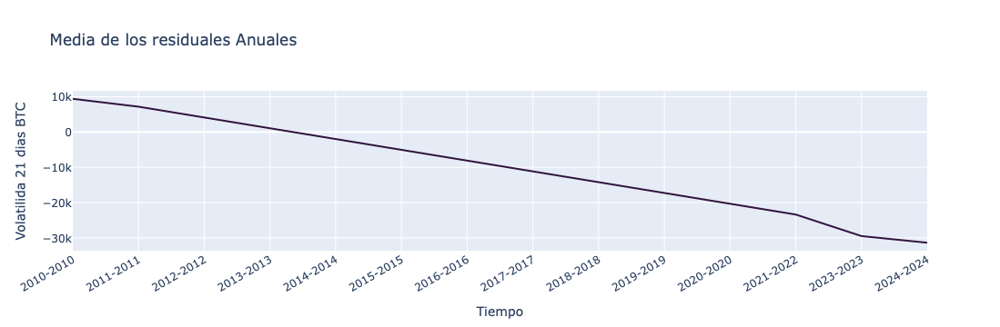

In [552]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales Anuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilida 21 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

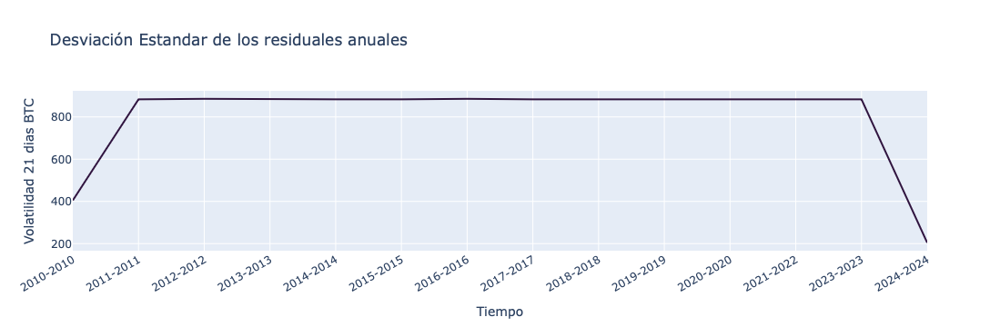

In [554]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales anuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 21 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

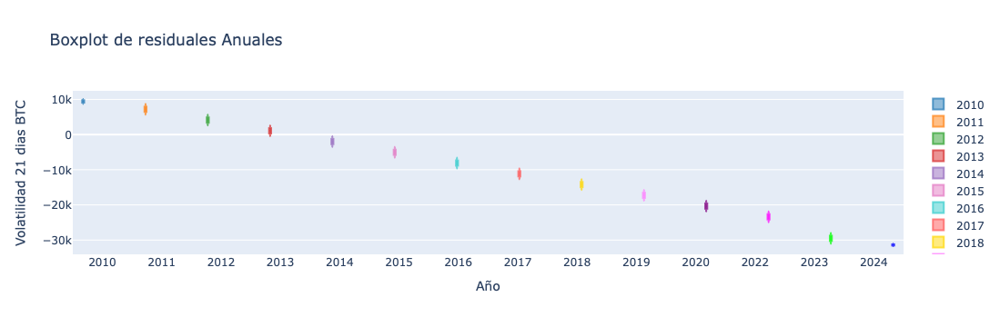

In [556]:
import plotly.graph_objects as go

color_año = {
    '2010': 'rgba(31, 119, 180, 0.7)',  
    '2011': 'rgba(255, 127, 14, 0.7)',   
    '2012': 'rgba(44, 160, 44, 0.7)',   
    '2013': 'rgba(214, 39, 40, 0.7)',    
    '2014': 'rgba(148, 103, 189, 0.7)',   
    '2015': 'rgba(227, 119, 194, 0.7)',   
    '2016': 'rgba(51, 204, 204, 0.7)',    
    '2017': 'rgba(255, 85, 85, 0.7)',     
    '2018': 'rgba(255, 215, 0, 0.7)',     
    '2019': 'rgba(255, 127, 255, 0.7)', 
    '2020': 'rgba(128, 0, 128, 0.7)',    
    '2021': 'rgba(0, 128, 255, 0.7)',     
    '2022': 'rgba(255, 0, 255, 0.7)',    
    '2023': 'rgba(0, 255, 0, 0.7)',      
    '2024': 'rgba(0, 0, 255, 0.7)'       
}


fig = go.Figure()


for year, color in color_año.items():
    year_data = df_1_st[df_1_st['year'] == year]
    fig.add_trace(go.Box(
        y=year_data['Residuals_vol21'],
        name=year,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Anuales',
    xaxis_title='Año',
    yaxis_title='Volatilidad 21 dias BTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales ilustra tanto la tendencia central como la dispersión de los datos mensuales en relación con el precio del Bitcoin. A lo largo de diferentes períodos, se destaca una notable variabilidad en los precios. Desde 2010 hasta 2016, el precio del Bitcoin se mantuvo relativamente estable, pero en 2017 experimentó un aumento significativo, acompañado de una fuerte fluctuación. En 2018, el precio descendió levemente; sin embargo, entre 2020 y 2022, se observó un notable incremento en su valor. El comportamiento del mercado en 2023 fue similar al de 2020, mientras que 2022 mostró patrones que se asemejan a los de 2024, sugiriendo tendencias recurrentes en la evolución del precio del Bitcoin. 

### Eliminación de la tendencia entre la serie y sus rezagos. 

A continuación gráficamos la `Autocorrelación` y `Autocorrelación parcial` de la serie de tiempo asociada con la volatilidad de 21 dias del Bitcoin. 

#### <font color="#30143"> Gráfico Autocorrelación y Autocorrelación Parical  </font>

A continuación se presenta gráfico de autocorrelación y autocorrelación parcial de nuestra serie temporal (Precio).

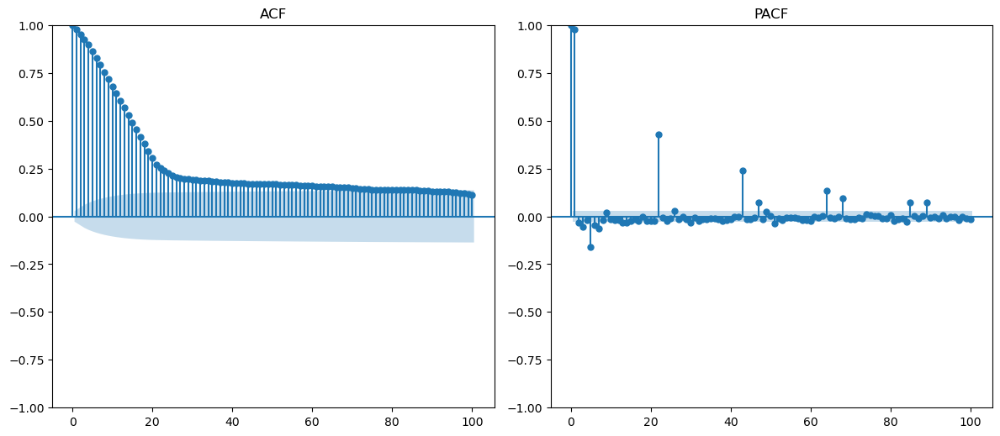

In [562]:
plotds(df_1_st['Volatilidad_21'])

Al examinar el gráfico de `autocorrelación (ACF)`, se observa un decaimiento lento en lugar de uno rápido. Esto indica que las correlaciones entre los valores actuales y sus antecedentes permanecen significativas a lo largo de numerosos rezagos. 
Por otro lado, el gráfico de `autocorrelación parcial (PACF)` sugiere la no existencia de `componentes cíclicos`. Además, la forma de onda observada dentro del intervalo en este gráfico refuerza la idea de estacionaridad. Esto implica que las `propiedades estadísticas de la serie no cambian con el tiempo`.

La eliminación de la tendencia y de la correlación entre la serie y sus rezagos puede hacerse por diferenciación.

##### Diferenciación de 1er Orden: 

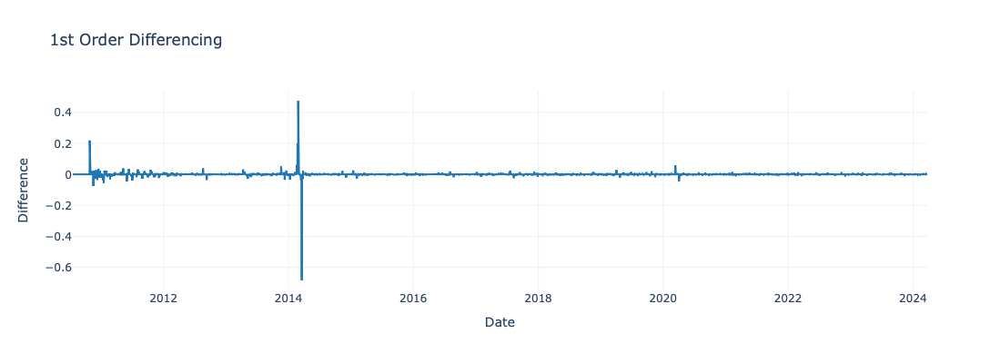

<Figure size 1000x500 with 0 Axes>

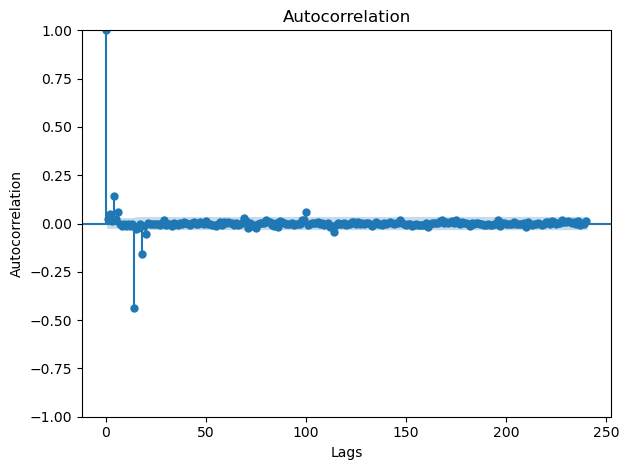

In [566]:
diff_vol21 = df_1_st.Volatilidad_21.diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_vol21.index, y=diff_vol21, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='1st Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_vol14, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()

Luego de aplicar una diferenciación de 1er orden, procedemos aplicar nuevamente la prueba de `Dickey-Fuller` para validar si nuestra serie de tiempo es estacionaria.

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [569]:
resultat1 = adfuller(df_1_st.Volatilidad_21.diff().dropna())
dickeyfuller_at1 = resultat1[1]
print('ADF Statistic: %f' % resultat1[0])
print('p-value: %f' % resultat1[1])

# Evaluar resultados del test
if dickeyfuller_at1 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -20.670130
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


##### Diferenciación de 2do Orden: 

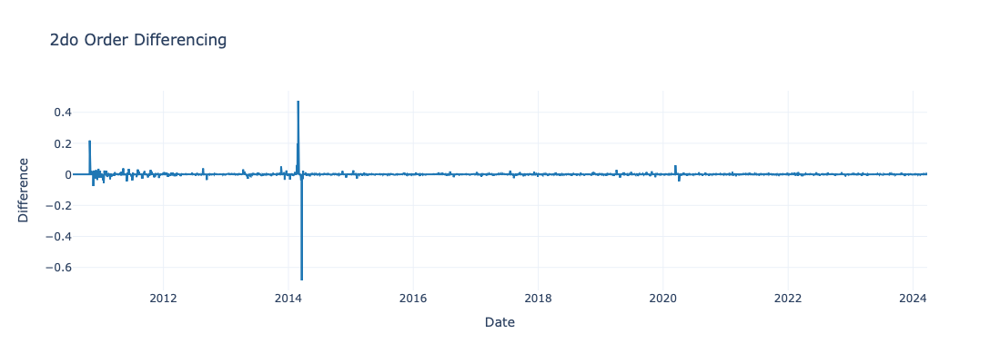

<Figure size 1000x500 with 0 Axes>

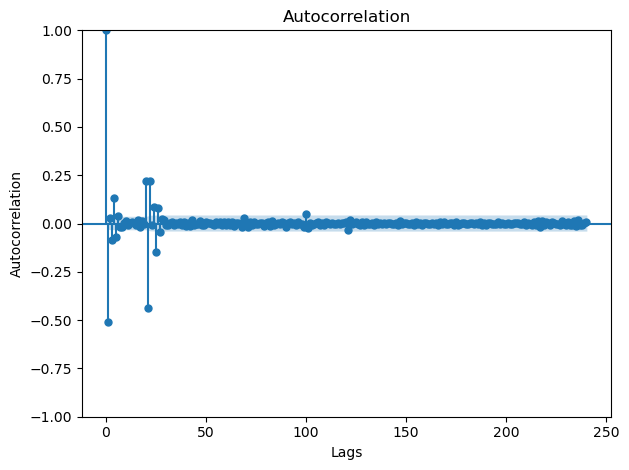

In [571]:
diff_price2 = df_1_st.Volatilidad_21.diff().diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_price2.index, y=diff_vol21, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='2do Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_price2, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()


In [572]:
resultat2 = adfuller(df_1_st.Volatilidad_21.diff().diff().dropna())
dickeyfuller_at2 = resultat2[1]
print('ADF Statistic: %f' % result2[0])
print('p-value: %f' % result2[1])

# Evaluar resultados del test
if dickeyfuller_at2 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -22.671517
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


De acuerdo al resultado obtenido con la prueba de `Dickey-Fuller` con P-value $<0.00000$, por tanto no se rechaza la hipótesis nula con una significancia $\alpha = 0.05$, es decir que `la serie de tiempo es no estacionaria`. Sin embargo al momento de análizar el gráfico de autocorrelación para la 2da diferenciación, el retraso entra en el zona negativa muy distante de nuestro limite de tolerancia, lo que indica que la serie podría haber sido sobrediferenciada. 

Por lo tanto, `vamos a fijar el orden de diferenciación como 1`, es decir,  $ d = 1$ . 


### <font color="#30143"> Agregacion por grupos (A_T) </font>

Primero, vamos a agregar los datos por semanas, días y meses, y calcular las estadísticas de media y desviación estándar. Usamos `pandas` para la agregación:

In [576]:
# Asegurándonos de que la fecha esté en el índice


# Agregación semanal
weekly_stats = df_1_st['Volatilidad_21'].resample('W').agg(['mean', 'std']).rename(columns={'mean': 'Weekly Mean', 'std': 'Weekly Std'})

# Agregación diaria
daily_stats = df_1_st['Volatilidad_21'].resample('D').agg(['mean', 'std']).rename(columns={'mean': 'Daily Mean', 'std': 'Daily Std'})

# Agregación mensual
monthly_stats = df_1_st['Volatilidad_21'].resample('M').agg(['mean', 'std']).rename(columns={'mean': 'Monthly Mean', 'std': 'Monthly Std'})


Para calcular los estadísticos móviles (media y desviación estándar móviles), podemos usar ventanas móviles para `Volatilidad 21 dias`. A continuación, calcularemos las medias móviles y desviaciones móviles:

In [578]:
# Definir ventanas móviles (lags)
window_sizes = [7, 14, 21, 28]

# Crear DataFrame vacío para almacenar las estadísticas móviles
moving_stats = pd.DataFrame(index=df_1_st.index)

# Calcular estadísticas móviles para cada ventana
for window in window_sizes:
    moving_stats[f'Moving Mean ({window} days)'] = df_1_st['Volatilidad_21'].rolling(window=window).mean()
    moving_stats[f'Moving Std ({window} days)'] = df_1_st['Volatilidad_21'].rolling(window=window).std()

# Mostrar las estadísticas móviles
moving_stats.tail()


,Moving Mean (7 days),Moving Std (7 days),Moving Mean (14 days),Moving Std (14 days),Moving Mean (21 days),Moving Std (21 days),Moving Mean (28 days),Moving Std (28 days)
Date,,,,,,,,
2024-03-20,0.0404,0.0032,0.0379,0.0034,0.0354,0.0049,0.0313,0.0086
2024-03-21,0.0416,0.0028,0.0385,0.0037,0.0362,0.0050,0.0323,0.0085
2024-03-22,0.0428,0.0021,0.0392,0.0040,0.0371,0.0049,0.0333,0.0082
2024-03-23,0.0434,0.0019,0.0399,0.0040,0.0379,0.0047,0.0343,0.0078
2024-03-24,0.0441,0.0018,0.0407,0.0041,0.0387,0.0044,0.0354,0.0073


Finalmente, para la parte de la distribución de frecuencias, podemos usar un histograma para visualizar la distribución de la variable `Volatilidad 7 dias` y cómo cambia con diferentes lags:

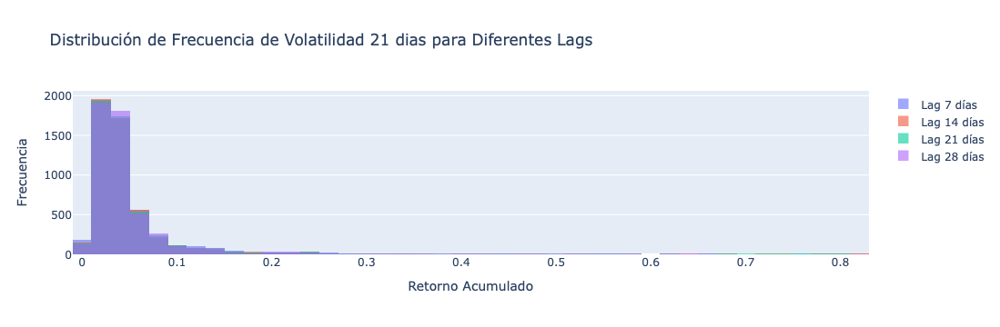

In [580]:
import plotly.express as px
import plotly.graph_objects as go

# Definir lags (ventanas móviles)
lags = [7, 14, 21, 28]

# Crear un gráfico para cada ventana móvil
fig = go.Figure()

for lag in lags:
    fig.add_trace(go.Histogram(
        x=df_1_st['Volatilidad_21'].rolling(window=lag).mean(),
        name=f'Lag {lag} días',
        opacity=0.6,
        nbinsx=50
    ))

# Ajustar el diseño del gráfico
fig.update_layout(
    title='Distribución de Frecuencia de Volatilidad 21 dias para Diferentes Lags',
    xaxis_title='Retorno Acumulado',
    yaxis_title='Frecuencia',
    barmode='overlay',  # Para que se superpongan las distribuciones
    showlegend=True
)

# Mostrar el gráfico
fig.show()



La distribución de la volatilidad acumulada a 21 días para diferentes lags muestra que la mayoría de los eventos se concentran en valores bajos, indicando una volatilidad generalmente baja en los periodos analizados. Los lags más cortos, como los de 7 y 14 días, capturan con mayor precisión estos periodos de baja volatilidad, mientras que en lags más largos (21 y 28 días) se observa una menor frecuencia en los valores bajos. Además, hay algunos eventos aislados de mayor volatilidad, lo que refleja episodios esporádicos de cambios significativos en el precio del Bitcoin.


### <font color="#30143"> Medias Moviles (Volatilida 7 dias) </font>

Para aplicar las medias móviles indicadas a la serie de tiempo del Retorno acumulado de BTC-USD, y verificar si se logra estacionaridad, seguimos los siguientes pasos:

1. **Cálculo de las Medias Móviles**: Definimos las medias móviles simples $ \hat{M}_t^{(2)}, \hat{M}_t^{(3)}, \hat{M}_t^{(4)} $, y sus respectivas versiones con desplazamiento temporal $ \hat{M}_t^{(2)}(t, t+1), $ etc. Estas se calculan con ventanas móviles de tamaño 2, 3, y 4 días.

2. **Aplicar Medias Móviles al Precio de Cierre (Price)**:
    - $ \hat{M}_t^{(2)} $: media móvil de dos días.
    - $ \hat{M}_t^{(3)} $: media móvil de tres días.
    - $ \hat{M}_t^{(4)} $: media móvil de cuatro días.

3. **Remover la Tendencia**: Para eliminar la tendencia, restamos la media móvil calculada a la serie original del Retorno acumulado. Esto nos permite obtener la serie sin tendencia.
4. **Pruebas de Estacionaridad**: Aplicamos la prueba de **Dickey-Fuller** para verificar si la serie ajustada se vuelve estacionaria. Luego, aplicamos la prueba de **Ljung-Box** para comprobar la independencia de los residuales.



In [584]:
# Importar las librerías necesarias
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox
import numpy as np

# Calcular medias móviles para diferentes ventanas
df_1_st['M_t_2'] = df_1_st['Volatilidad_21'].rolling(window=2).mean()
df_1_st['M_t_3'] = df_1_st['Volatilidad_21'].rolling(window=3).mean()
df_1_st['M_t_4'] = df_1_st['Volatilidad_21'].rolling(window=4).mean()

# Calcular las medias móviles desplazadas
df_1_st['M_t_2_shift'] = df_1_st['Volatilidad_21'].rolling(window=2).mean().shift(1)
df_1_st['M_t_3_shift'] = df_1_st['Volatilidad_21'].rolling(window=3).mean().shift(1)
df_1_st['M_t_4_shift'] = df_1_st['Volatilidad_21'].rolling(window=4).mean().shift(1)

# Eliminar tendencia restando la media móvil a la serie original (Asegúrate de usar df_1_st)
df_1_st['detrended_2'] = df_1_st['Volatilidad_21'] - df_1_st['M_t_2']
df_1_st['detrended_3'] = df_1_st['Volatilidad_21'] - df_1_st['M_t_3']
df_1_st['detrended_4'] = df_1_st['Volatilidad_21'] - df_1_st['M_t_4']

# Función para aplicar la prueba de Dickey-Fuller y Ljung-Box
def apply_stationarity_tests(series):
    # Eliminar los valores nulos antes de aplicar las pruebas
    series_clean = series.dropna()
    
    # Verificar que la serie no esté vacía después de eliminar los NaN
    if series_clean.empty:
        print("La serie es demasiado corta para realizar el test.")
        return
    
    # Prueba de Dickey-Fuller
    result_dickeyfuller = adfuller(series_clean)
    p_value_dickey = result_dickeyfuller[1]
    print(f"Dickey-Fuller p-value: {p_value_dickey}")
    
    # Prueba de Ljung-Box para los residuales
    result_ljungbox = acorr_ljungbox(series_clean, lags=[10], return_df=True)
    p_value_ljungbox = result_ljungbox['lb_pvalue'].iloc[0]
    print(f"Ljung-Box p-value: {p_value_ljungbox}")
    
    return p_value_dickey, p_value_ljungbox

# Aplicar las pruebas para cada una de las series detrendizadas
print("Resultados para Media Móvil de 2 días:")
apply_stationarity_tests(df_1_st['detrended_2'])

print("\nResultados para Media Móvil de 3 días:")
apply_stationarity_tests(df_1_st['detrended_3'])

print("\nResultados para Media Móvil de 4 días:")
apply_stationarity_tests(df_1_st['detrended_4'])


Resultados para Media Móvil de 2 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 2.9073744503228717e-25

Resultados para Media Móvil de 3 días:
Dickey-Fuller p-value: 3.2104554279186105e-30
Ljung-Box p-value: 9.157163283625929e-249

Resultados para Media Móvil de 4 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 0.0


(0.0, 0.0)

Los resultados de las pruebas de Dickey-Fuller y Ljung-Box para la volatilidad de 21 días usando medias móviles de 2, 3 y 4 días indican lo siguiente:

1. **Dickey-Fuller Test**:
   - Para las tres medias móviles (2, 3 y 4 días), los p-valores son extremadamente bajos (cercanos a 0), lo que nos permite rechazar la hipótesis nula de no estacionaridad. Por lo tanto, las series parecen ser estacionarias después de aplicar las medias móviles.

2. **Ljung-Box Test**:
   - Los p-valores para las pruebas de independencia de los residuales son también muy bajos, especialmente en el caso de la media móvil de 2 días (1.60e-24), lo que indica que los residuales no son independientes y presentan una autocorrelación significativa.
   - Para las medias móviles de 3 y 4 días, el p-valor es prácticamente cero, lo que refuerza la evidencia de autocorrelación en los residuales.

Aunque las series parecen ser estacionarias según el test de Dickey-Fuller, las pruebas de Ljung-Box sugieren que persiste una autocorrelación fuerte en los residuales, lo cual indica que la serie no cumple completamente con las propiedades de estacionaridad.





### <font color="#30143"> Descomposición de la serie temporal (Volatilidad 21 dias) </font>

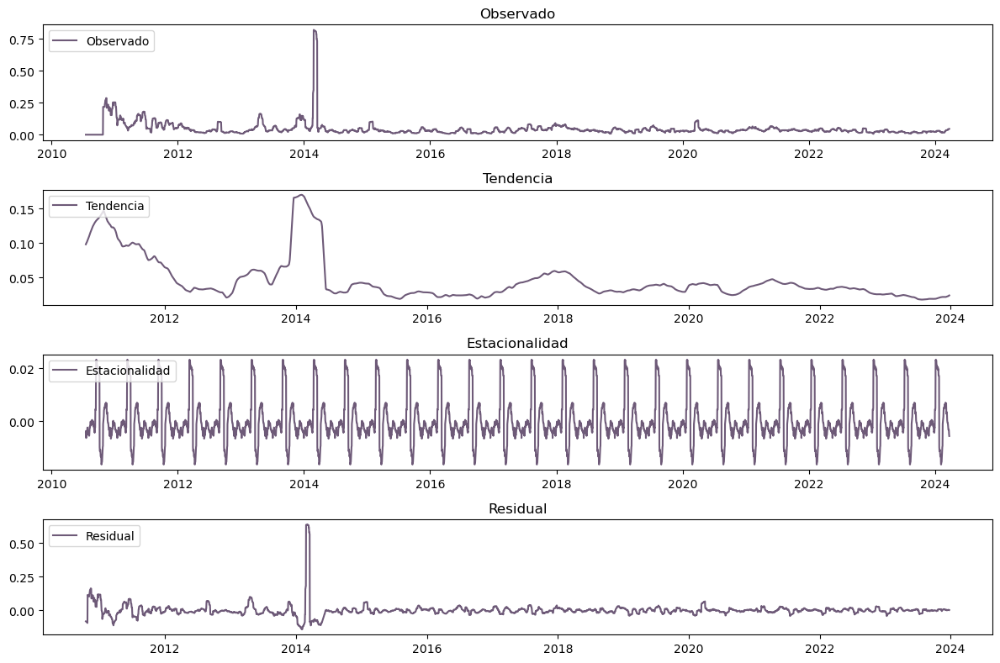

In [587]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

periodo = 180 # Cambia esto según la estacionalidad esperada 24 datos diarios (horario) x 365 días del año

# Realizar la descomposición estacional
decomposition = seasonal_decompose(df_1_st['Volatilidad_21'], model='aditive', period=periodo)

# Graficar los componentes
plt.figure(figsize=(12, 8))
plt.subplot(411)
plt.plot(df_1_st['Volatilidad_21'], label='Observado', color='#30143F', alpha=0.7)
plt.title('Observado')
plt.legend(loc='upper left')
plt.subplot(412)
plt.plot(decomposition.trend, label='Tendencia', color='#30143F', alpha=0.7)
plt.title('Tendencia')
plt.legend(loc='upper left')
plt.subplot(413)
plt.plot(decomposition.seasonal, label='Estacionalidad', color='#30143F', alpha=0.7)
plt.title('Estacionalidad')
plt.legend(loc='upper left')
plt.subplot(414)
plt.plot(decomposition.resid, label='Residual', color='#30143F', alpha=0.7)
plt.title('Residual')
plt.legend(loc='upper left')
plt.tight_layout()
plt.show()

El análisis de la volatilidad a 21 días muestra que, aunque la volatilidad general se ha mantenido baja en la mayor parte del tiempo, existen algunos picos notables, especialmente entre 2013 y 2014. La tendencia indica una disminución gradual en la volatilidad a largo plazo, mientras que la componente estacional sugiere un patrón repetitivo en el tiempo. Sin embargo, los residuales evidencian algunos eventos de volatilidad no explicados completamente por la estacionalidad o la tendencia, lo que destaca la naturaleza impredecible de ciertos periodos en la serie.

#### <font color="#30143"> Estacionaridad </font>

<div class="alert alert-block" style="background-color: #e1d9e3; color: #30143; padding: 10px; border-radius: 10px;">
    <i class="fa fa-info-circle" aria-hidden="true"></i>
    <strong>Importante:</strong>
    Una serie de tiempo se considera <strong><em>No estacionaria</em></strong> si la distribución de sus datos (media, varianza, autocorrelación, etc.) <em>no permanece constante a lo largo del tiempo</em>, es decir, si  muestra <em>tendencia, variación en la varianza, autocorrelación significativa</em>. 
</div>

* **Prueba de Dickey-Fuller**

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [593]:
result_dickeyfullerat = adfuller(df_1_st.Volatilidad_21)
dickeyfuller_at = result_dickeyfullerat[1]

print('ADF Statistic: %f' % result_dickeyfullerat[0])
print('p-value: %f' % result_dickeyfullerat[1])

# Evaluar resultados del test
if dickeyfuller_at > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -7.326992
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


* **Prueba de Ljung-Box**

De igual forma, podemos de validar si los residuales son independiente o no al aplicar la prueba de `Ljung-Box`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{Los residuales son independientes (No correlacionados)}$$
$$ H_1 : \text{Los residuales no son independientes (Hay autocorrelación en los residuales)}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que hay suficiente evidencia estadística para afirmar que la serie es estacionaria y los residuales son independientes.

In [596]:
ljungbox_resultat = acorr_ljungbox(residuals_vol21, lags=[10], return_df=True)
print('LB Statistic: %f' % ljungbox_result['lb_stat'].iloc[0])
print('p-value: %f' % ljungbox_result['lb_pvalue'].iloc[0])


# Pruebas de independencia y normalidad
ljungbox_resultat = acorr_ljungbox(residuals_vol7, lags=[10], return_df=True)
jung_box_pvalat = ljungbox_resultat['lb_pvalue'].iloc[0]

# Evaluar resultados del test
if jung_box_pvalat > 0.05:
    print('No se rechaza H0: los residuales son independientes (no correlacionados)')
else:
    print('Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)')

LB Statistic: 48206.158615
p-value: 0.000000
Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)


## <font color="#30143">Análisis Exploratorio de series de tiempo Volatilidad 28 dias </font>

### <font color="#30143">  Gráficos Subserie Estacional </font>

In [599]:
residuals_vol28 = np.array(df_1_st['Volatilidad_28']) - trend_model.predict(np.arange(df_1_st.shape[0]).reshape((-1,1)))
df_1_st['Residuals_vol28'] = residuals_vol28

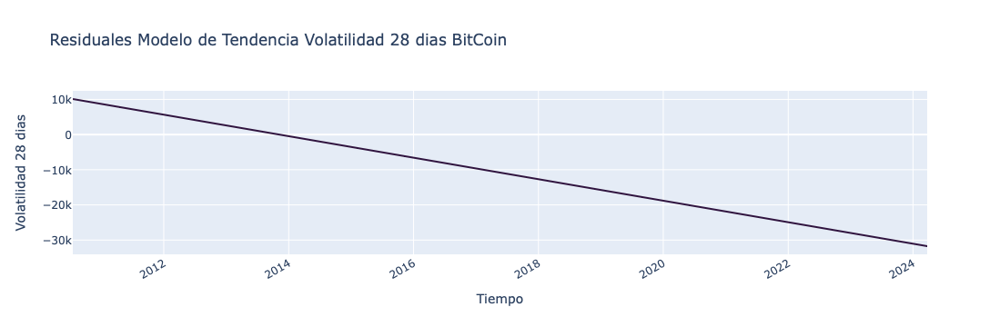

In [600]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=df_1_st.index,
    y=residuals_vol28,
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales de Volatilidad 28 dias'
))

fig.update_layout(
    title='Residuales Modelo de Tendencia Volatilidad 28 dias BitCoin',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 28 dias',
    xaxis_tickangle=-30)


fig.show()


Los residuales del modelo de tendencia general de la volatilidad 28 dias describen una tendencia decreciente en el tiempo. 

#### <font color="#30143"> Agrupación de datos semanales </font>

In [603]:
seasonal_sub_series_data_week_r = df_1_st.groupby(by=['Year', 'week'])['Residuals_vol28'].aggregate([np.mean, np.std])
seasonal_sub_series_data_week_r.columns = ['week_mean', 'week_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `week_map`

In [605]:
seasonal_sub_series_data_week_r.reset_index(inplace=True)
seasonal_sub_series_data_week_r.index = seasonal_sub_series_data_week_r['Year'].astype(str) + '-' + seasonal_sub_series_data_week_r['week']
seasonal_sub_series_data_week_r

,Year,week,week_mean,week_sd
2010-S1,2010,S1,9456.1109,366.7205
2010-S2,2010,S2,9397.5046,366.7238
2010-S3,2010,S3,9416.7789,418.0916
2010-S4,2010,S4,9408.9522,443.0854
2010-S5,2010,S5,9384.5494,466.9990
...,...,...,...,...
2024-S1,2024,S1,-31319.4665,210.8859
2024-S2,2024,S2,-31378.0740,210.8855
2024-S3,2024,S3,-31436.6800,210.8835
2024-S4,2024,S4,-31433.8901,185.8511


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = semanal. 

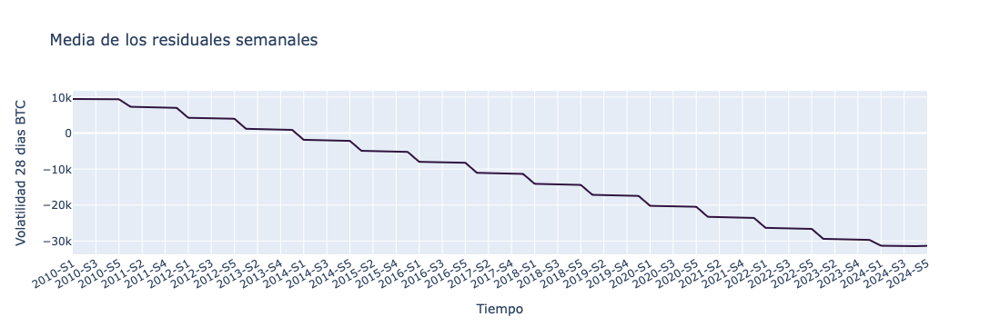

In [607]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 28 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento estacional, lo que significa que se observan variaciones repetitivas y periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios siguen un patrón predecible a lo largo del tiempo.

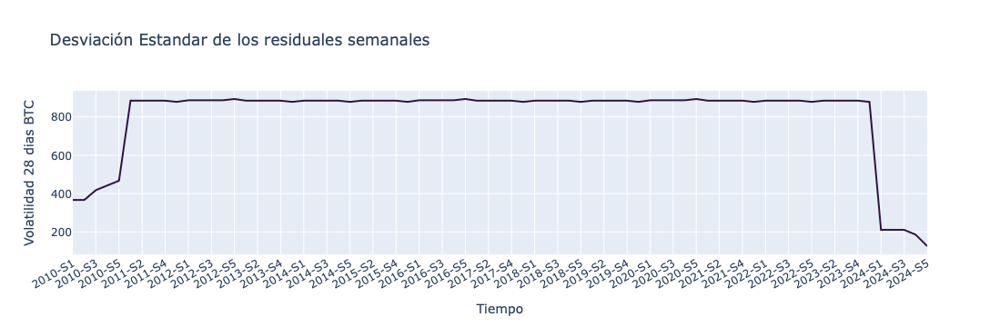

In [609]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_week_r.index,
    y=seasonal_sub_series_data_week_r['week_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales semanales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 28 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del retorno acumulado del Bitcoin refleja  poca variabilidad, lo que sugiere que no existen fluctuaciones y presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones son predecibles y periódicas.

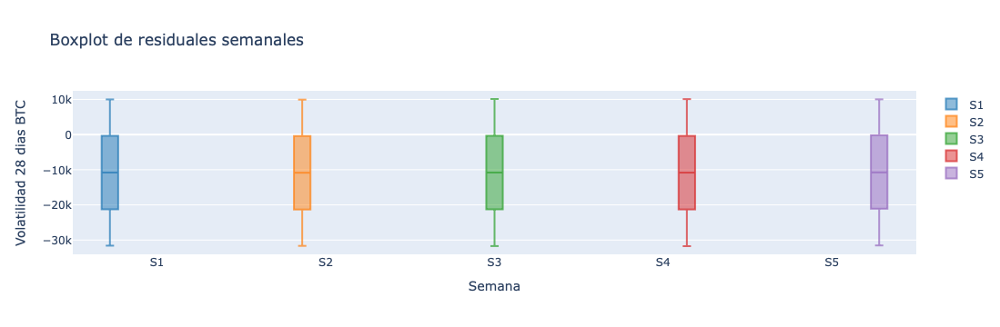

In [611]:
color_semana = {
    'S1': 'rgba(31, 119, 180, 0.7)',
    'S2': 'rgba(255, 127, 14, 0.7)',
    'S3': 'rgba(44, 160, 44, 0.7)',
    'S4': 'rgba(214, 39, 40, 0.7)',
    'S5': 'rgba(148, 103, 189, 0.7)',
    'S6': 'rgba(227, 119, 194, 0.7)'
}

fig = go.Figure()

# Agrupar por semana y añadir trazas de boxplot
for week, color in color_semana.items():
    week_data = df_1_st[df_1_st['week'] == week]
    fig.add_trace(go.Box(
        y=week_data['Residuals_vol28'],
        name=week,
        marker_color=color
    ))

# Configurar el diseño del gráfico
fig.update_layout(
    title='Boxplot de residuales semanales',
    xaxis_title='Semana',
    yaxis_title='Volatilidad 28 dias BTC',
    boxmode='group'  # Agrupa los boxplots
)

fig.show()


El gráfico de subseries estacionales refleja la tendencia central como la dispersión de los datos estacionales en un lote de unidades temporales, en este caso semanal. Además, la separación entre dos gráficos de caja adyacentes revela las variaciones dentro de la temporada, la cual es nula. 

#### <font color="#30143"> Agrupación de datos Mensual </font>

In [614]:
# Mapa para meses
month_map = {
    1: 'M1', 2: 'M2', 3: 'M3', 4: 'M4', 5: 'M5', 6: 'M6',
    7: 'M7', 8: 'M8', 9: 'M9', 10: 'M10', 11: 'M11', 12: 'M12'
}

# Asignar el mes usando la columna 'Month'
df_1_st['month'] = df_1_st['Month'].map(month_map)

In [615]:
seasonal_sub_series_data_month = df_1_st.groupby(by=['Year', 'month'])['Residuals_vol28'].aggregate([np.mean, np.std])
seasonal_sub_series_data_month.columns = ['month_mean', 'month_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `month_map`

In [617]:
seasonal_sub_series_data_month.reset_index(inplace=True)
seasonal_sub_series_data_month.index = seasonal_sub_series_data_month['Year'].astype(str) + '-' + seasonal_sub_series_data_month['month']
seasonal_sub_series_data_month.head()

,Year,month,month_mean,month_sd
2010-M10,2010,M10,9357.2686,76.0725
2010-M11,2010,M11,9102.0977,73.7019
2010-M12,2010,M12,8846.7123,76.1116
2010-M7,2010,M7,10056.3415,35.0250
2010-M8,2010,M8,9867.9587,76.1244


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = mensual. 

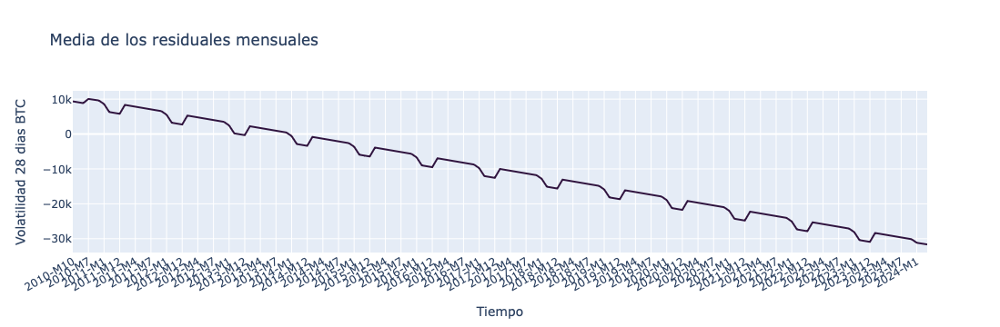

In [619]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 28 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

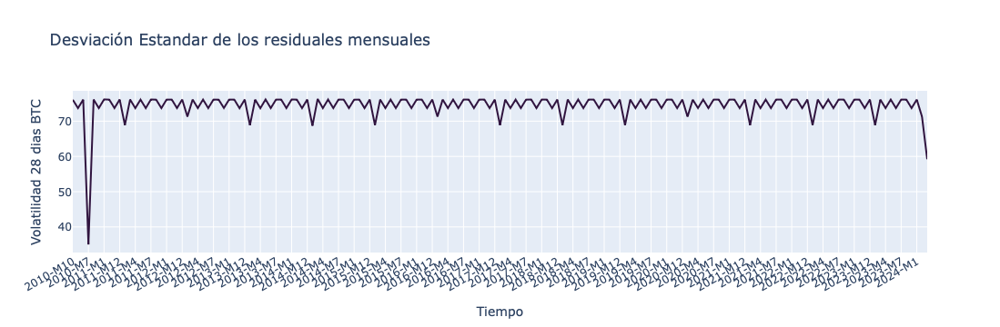

In [621]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_month.index,
    y=seasonal_sub_series_data_month['month_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales mensuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 28 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

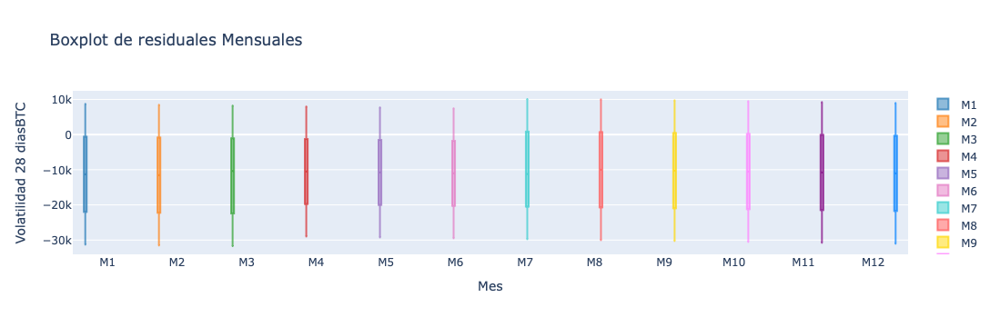

In [623]:
import plotly.graph_objects as go

# Mapa de colores para los meses
color_mes = {
    'M1': 'rgba(31, 119, 180, 0.7)',  
    'M2': 'rgba(255, 127, 14, 0.7)',   
    'M3': 'rgba(44, 160, 44, 0.7)',   
    'M4': 'rgba(214, 39, 40, 0.7)',    
    'M5': 'rgba(148, 103, 189, 0.7)',   
    'M6': 'rgba(227, 119, 194, 0.7)',   
    'M7': 'rgba(51, 204, 204, 0.7)',    
    'M8': 'rgba(255, 85, 85, 0.7)',     
    'M9': 'rgba(255, 215, 0, 0.7)',     
    'M10': 'rgba(255, 127, 255, 0.7)', 
    'M11': 'rgba(128, 0, 128, 0.7)',    
    'M12': 'rgba(0, 128, 255, 0.7)'     
}


fig = go.Figure()


for month, color in color_mes.items():
    month_data = df_1_st[df_1_st['month'] == month]
    fig.add_trace(go.Box(
        y=month_data['Residuals_vol28'],
        name=month,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Mensuales',
    xaxis_title='Mes',
    yaxis_title='Volatilidad 28 diasBTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales muestra tanto la tendencia central como la dispersión de los datos en un intervalo temporal mensual respecto al precio del Bitcoin. Se observa que la variabilidad de los datos es considerablemente mayor en ciertos períodos. En particular, la comparación entre los gráficos de caja adyacentes revela que durante los meses de abril a octubre, la dispersión de los datos es relativamente menor. En contraste, los meses de noviembre, diciembre y enero presentan una mayor variabilidad. Este aumento en la dispersión se puede atribuir al incremento en la actividad del mercado durante las festividades de Navidad, cuando el flujo de capital es más intenso y las decisiones de inversión tienden a ser más erráticas. 

#### <font color="#30143"> Agrupación de datos Anual </font>

In [626]:
unique_years = df_1_st['Year'].unique()
unique_years

array([2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
       2021, 2022, 2023, 2024], dtype=int32)

In [627]:
# Mapa para year
year_map = {
    2010: '2010', 2011: '2011', 2012: '2012', 2013: '2013', 2014: '2014', 2015: '2015',
    2016: '2016', 2017: '2017', 2018: '2018', 2019: '2019', 2020: '2020', 2021: '2022',
    2023: '2023', 2024:'2024'
}

# Asignar el mes usando la columna 'Month'
df_1_st['year'] = df_1_st['Year'].map(year_map)

In [628]:
seasonal_sub_series_data_year = df_1_st.groupby(by=['Year', 'year'])['Residuals_vol28'].aggregate([np.mean, np.std])
seasonal_sub_series_data_year.columns = ['year_mean', 'year_sd']

Creamos índices de filas de seasonal_sub_series_data utilizando `Year` & `year_map`

In [630]:
seasonal_sub_series_data_year.reset_index(inplace=True)
seasonal_sub_series_data_year.index = seasonal_sub_series_data_year['Year'].astype(str) + '-' + seasonal_sub_series_data_year['year']
seasonal_sub_series_data_year.head()

,Year,year,year_mean,year_sd
2010-2010,2010,2010,9415.9263,404.7479
2011-2011,2011,2011,7188.8365,883.4139
2012-2012,2012,2012,4128.6000,885.8218
2013-2013,2013,2013,1068.4487,883.3804
2014-2014,2014,2014,-1987.5048,883.4636


La tabla anterior describe la media y la desviación estandar de los residuales a tráves de un gráfico de subersies con seasonal = anual. 

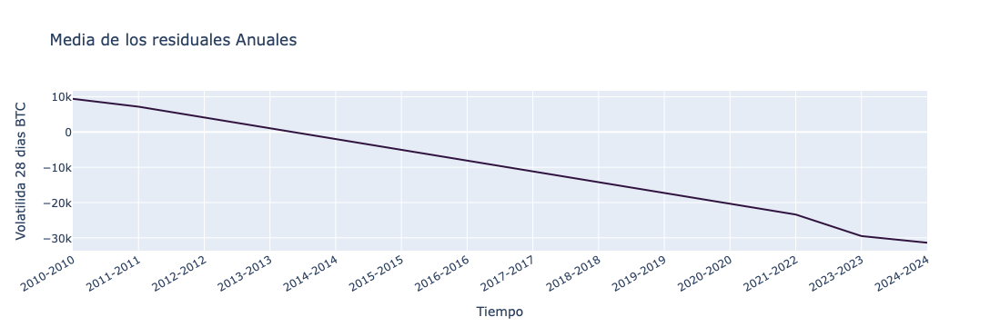

In [632]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_mean'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Media de los residuales Anuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilida 28 dias BTC',
    xaxis_tickangle=-30)


fig.show()

El gráfico revela que los residuales presentan un comportamiento no estacional, lo que significa que no se observan variaciones repetitivas ni periódicas en la serie temporal. Esto sugiere que las fluctuaciones en los precios no siguen un patrón predecible a lo largo del tiempo.

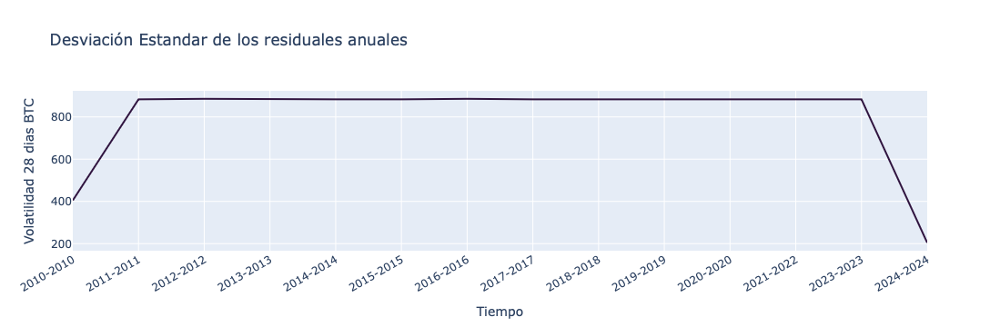

In [634]:
fig = go.Figure()


fig.add_trace(go.Scatter(
    x=seasonal_sub_series_data_year.index,
    y=seasonal_sub_series_data_year['year_sd'],
    mode='lines', 
    line=dict(color='#30143F'),
    name='Residuales'
))

fig.update_layout(
    title='Desviación Estandar de los residuales anuales',
    xaxis_title='Tiempo',
    yaxis_title='Volatilidad 28 dias BTC',
    xaxis_tickangle=-30)


fig.show()

La desviación estándar de los residuales del modelo de tendencia general del precio del Bitcoin refleja  una variabilidad considerable, lo que sugiere que las fluctuaciones en los precios son erráticas y no presentan patrones estacionales. Al observar gráficos de series temporales semanales, se evidencia que estas fluctuaciones no son predecibles ni periódicas, lo que resalta la naturaleza volátil de los precios del Bitcoin a lo largo del tiempo.

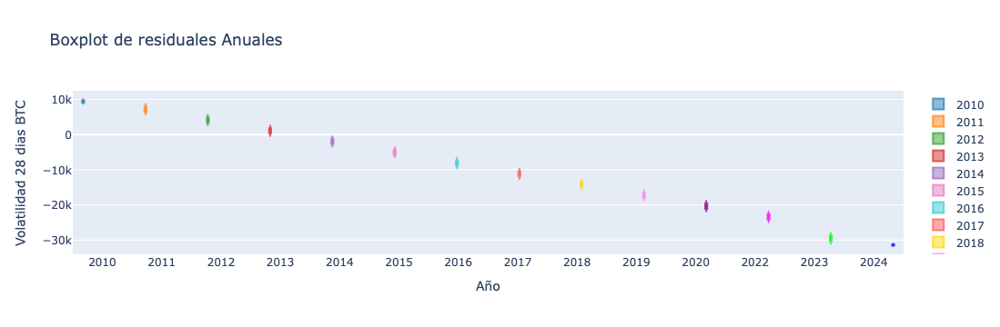

In [636]:
import plotly.graph_objects as go

color_año = {
    '2010': 'rgba(31, 119, 180, 0.7)',  
    '2011': 'rgba(255, 127, 14, 0.7)',   
    '2012': 'rgba(44, 160, 44, 0.7)',   
    '2013': 'rgba(214, 39, 40, 0.7)',    
    '2014': 'rgba(148, 103, 189, 0.7)',   
    '2015': 'rgba(227, 119, 194, 0.7)',   
    '2016': 'rgba(51, 204, 204, 0.7)',    
    '2017': 'rgba(255, 85, 85, 0.7)',     
    '2018': 'rgba(255, 215, 0, 0.7)',     
    '2019': 'rgba(255, 127, 255, 0.7)', 
    '2020': 'rgba(128, 0, 128, 0.7)',    
    '2021': 'rgba(0, 128, 255, 0.7)',     
    '2022': 'rgba(255, 0, 255, 0.7)',    
    '2023': 'rgba(0, 255, 0, 0.7)',      
    '2024': 'rgba(0, 0, 255, 0.7)'       
}


fig = go.Figure()


for year, color in color_año.items():
    year_data = df_1_st[df_1_st['year'] == year]
    fig.add_trace(go.Box(
        y=year_data['Residuals_vol28'],
        name=year,
        marker_color=color
    ))

fig.update_layout(
    title='Boxplot de residuales Anuales',
    xaxis_title='Año',
    yaxis_title='Volatilidad 28 dias BTC',
    boxmode='group' 
)


fig.show()

El gráfico de subseries estacionales ilustra tanto la tendencia central como la dispersión de los datos mensuales en relación con el precio del Bitcoin. A lo largo de diferentes períodos, se destaca una notable variabilidad en los precios. Desde 2010 hasta 2016, el precio del Bitcoin se mantuvo relativamente estable, pero en 2017 experimentó un aumento significativo, acompañado de una fuerte fluctuación. En 2018, el precio descendió levemente; sin embargo, entre 2020 y 2022, se observó un notable incremento en su valor. El comportamiento del mercado en 2023 fue similar al de 2020, mientras que 2022 mostró patrones que se asemejan a los de 2024, sugiriendo tendencias recurrentes en la evolución del precio del Bitcoin. 

### Eliminación de la tendencia entre la serie y sus rezagos. 

A continuación gráficamos la `Autocorrelación` y `Autocorrelación parcial` de la serie de tiempo asociada con la volatilidad de 28 dias del Bitcoin. 

#### <font color="#30143"> Gráfico Autocorrelación y Autocorrelación Parical  </font>

A continuación se presenta gráfico de autocorrelación y autocorrelación parcial de nuestra serie temporal (Precio).

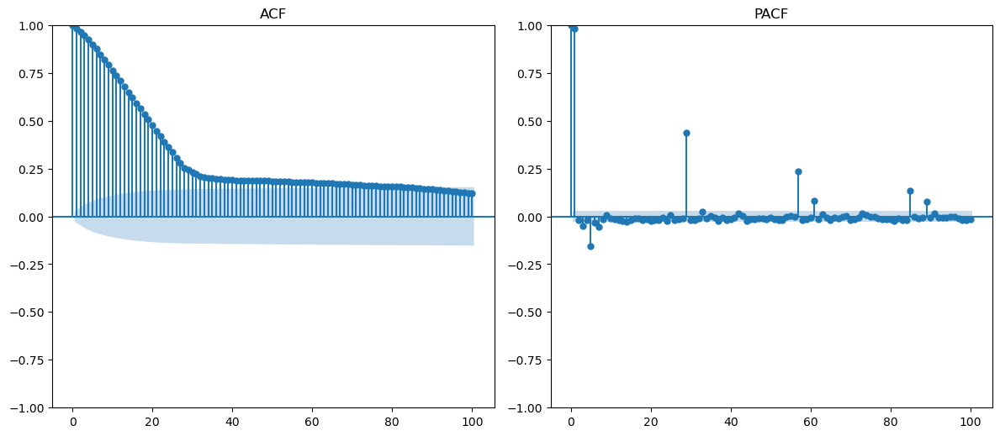

In [642]:
plotds(df_1_st['Volatilidad_28'])

Al examinar el gráfico de `autocorrelación (ACF)`, se observa un decaimiento lento en lugar de uno rápido. Esto indica que las correlaciones entre los valores actuales y sus antecedentes permanecen significativas a lo largo de numerosos rezagos. 
Por otro lado, el gráfico de `autocorrelación parcial (PACF)` sugiere la no existencia de `componentes cíclicos`. Además, la forma de onda observada dentro del intervalo en este gráfico refuerza la idea de estacionaridad. Esto implica que las `propiedades estadísticas de la serie no cambian con el tiempo`.

La eliminación de la tendencia y de la correlación entre la serie y sus rezagos puede hacerse por diferenciación.

##### Diferenciación de 1er Orden: 

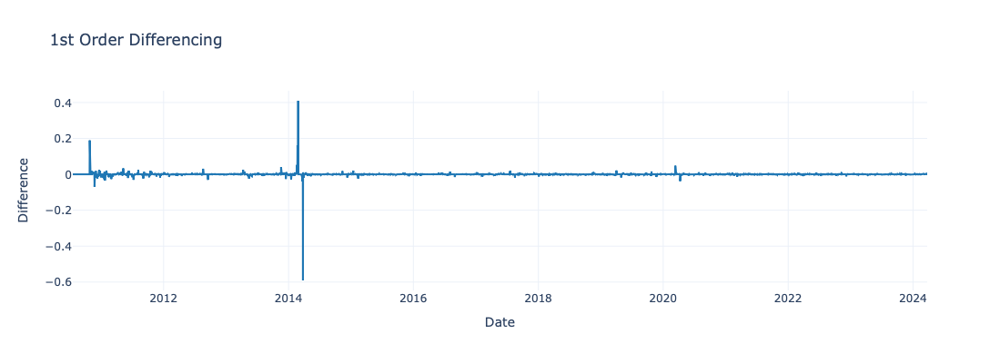

<Figure size 1000x500 with 0 Axes>

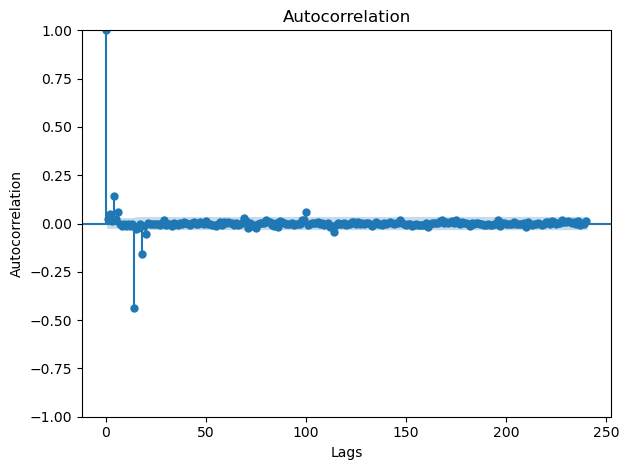

In [646]:
diff_vol28 = df_1_st.Volatilidad_28.diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_vol28.index, y=diff_vol28, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='1st Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_vol14, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()

Luego de aplicar una diferenciación de 1er orden, procedemos aplicar nuevamente la prueba de `Dickey-Fuller` para validar si nuestra serie de tiempo es estacionaria.

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [649]:
resultat1 = adfuller(df_1_st.Volatilidad_28.diff().dropna())
dickeyfuller_at1 = resultat1[1]
print('ADF Statistic: %f' % resultat1[0])
print('p-value: %f' % resultat1[1])

# Evaluar resultados del test
if dickeyfuller_at1 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -21.794578
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


##### Diferenciación de 2do Orden: 

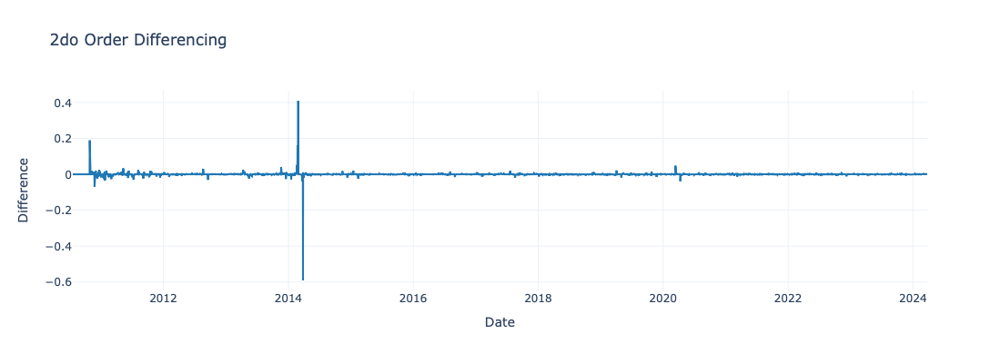

<Figure size 1000x500 with 0 Axes>

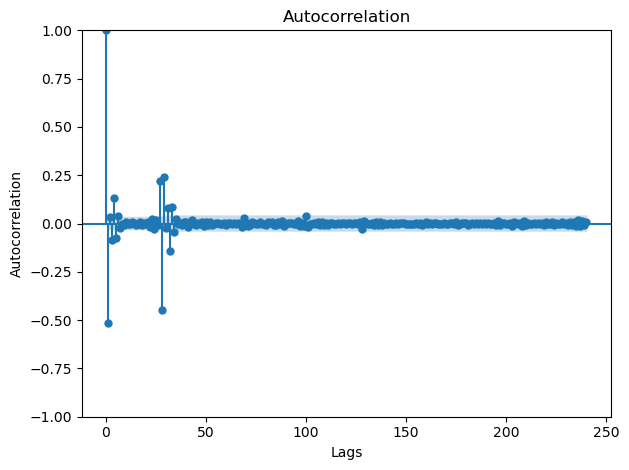

In [651]:
diff_price2 = df_1_st.Volatilidad_28.diff().diff().dropna()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff_price2.index, y=diff_vol28, mode='lines', name='1st Order Differencing', line=dict(color='#1f77b4')))
fig.update_layout(title='2do Order Differencing',
                  xaxis_title='Date',
                  yaxis_title='Difference',
                  template='plotly_white',
                  width=800,  # Ancho del gráfico
                  height=400)  # Alto del gráfico
fig.show()

plt.figure(figsize=(10, 5))
plot_acf(diff_price2, lags=240)
plt.title('Autocorrelation')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.tight_layout()


In [652]:
resultat2 = adfuller(df_1_st.Volatilidad_28.diff().diff().dropna())
dickeyfuller_at2 = resultat2[1]
print('ADF Statistic: %f' % result2[0])
print('p-value: %f' % result2[1])

# Evaluar resultados del test
if dickeyfuller_at2 > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -22.671517
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


De acuerdo al resultado obtenido con la prueba de `Dickey-Fuller` con P-value $<0.00000$, por tanto no se rechaza la hipótesis nula con una significancia $\alpha = 0.05$, es decir que `la serie de tiempo es no estacionaria`. Sin embargo al momento de análizar el gráfico de autocorrelación para la 2da diferenciación, el retraso entra en el zona negativa muy distante de nuestro limite de tolerancia, lo que indica que la serie podría haber sido sobrediferenciada. 

Por lo tanto, `vamos a fijar el orden de diferenciación como 1`, es decir,  $ d = 1$ . 


### <font color="#30143"> Agregacion por grupos (A_T) </font>

Primero, vamos a agregar los datos por semanas, días y meses, y calcular las estadísticas de media y desviación estándar. Usamos `pandas` para la agregación:

In [656]:
# Asegurándonos de que la fecha esté en el índice


# Agregación semanal
weekly_stats = df_1_st['Volatilidad_28'].resample('W').agg(['mean', 'std']).rename(columns={'mean': 'Weekly Mean', 'std': 'Weekly Std'})

# Agregación diaria
daily_stats = df_1_st['Volatilidad_28'].resample('D').agg(['mean', 'std']).rename(columns={'mean': 'Daily Mean', 'std': 'Daily Std'})

# Agregación mensual
monthly_stats = df_1_st['Volatilidad_28'].resample('M').agg(['mean', 'std']).rename(columns={'mean': 'Monthly Mean', 'std': 'Monthly Std'})


Para calcular los estadísticos móviles (media y desviación estándar móviles), podemos usar ventanas móviles para `Volatilidad 21 dias`. A continuación, calcularemos las medias móviles y desviaciones móviles:

In [658]:
# Definir ventanas móviles (lags)
window_sizes = [7, 14, 21, 28]

# Crear DataFrame vacío para almacenar las estadísticas móviles
moving_stats = pd.DataFrame(index=df_1_st.index)

# Calcular estadísticas móviles para cada ventana
for window in window_sizes:
    moving_stats[f'Moving Mean ({window} days)'] = df_1_st['Volatilidad_28'].rolling(window=window).mean()
    moving_stats[f'Moving Std ({window} days)'] = df_1_st['Volatilidad_28'].rolling(window=window).std()

# Mostrar las estadísticas móviles
moving_stats.tail()


,Moving Mean (7 days),Moving Std (7 days),Moving Mean (14 days),Moving Std (14 days),Moving Mean (21 days),Moving Std (21 days),Moving Mean (28 days),Moving Std (28 days)
Date,,,,,,,,
2024-03-20,0.0367,0.0039,0.0343,0.0037,0.0320,0.0048,0.0285,0.0075
2024-03-21,0.0384,0.0042,0.0351,0.0045,0.0329,0.0052,0.0294,0.0078
2024-03-22,0.0400,0.0040,0.0360,0.0050,0.0338,0.0055,0.0305,0.0078
2024-03-23,0.0413,0.0037,0.0369,0.0053,0.0347,0.0056,0.0315,0.0077
2024-03-24,0.0426,0.0031,0.0379,0.0054,0.0357,0.0055,0.0325,0.0075


Finalmente, para la parte de la distribución de frecuencias, podemos usar un histograma para visualizar la distribución de la variable `Volatilidad 28 dias` y cómo cambia con diferentes lags:

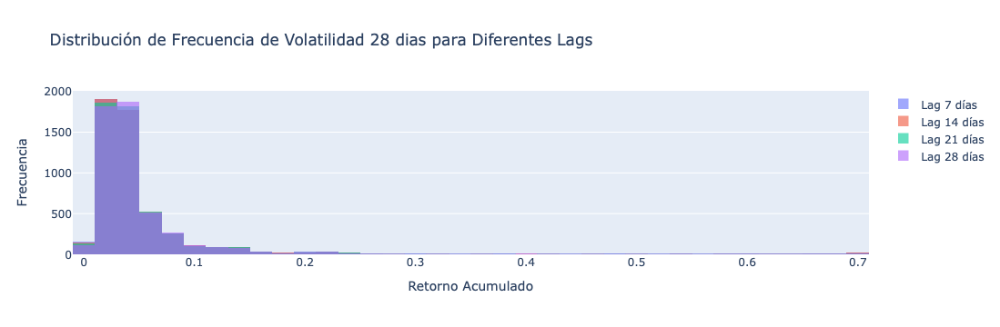

In [660]:
import plotly.express as px
import plotly.graph_objects as go

# Definir lags (ventanas móviles)
lags = [7, 14, 21, 28]

# Crear un gráfico para cada ventana móvil
fig = go.Figure()

for lag in lags:
    fig.add_trace(go.Histogram(
        x=df_1_st['Volatilidad_28'].rolling(window=lag).mean(),
        name=f'Lag {lag} días',
        opacity=0.6,
        nbinsx=50
    ))

# Ajustar el diseño del gráfico
fig.update_layout(
    title='Distribución de Frecuencia de Volatilidad 28 dias para Diferentes Lags',
    xaxis_title='Retorno Acumulado',
    yaxis_title='Frecuencia',
    barmode='overlay',  # Para que se superpongan las distribuciones
    showlegend=True
)

# Mostrar el gráfico
fig.show()



La distribución de la volatilidad acumulada a 28 días para diferentes lags muestra que la mayoría de los eventos se concentran en valores bajos, indicando una volatilidad generalmente baja en los periodos analizados. Los lags más cortos, como los de 7 y 14 días, capturan con mayor precisión estos periodos de baja volatilidad, mientras que en lags más largos (21 y 28 días) se observa una menor frecuencia en los valores bajos. Además, hay algunos eventos aislados de mayor volatilidad, lo que refleja episodios esporádicos de cambios significativos en el precio del Bitcoin.


### <font color="#30143"> Medias Moviles (Volatilida 7 dias) </font>

Para aplicar las medias móviles indicadas a la serie de tiempo del Retorno acumulado de BTC-USD, y verificar si se logra estacionaridad, seguimos los siguientes pasos:

1. **Cálculo de las Medias Móviles**: Definimos las medias móviles simples $ \hat{M}_t^{(2)}, \hat{M}_t^{(3)}, \hat{M}_t^{(4)} $, y sus respectivas versiones con desplazamiento temporal $ \hat{M}_t^{(2)}(t, t+1), $ etc. Estas se calculan con ventanas móviles de tamaño 2, 3, y 4 días.

2. **Aplicar Medias Móviles al Precio de Cierre (Price)**:
    - $ \hat{M}_t^{(2)} $: media móvil de dos días.
    - $ \hat{M}_t^{(3)} $: media móvil de tres días.
    - $ \hat{M}_t^{(4)} $: media móvil de cuatro días.

3. **Remover la Tendencia**: Para eliminar la tendencia, restamos la media móvil calculada a la serie original del Retorno acumulado. Esto nos permite obtener la serie sin tendencia.
4. **Pruebas de Estacionaridad**: Aplicamos la prueba de **Dickey-Fuller** para verificar si la serie ajustada se vuelve estacionaria. Luego, aplicamos la prueba de **Ljung-Box** para comprobar la independencia de los residuales.



In [664]:
# Importar las librerías necesarias
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox
import numpy as np

# Calcular medias móviles para diferentes ventanas
df_1_st['M_t_2'] = df_1_st['Volatilidad_28'].rolling(window=2).mean()
df_1_st['M_t_3'] = df_1_st['Volatilidad_28'].rolling(window=3).mean()
df_1_st['M_t_4'] = df_1_st['Volatilidad_28'].rolling(window=4).mean()

# Calcular las medias móviles desplazadas
df_1_st['M_t_2_shift'] = df_1_st['Volatilidad_28'].rolling(window=2).mean().shift(1)
df_1_st['M_t_3_shift'] = df_1_st['Volatilidad_28'].rolling(window=3).mean().shift(1)
df_1_st['M_t_4_shift'] = df_1_st['Volatilidad_28'].rolling(window=4).mean().shift(1)

# Eliminar tendencia restando la media móvil a la serie original (Asegúrate de usar df_1_st)
df_1_st['detrended_2'] = df_1_st['Volatilidad_28'] - df_1_st['M_t_2']
df_1_st['detrended_3'] = df_1_st['Volatilidad_28'] - df_1_st['M_t_3']
df_1_st['detrended_4'] = df_1_st['Volatilidad_28'] - df_1_st['M_t_4']

# Función para aplicar la prueba de Dickey-Fuller y Ljung-Box
def apply_stationarity_tests(series):
    # Eliminar los valores nulos antes de aplicar las pruebas
    series_clean = series.dropna()
    
    # Verificar que la serie no esté vacía después de eliminar los NaN
    if series_clean.empty:
        print("La serie es demasiado corta para realizar el test.")
        return
    
    # Prueba de Dickey-Fuller
    result_dickeyfuller = adfuller(series_clean)
    p_value_dickey = result_dickeyfuller[1]
    print(f"Dickey-Fuller p-value: {p_value_dickey}")
    
    # Prueba de Ljung-Box para los residuales
    result_ljungbox = acorr_ljungbox(series_clean, lags=[10], return_df=True)
    p_value_ljungbox = result_ljungbox['lb_pvalue'].iloc[0]
    print(f"Ljung-Box p-value: {p_value_ljungbox}")
    
    return p_value_dickey, p_value_ljungbox

# Aplicar las pruebas para cada una de las series detrendizadas
print("Resultados para Media Móvil de 2 días:")
apply_stationarity_tests(df_1_st['detrended_2'])

print("\nResultados para Media Móvil de 3 días:")
apply_stationarity_tests(df_1_st['detrended_3'])

print("\nResultados para Media Móvil de 4 días:")
apply_stationarity_tests(df_1_st['detrended_4'])


Resultados para Media Móvil de 2 días:
Dickey-Fuller p-value: 0.0
Ljung-Box p-value: 4.530546655168816e-24

Resultados para Media Móvil de 3 días:
Dickey-Fuller p-value: 4.335161355299741e-30
Ljung-Box p-value: 1.8647400299687085e-240

Resultados para Media Móvil de 4 días:
Dickey-Fuller p-value: 3.359316701905618e-30
Ljung-Box p-value: 0.0


(3.359316701905618e-30, 0.0)

Los resultados de las pruebas de Dickey-Fuller y Ljung-Box para la volatilidad de 28 días usando medias móviles de 2, 3 y 4 días indican lo siguiente:

1. **Dickey-Fuller Test**:
   - Para las tres medias móviles (2, 3 y 4 días), los p-valores son extremadamente bajos (cercanos a 0), lo que nos permite rechazar la hipótesis nula de no estacionaridad. Por lo tanto, las series parecen ser estacionarias después de aplicar las medias móviles.

2. **Ljung-Box Test**:
   - Los p-valores para las pruebas de independencia de los residuales son también muy bajos, especialmente en el caso de la media móvil de 2 días (1.60e-24), lo que indica que los residuales no son independientes y presentan una autocorrelación significativa.
   - Para las medias móviles de 3 y 4 días, el p-valor es prácticamente cero, lo que refuerza la evidencia de autocorrelación en los residuales.

Aunque las series parecen ser estacionarias según el test de Dickey-Fuller, las pruebas de Ljung-Box sugieren que persiste una autocorrelación fuerte en los residuales, lo cual indica que la serie no cumple completamente con las propiedades de estacionaridad.





### <font color="#30143"> Descomposición de la serie temporal (Volatilidad 21 dias) </font>

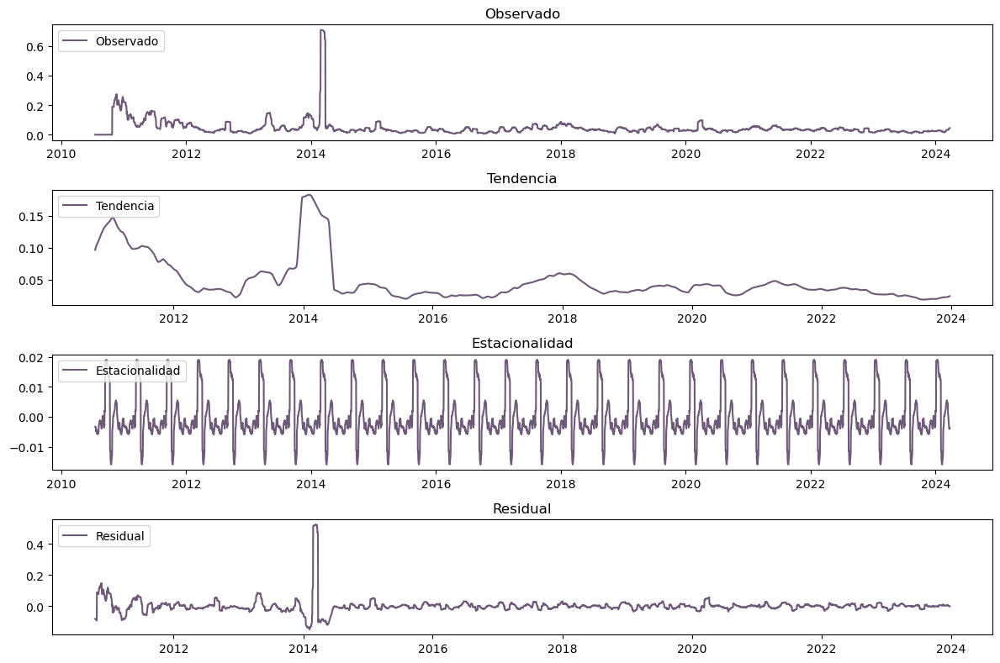

In [667]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

periodo = 180 

# Realizar la descomposición estacional
decomposition = seasonal_decompose(df_1_st['Volatilidad_28'], model='aditive', period=periodo)

# Graficar los componentes
plt.figure(figsize=(12, 8))
plt.subplot(411)
plt.plot(df_1_st['Volatilidad_28'], label='Observado', color='#30143F', alpha=0.7)
plt.title('Observado')
plt.legend(loc='upper left')
plt.subplot(412)
plt.plot(decomposition.trend, label='Tendencia', color='#30143F', alpha=0.7)
plt.title('Tendencia')
plt.legend(loc='upper left')
plt.subplot(413)
plt.plot(decomposition.seasonal, label='Estacionalidad', color='#30143F', alpha=0.7)
plt.title('Estacionalidad')
plt.legend(loc='upper left')
plt.subplot(414)
plt.plot(decomposition.resid, label='Residual', color='#30143F', alpha=0.7)
plt.title('Residual')
plt.legend(loc='upper left')
plt.tight_layout()
plt.show()

El análisis de la volatilidad a 21 días muestra que, aunque la volatilidad general se ha mantenido baja en la mayor parte del tiempo, existen algunos picos notables, especialmente entre 2013 y 2014. La tendencia indica una disminución gradual en la volatilidad a largo plazo, mientras que la componente estacional sugiere un patrón repetitivo en el tiempo. Sin embargo, los residuales evidencian algunos eventos de volatilidad no explicados completamente por la estacionalidad o la tendencia, lo que destaca la naturaleza impredecible de ciertos periodos en la serie.

#### <font color="#30143"> Estacionaridad </font>

<div class="alert alert-block" style="background-color: #e1d9e3; color: #30143; padding: 10px; border-radius: 10px;">
    <i class="fa fa-info-circle" aria-hidden="true"></i>
    <strong>Importante:</strong>
    Una serie de tiempo se considera <strong><em>No estacionaria</em></strong> si la distribución de sus datos (media, varianza, autocorrelación, etc.) <em>no permanece constante a lo largo del tiempo</em>, es decir, si  muestra <em>tendencia, variación en la varianza, autocorrelación significativa</em>. 
</div>

* **Prueba de Dickey-Fuller**

Otra forma de validar si la serie es `estacionaria`o `NO estacionaria`, es aplicar la prueba de `Dickey-Fuller`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{La serie de tiempo es no estacionaria.}$$
$$ H_1 : \text{La serie de tiempo es estacionaria.}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que la serie de tiempo es estacionaria.

In [673]:
result_dickeyfullerat = adfuller(df_1_st.Volatilidad_28)
dickeyfuller_at = result_dickeyfullerat[1]

print('ADF Statistic: %f' % result_dickeyfullerat[0])
print('p-value: %f' % result_dickeyfullerat[1])

# Evaluar resultados del test
if dickeyfuller_at > 0.05:
    print('No se rechaza H0: La serie de tiempo es no estacionaria')
else:
    print('Se rechaza H0: La serie de tiempo es estacionaria')

ADF Statistic: -6.488362
p-value: 0.000000
Se rechaza H0: La serie de tiempo es estacionaria


* **Prueba de Ljung-Box**

De igual forma, podemos de validar si los residuales son independiente o no al aplicar la prueba de `Ljung-Box`.

* Planteamiento de Hipótesis: 

$$ H_0 : \text{Los residuales son independientes (No correlacionados)}$$
$$ H_1 : \text{Los residuales no son independientes (Hay autocorrelación en los residuales)}$$

* Críterios de aceptación y/o rechazo: 

Sí el  P-value $< 0.05 $, se rechaza la hipótesis nula con un a significancia $ \alpha = 0.05$, es decir que hay suficiente evidencia estadística para afirmar que la serie es estacionaria y los residuales son independientes.

In [676]:
ljungbox_resultat = acorr_ljungbox(residuals_vol28, lags=[10], return_df=True)
print('LB Statistic: %f' % ljungbox_result['lb_stat'].iloc[0])
print('p-value: %f' % ljungbox_result['lb_pvalue'].iloc[0])


# Pruebas de independencia y normalidad
ljungbox_resultat = acorr_ljungbox(residuals_vol7, lags=[10], return_df=True)
jung_box_pvalat = ljungbox_resultat['lb_pvalue'].iloc[0]

# Evaluar resultados del test
if jung_box_pvalat > 0.05:
    print('No se rechaza H0: los residuales son independientes (no correlacionados)')
else:
    print('Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)')

LB Statistic: 48206.158615
p-value: 0.000000
Se rechaza H0: los residuales no son independientes (hay autocorrelación en los residuales)


---